<a href="https://colab.research.google.com/github/shreyasr-upenn/NeRF/blob/main/NeRF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Implementation of NeRF: Neural Radiance Fields
### Implementation by Shreyas Ramesh
##### Derived from CIS 580 Spring 2023, University of Pennsylvania

Instructions: Create a folder in your Google Drive and place inside this .ipynb file. Open the jupyter notebook with Google Colab. Refrain from using a GPU during implementing and testing the whole thing. You should switch to a GPU runtime only when performing the final training (of the 2D image or the NeRF) to avoid GPU usage runouts.

### Part 1: Fitting a 2D Image

In [26]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


We first download the image from the web. We normalize the image so the pixels are in between the range of [0,1].

In [27]:
url = "https://drive.google.com/file/d/1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT/view?usp=share_link"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT
To: /content/starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<00:00, 16.8MB/s]


#### Positional Encoding

Positional Encoding is used to map continuous input coordinates into a higher dimensional space to enable a neural network to approximate a higher frequency function. Despite the fact that neural networks are universal function approximators, it has been shown that having a network directly operate on input coordinates $(x, y)$ results in renderings that perform poorly at representing high-frequency variation in color and texture. Mapping the inputs to a higher dimensional space using high-frequency functions. Removing
the positional encoding drastically decreases the model's ability to represent high frequency geometry and texture, resulting in an oversmoothed appearance.

We have set the number of frequencies as $L = 10$ for $\gamma \ (x)$ and $L = 4$ for $\gamma \ (d)$ as per the original paper.

In [28]:
def positional_encoding(x, num_frequencies=6, incl_input=True):

    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """
    pi = torch.pi

    results = []
    if incl_input:
        results.append(x)
    #############################  TODO 1(a) BEGIN  ############################
    # encode input tensor and append the encoded tensor to the list of results.
    for i in range(num_frequencies):
      results.append(torch.sin((2**i)*pi*x))
      results.append(torch.cos((2**i)*pi*x))



    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

In [29]:
torch.pi

3.141592653589793

#### MLP
This is a simple MLP model consisting of three linear layers.

In [30]:
class model_2d(nn.Module):

    """
    Define a 2D model comprising of three fully connected layers,
    two relu activations and one sigmoid activation.
    """

    def __init__(self, filter_size=128, num_frequencies=6):
        super().__init__()
        #############################  TODO 1(b) BEGIN  ############################
        self.fc1 = nn.Linear(in_features=num_frequencies*2*2, out_features=filter_size)
        self.fc2 = nn.Linear(in_features=filter_size, out_features=filter_size)
        self.fc3 = nn.Linear(in_features=filter_size, out_features=3)
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()


        #############################  TODO 1(b) END  ##############################

    def forward(self, x):
        #############################  TODO 1(b) BEGIN  ############################
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.sigmoid(self.fc3(x))
        x = x.permute(1,0,2)

        #############################  TODO 1(b) END  ##############################
        return x

You need to complete 1.1 and 1.2 first before completing the train_2d_model function. Don't forget to transfer the completed functions from 1.1 and 1.2 to the part1.py file and upload it to the autograder.

Fill the gaps in the train_2d_model() function to train the model to fit the 2D image.

In [31]:
def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):

    # Optimizer parameters
    lr = 5e-4
    iterations = 10000
    height, width = test_img.shape[:2]

    # Number of iters after which stats are displayed
    display = 2000

    # Define the model and initialize its weights.
    model2d = model(num_frequencies=num_frequencies)
    model2d.to(device)

    def weights_init(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform_(m.weight)

    model2d.apply(weights_init)

    #############################  TODO 1(c) BEGIN  ############################
    # Define the optimizer
    optimizer = torch.optim.Adam(model2d.parameters(), lr = 0.01)
    criterion = nn.MSELoss()

    criterion = criterion.to(device)
    #############################  TODO 1(c) END  ############################

    # Seed RNG, for repeatability
    seed = 5670
    torch.manual_seed(seed)
    np.random.seed(seed)

    # Lists to log metrics etc.
    psnrs = []
    iternums = []

    t = time.time()
    t0 = time.time()

    #############################  TODO 1(c) BEGIN  ############################
    # Create the 2D normalized coordinates, and apply positional encoding to them
    x_coords = torch.linspace(0, 1, width, device=test_img.device)
    y_coords = torch.linspace(0, 1, height, device=test_img.device)
    xx, yy = torch.meshgrid(x_coords, y_coords)
    coords = torch.stack([xx, yy], dim=-1).to(device)

    encoded_coords = positional_encoding(coords,num_frequencies, incl_input=False)
    print(f"Test Img = {test_img.shape} Coords = {coords.shape}, Encoded Coords = {encoded_coords.shape}")



    #############################  TODO 1(c) END  ############################

    for i in range(iterations+1):
        optimizer.zero_grad()
        #############################  TODO 1(c) BEGIN  ############################
        # Run one iteration
        pred = model2d(encoded_coords)
        # print(f"Pred = {pred.shape}")
        # Compute mean-squared error between the predicted and target images. Backprop!
        loss = criterion(pred, test_img)
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        #############################  TODO 1(c) END  ############################

        # Display images/plots/stats
        if i % display == 0 and show:
            #############################  TODO 1(c) BEGIN  ############################
            # Calculate psnr
            psnr = 10 * torch.log10(torch.max(pred) / loss.item())
            #############################  TODO 1(c) END  ############################

            print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
                "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
            t = time.time()

            psnrs.append(psnr.item())
            iternums.append(i)

            plt.figure(figsize=(13, 4))
            plt.subplot(131)
            plt.imshow(pred.detach().cpu().numpy())
            plt.title(f"Iteration {i}")
            plt.subplot(132)
            plt.imshow(test_img.cpu().numpy())
            plt.title("Target image")
            plt.subplot(133)
            plt.plot(iternums, psnrs)
            plt.title("PSNR")
            plt.show()

    print('Done!')
    return pred.detach().cpu()

Train the model to fit the given image without applying positional encoding to the input, and by applying positional encoding of two different frequencies to the input; L = 2 and L = 6.

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Test Img = torch.Size([105, 133, 3]) Coords = torch.Size([133, 105, 2]), Encoded Coords = torch.Size([133, 105, 24])
Iteration 0  Loss: 0.0510  PSNR: 11.14 Time: 0.00 secs per iter 0.05 secs in total


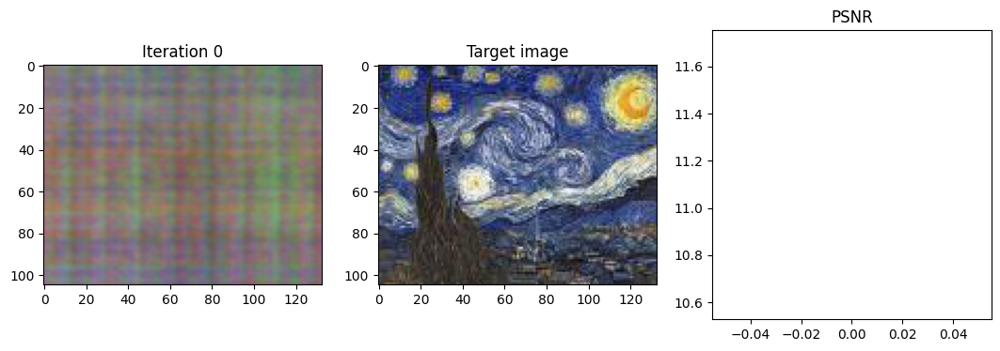

Iteration 2000  Loss: 0.0021  PSNR: 26.60 Time: 0.00 secs per iter 4.13 secs in total


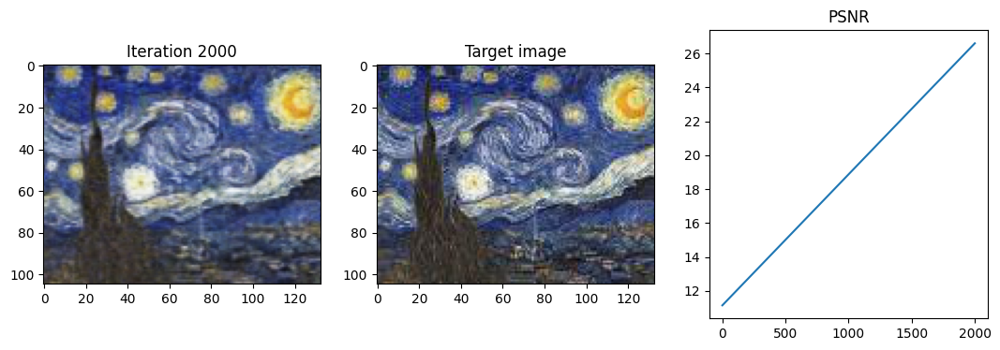

Iteration 4000  Loss: 0.0017  PSNR: 27.55 Time: 0.00 secs per iter 7.70 secs in total


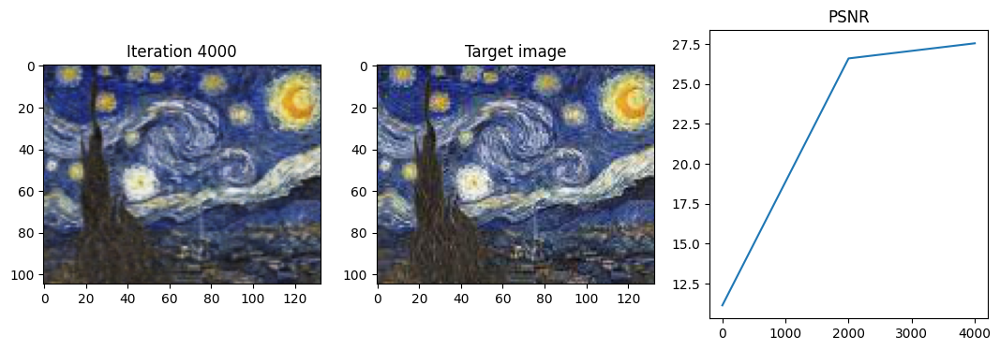

Iteration 6000  Loss: 0.0012  PSNR: 29.17 Time: 0.00 secs per iter 11.33 secs in total


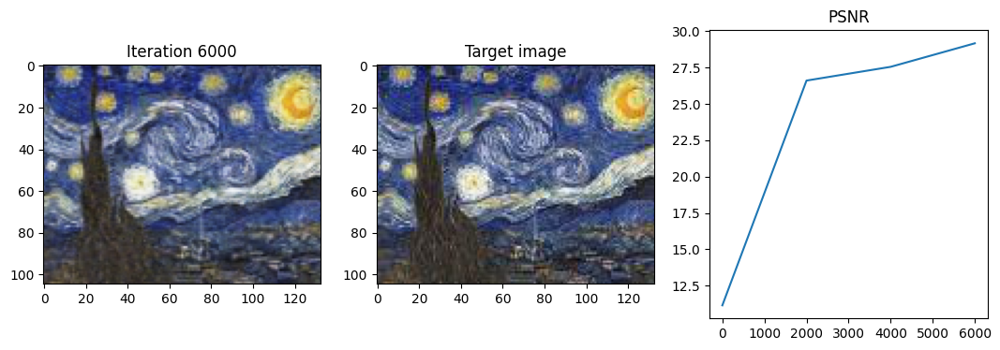

Iteration 8000  Loss: 0.0013  PSNR: 28.82 Time: 0.00 secs per iter 15.35 secs in total


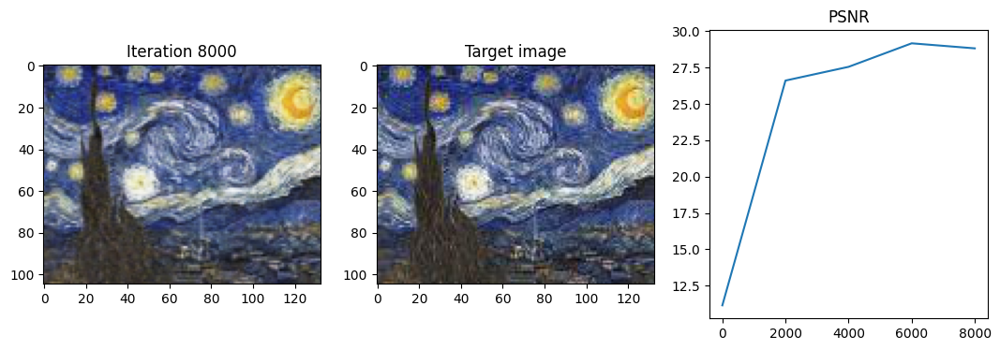

Iteration 10000  Loss: 0.0009  PSNR: 30.30 Time: 0.00 secs per iter 18.99 secs in total


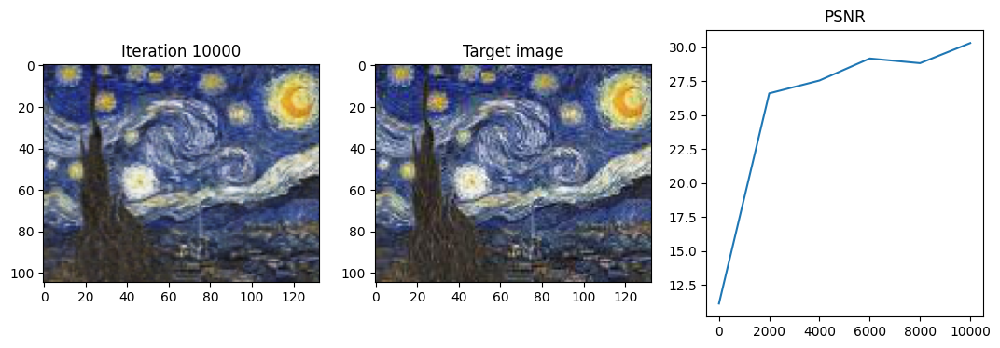

Done!


In [32]:
_ = train_2d_model(test_img=painting, num_frequencies=6, device=device)

Test Img = torch.Size([105, 133, 3]) Coords = torch.Size([133, 105, 2]), Encoded Coords = torch.Size([133, 105, 8])
Iteration 0  Loss: 0.0607  PSNR: 10.10 Time: 0.00 secs per iter 0.00 secs in total


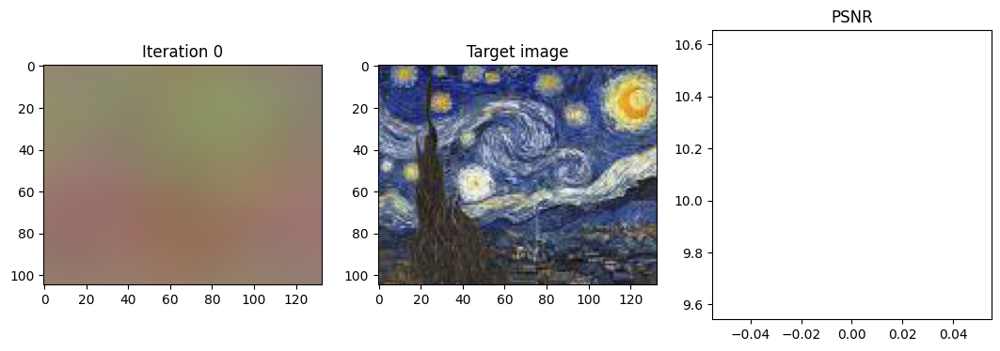

Iteration 2000  Loss: 0.0078  PSNR: 20.84 Time: 0.00 secs per iter 3.41 secs in total


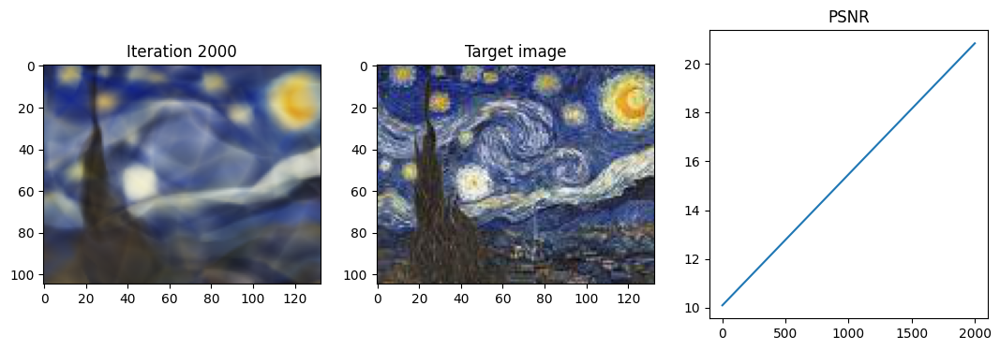

Iteration 4000  Loss: 0.0081  PSNR: 20.62 Time: 0.00 secs per iter 6.99 secs in total


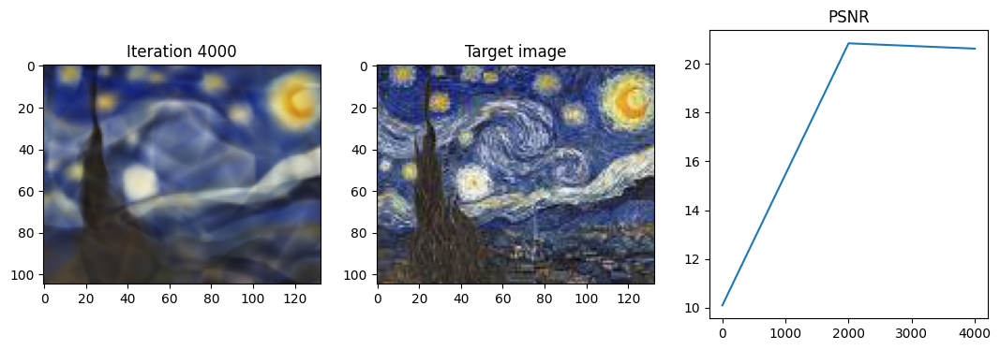

Iteration 6000  Loss: 0.0071  PSNR: 21.27 Time: 0.00 secs per iter 12.49 secs in total


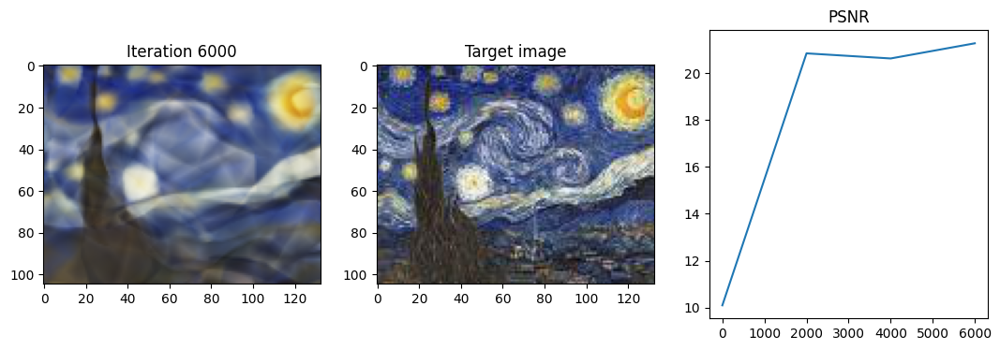

Iteration 8000  Loss: 0.0066  PSNR: 21.51 Time: 0.00 secs per iter 15.88 secs in total


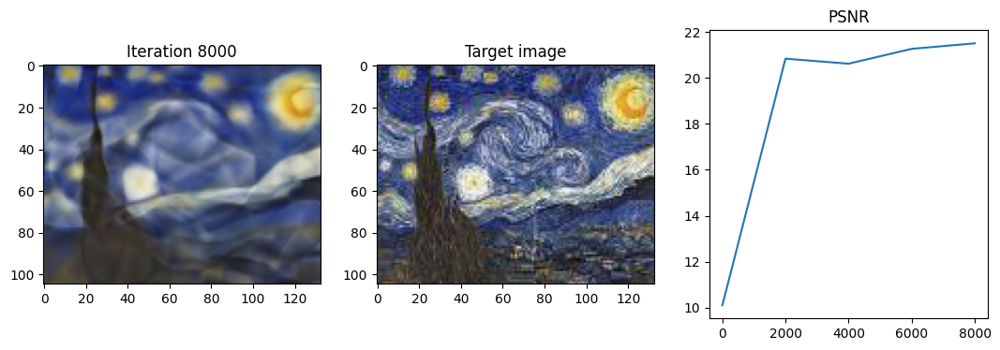

Iteration 10000  Loss: 0.0068  PSNR: 21.32 Time: 0.00 secs per iter 19.25 secs in total


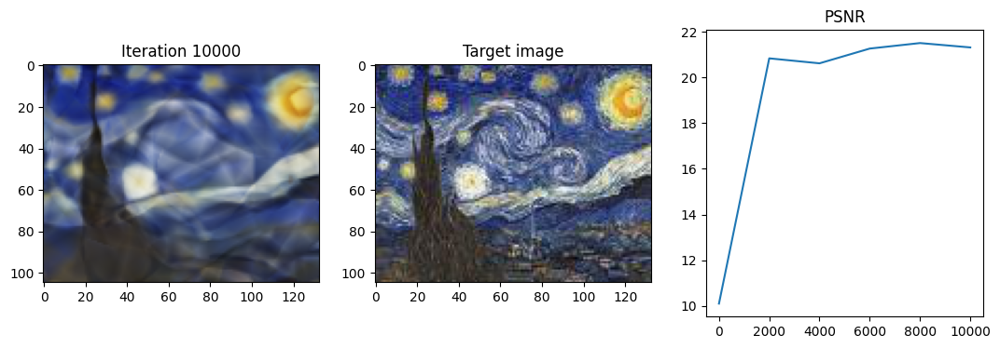

Done!


In [33]:
_ = train_2d_model(test_img=painting, num_frequencies=2, device=device)

Test Img = torch.Size([105, 133, 3]) Coords = torch.Size([133, 105, 2]), Encoded Coords = torch.Size([133, 105, 48])
Iteration 0  Loss: 0.0847  PSNR: 9.98 Time: 0.00 secs per iter 0.01 secs in total


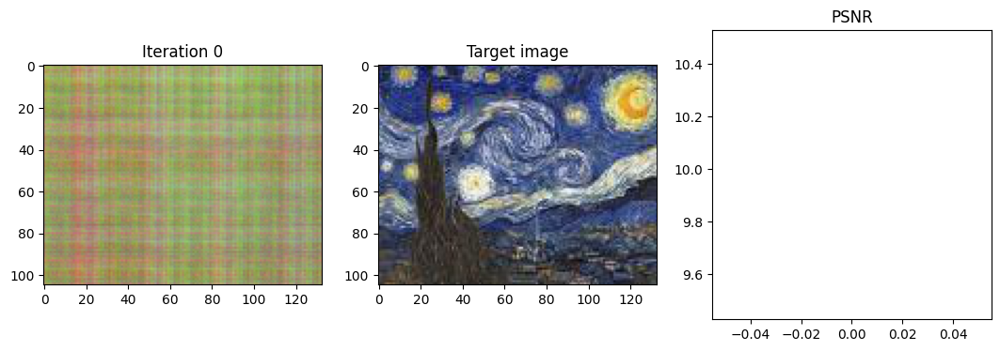

Iteration 2000  Loss: 0.0020  PSNR: 26.87 Time: 0.00 secs per iter 6.06 secs in total


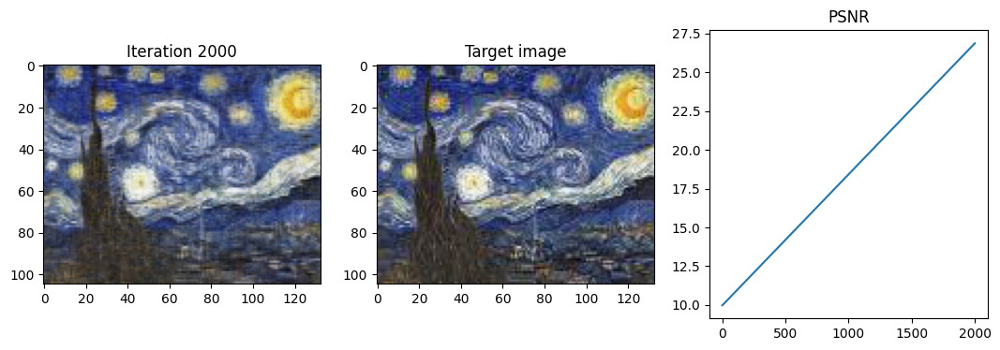

Iteration 4000  Loss: 0.0015  PSNR: 28.19 Time: 0.00 secs per iter 9.56 secs in total


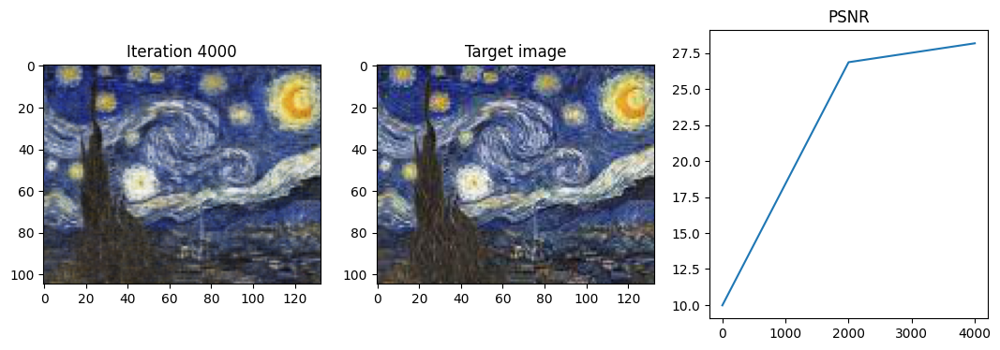

Iteration 6000  Loss: 0.0014  PSNR: 28.30 Time: 0.00 secs per iter 13.00 secs in total


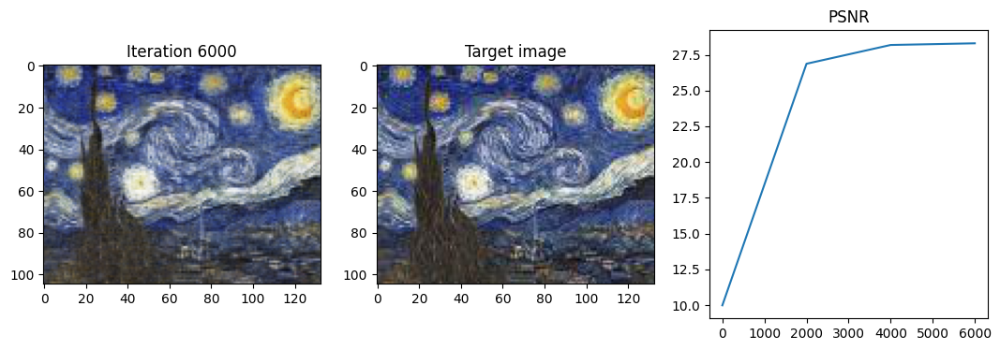

Iteration 8000  Loss: 0.0014  PSNR: 28.47 Time: 0.00 secs per iter 17.09 secs in total


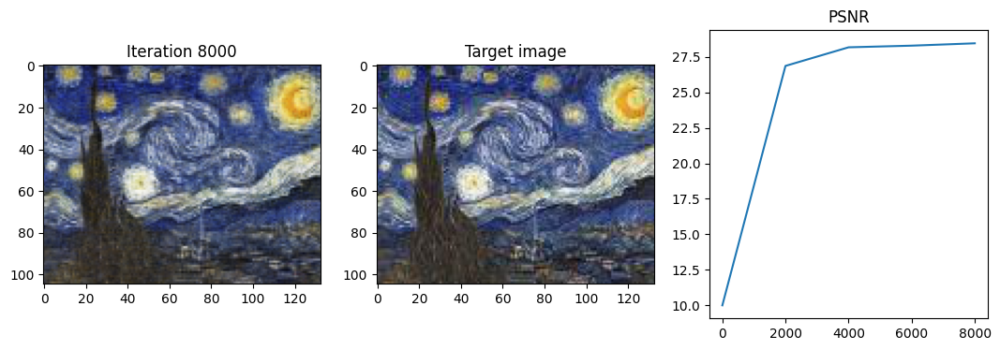

Iteration 10000  Loss: 0.0011  PSNR: 29.44 Time: 0.00 secs per iter 20.53 secs in total


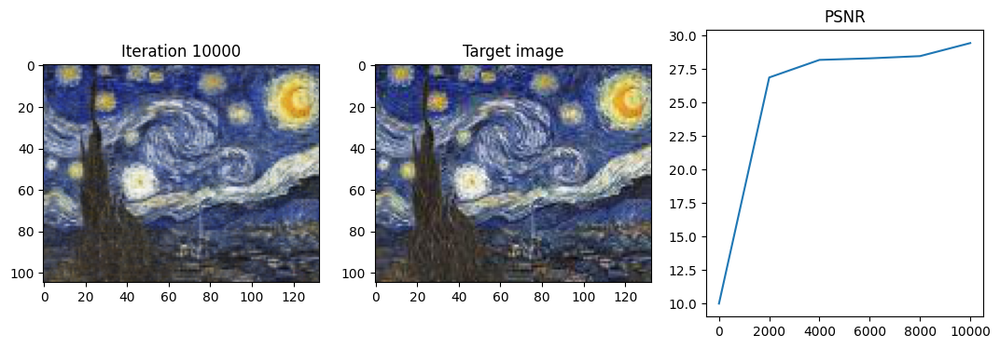

Done!


In [34]:
_ = train_2d_model(test_img=painting, num_frequencies=12, device=device)

### Part 2: Fitting a 3D Image

In [1]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time
import random
import pdb
from tqdm import tqdm
from scipy.spatial.transform import Rotation as R
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
url = "https://drive.google.com/file/d/15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj/view?usp=share_link"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 261MB/s]


'lego_data.npz'

Here, we load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.

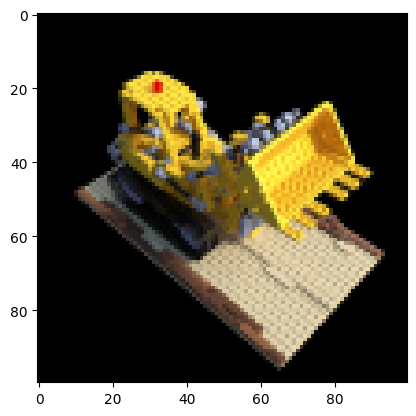

In [4]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

2.1 Complete the following function that calculates the rays that pass through all the pixels of an HxW image

In [5]:
print(f"Poses = {poses.shape}")
print(f"Images = {images.shape}")
print(f"Intrinsics = {intrinsics.shape}")

Poses = torch.Size([106, 4, 4])
Images = torch.Size([100, 100, 100, 3])
Intrinsics = torch.Size([3, 3])


#### Ray Computation
For every 2D image $I$ , we are given the transformation between the camera and the world coordinates, along with the intrinsic parameters of the camera. We then calculate the origins and the directions of each camera frame with respect to the world coordinate frame.

In [21]:
def get_rays(height, width, intrinsics, Rcw, Tcw): # Rwc, Twc

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    Rcw: Rotation matrix of shape (3,3) from camera to world coordinates.
    Tcw: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    # device = torch.device('cpu')
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder

    #############################  TODO 2.1 BEGIN  ##########################
    # ray_origins = torch.ones((height, width, 3), device = device) * Tcw
    # origin = torch.Tensor(Rcw).to(device) @ torch.tensor([0.,0.,0.]).T.to(device) + torch.Tensor(Tcw).to(device)
    origin =  torch.Tensor(Tcw).to(device)
    ray_origins[:,:,0] = origin.flatten()[0]
    ray_origins[:,:,1] = origin.flatten()[1]
    ray_origins[:,:,2] = origin.flatten()[2]

    x_coords = torch.linspace(0, width-1, width, device=device)
    y_coords = torch.linspace(0, height-1, height, device=device)
    v, u = torch.meshgrid(x_coords, y_coords, indexing='ij')

    # Intrinsics is of the form
    # [
    #     [fx     , 0     ,     u0],
    #     [0      , fy    ,     v0],
    #     [0      , 0     ,      1],
    # ]
    fx = intrinsics[0,0].to(device)
    fy = intrinsics[1,1].to(device)
    u0 = intrinsics[0,2].to(device)
    v0 = intrinsics[1,2].to(device)
    uv_coords = torch.stack([(u - v0)/fx, (v-u0)/fy, torch.ones_like(u)], dim=-1).to(device)  ## WHYY?

    # uv_coords = torch.cat([uv_coords, torch.ones((uv_coords.shape[0], uv_coords.shape[1],1))], dim = -1)
    # print(f"uv coord = {uv_coords.shape}")
    # calibrated_coordinates = uv_coords @ torch.linalg.inv(intrinsics)
    # print(f"calibrated = {calibrated_coordinates.shape}, Rcw = {Rcw.shape}")
    Rcw = torch.Tensor(Rcw).to(device)
    # ray_directions = calibrated_coordinates @ Rcw
    ray_directions = uv_coords @ Rcw




    #############################  TODO 2.1 END  ############################
    return ray_origins, ray_directions

The Camera Intrinsics are as follows:

In [ ]:
intrinsics

tensor([[138.8889,   0.0000,  50.0000],
        [  0.0000, 138.8889,  50.0000],
        [  0.0000,   0.0000,   1.0000]], device='cuda:0')

In [ ]:
Rcw = poses[101][:3,:3].T
Tcw = poses[101][:3,3]
ray_ori, ray_dir = get_rays(height, width, intrinsics, Rcw, Tcw)
print(ray_ori.shape)
print(ray_dir.shape)

Complete the next function to visualize how is the dataset created. You will be able to see from which point of view each image has been captured for the 3D object. What we want to achieve here, is to being able to interpolate between these given views and synthesize new realistic views of the 3D object.

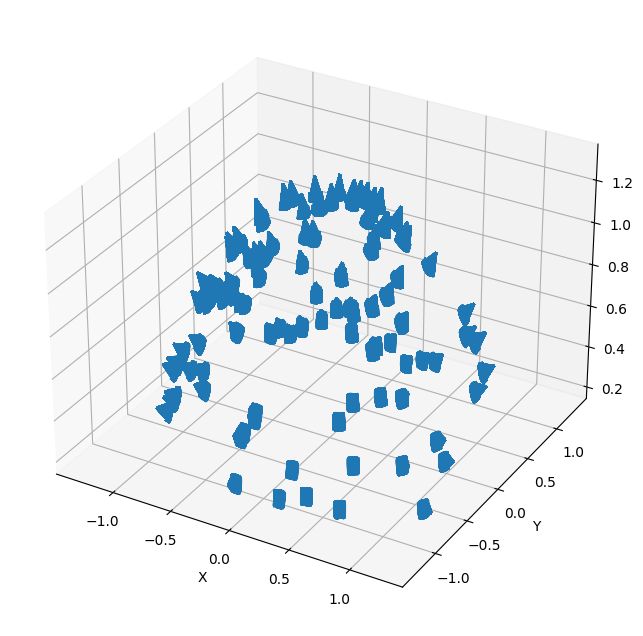

In [22]:
def plot_all_poses(poses):

    #############################  TODO 2.1 BEGIN  ############################

    origins = []
    directions = []
    for i in range(poses.shape[0]):
      Rcw = poses[i][:3,:3].T
      Tcw = poses[i][:3,3]
      orig, dir = get_rays(height, width, intrinsics,Rcw, Tcw)
      origins.append(orig)
      directions.append(dir)
    origins = torch.stack(origins).cpu() #Convert list to Tensor
    directions = torch.stack(directions).cpu()
    # end = poses.shape[0]
    # Rcw = poses[:end][:3,:3].T
    # Tcw = poses[:end][:3,3]

    # origins, directions = get_rays(height,width, intrinsics, Rcw, Tcw)
    ############################  TODO 2.1 END  ############################

    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.1, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'])

#### Stratified Sampling
The radiance field represents a scene as the colume density and directional emitted radiance at any point in space. The estimation for the accumulated transmittance along a ray with near and far bounds ($t_n$ and $t_f$ respectively) is done using quadrature. Deterministic quadrature, which is typically used for rendering discretized voxel grids, would effectively limit our representation’s resolution because the MLP would only be queried at a fixed discrete set of locations. Instead, we use a stratified sampling approach where we partition ($t_n$ and $t_f$ ) into $N$ evenly-spaced bins and
then draw one sample uniformly at random from within each bin.

In [7]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    #############################  TODO 2.2 BEGIN  ############################
    device = torch.device('cpu')
    sample_rays = torch.linspace(near, far, samples, device=device)
    depth_points = torch.ones((ray_origins.shape[0], ray_origins.shape[1],samples), device = device) * sample_rays
    # print(f"Depth Points = {depth_points.shape} , Sample Rays = {sample_rays.shape} , Ray Origin = {ray_origins.shape} , Ray Directions = {ray_directions.shape}")
    ray_points = ray_origins.unsqueeze(-2) + ray_directions.unsqueeze(-2) * depth_points.unsqueeze(-1)



    #############################  TODO 2.2 END  ############################
    return ray_points, depth_points

#### NeRF Model
The input of the neural network is the position $(x, y, z)$ of the sample points along the ray, and the direction of these points $(θ, \phi)$, after applying positional encoding to both of them.




<img src='https://drive.google.com/uc?id=1rvfIoYcr7SckQC8IvFFsF3PoJDIAmPU4'>


In [8]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

        #############################  TODO 2.3 BEGIN  ############################
        self.fc1 = nn.Linear(in_features=2*3*num_x_frequencies + 3, out_features=filter_size)
        self.fc2 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc3 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc4 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc5 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc6 = nn.Linear(in_features= filter_size + 2*3*num_x_frequencies + 3, out_features=filter_size) # y(x) - 60
        self.fc7 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc8 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc9 = nn.Linear(in_features= filter_size, out_features=1) #Sigma output
        self.fc10 = nn.Linear(in_features= filter_size, out_features=filter_size)
        self.fc11 = nn.Linear(in_features= filter_size + 2 * 3 * num_d_frequencies + 3, out_features=128) # y(d) - 24
        self.fc12 = nn.Linear(in_features= 128, out_features=3)

        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()

        #############################  TODO 2.3 END  ############################


    def forward(self, x, d):
        #############################  TODO 2.3 BEGIN  ############################
        x1 = self.relu(self.fc1(x))
        x1 = self.relu(self.fc2(x1))
        x1 = self.relu(self.fc3(x1))
        x1 = self.relu(self.fc4(x1))
        x1 = self.relu(self.fc5(x1))

        x2 = torch.cat([x1, x], dim=-1)
        x2 = self.relu(self.fc6(x2))
        x2 = self.relu(self.fc7(x2))
        x2 = self.relu(self.fc8(x2))
        sigma = self.fc9(x2)
        x2 = self.fc10(x2)

        x3 = torch.cat([x2, d], dim= -1)
        x3 = self.relu(self.fc11(x3))
        rgb = self.sigmoid(self.fc12(x3))

        #############################  TODO 2.3 END  ############################
        return rgb, sigma

#### Positional Encoding

Positional Encoding is used to map continuous input coordinates into a higher dimensional space to enable a neural network to approximate a higher frequency function. Despite the fact that neural networks are universal function approximators, it has been shown that having a network directly operate on input coordinates $(x, y)$ results in renderings that perform poorly at representing high-frequency variation in color and texture. Mapping the inputs to a higher dimensional space using high-frequency functions. Removing
the positional encoding drastically decreases the model's ability to represent high frequency geometry and texture, resulting in an oversmoothed appearance.

We have set the number of frequencies as $L = 10$ for $\gamma \ (x)$ and $L = 4$ for $\gamma \ (d)$ as per the original paper.

In [9]:
def positional_encoding(x, num_frequencies=6, incl_input=True):

    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """
    pi = torch.pi

    results = []
    if incl_input:
        results.append(x)
    #############################  TODO 1(a) BEGIN  ############################
    # encode input tensor and append the encoded tensor to the list of results.
    for i in range(num_frequencies):
      results.append(torch.sin((2**i)*pi*x))
      results.append(torch.cos((2**i)*pi*x))



    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

In [10]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):
    """
    Inputs:
      ray_points:  (height, width, samples, 3)
      ray_directions:  (height, width, 3)
    """
    def get_chunks(inputs, chunksize = 2**15):
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before
    dividing them into chunks, as well as normalizing and populating the directions.
    """
    #############################  TODO 2.3 BEGIN  ############################
    # pdb.set_trace()
    ray_directions_normal = ray_directions / torch.linalg.norm(ray_directions, dim= 2, keepdims=True) # (height, width, 3) - Normalization

    ray_directions_populated = torch.zeros_like(ray_points).to(device)

    ray_directions_expanded = torch.unsqueeze(ray_directions_normal, dim=2)
    ray_directions_populated = torch.tile(ray_directions_expanded, (1,1,ray_points.shape[2],1)) #Populating them to (height, width, samples, 3)

    ray_directions_flattened = ray_directions_populated.reshape(-1,3) #Flattening

    ray_directions_encoded = positional_encoding(ray_directions_flattened, num_d_frequencies) # Positional Encoding applied

    ray_points_encoded = positional_encoding(ray_points.reshape(-1,3), num_x_frequencies)

    ray_points_batches = get_chunks(ray_points_encoded)
    ray_directions_batches = get_chunks(ray_directions_encoded)

    # print(f"Batches - Ray Points = {len(ray_points_batches)} & {ray_points_batches[0].shape}, Directions = {len(ray_directions_batches)} & {ray_directions_batches[0].shape}")

    #############################  TODO 2.3 END  ############################

    return ray_points_batches, ray_directions_batches

#### Volume Rendering - Computing the colour of a pixel

The quintessence of the NeRF paper is the volumetric rendering formula. According to the volumetric rendering equation, if we are given the density and color of an adequate number of samples along a ray, we can approximate the color of that ray and thus the pixel color perceived by the camera with
the direction of that ray.

In [11]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """
    device = torch.device("cpu")

    print(f"Volumetric = {device}")
    #############################  TODO 2.4 BEGIN  ############################
    # pdb.set_trace()
    # print(f"S = {s.shape}, RGB = {rgb.shape}, Depth = {depth_points.shape}")
    height, width, samples = depth_points.shape
    rgb = rgb.to(device)
    s = s.to(device)
    depth_points = depth_points.to(device)
    deltas = depth_points[:,:,1:] - depth_points[:,:,:-1]
    deltas = torch.cat([deltas, torch.ones_like(depth_points[:,:,:1])*1e10],-1)
    # print(f"Deltas = {deltas.shape}")
    relu = nn.ReLU()
    sigmas = relu(s)
    # print(f"sigmas = {sigmas.shape}")
    alpha = 1 - torch.exp(-sigmas * deltas)
    # print(f"alpha = {alpha.shape}")

    Ti = torch.cumprod(torch.exp(-(sigmas * deltas)[:,:,:-1]), dim = 2)
    Ti = torch.cat([torch.ones((height, width, 1)).to(device), Ti], dim= -1)
    # print(f"Ti = {Ti.shape}")
    rec_image = torch.sum(((Ti.unsqueeze(-1) * alpha.unsqueeze(-1)) * rgb), dim = 2)
    # print(f"rec image = {rec_image.shape}")
    # rec_image = 0

    #############################  TODO 2.4 END  ############################

    return rec_image

2.5 Combine everything together. Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.

In [12]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):

    #############################  TODO 2.5 BEGIN  ############################

    #compute all the rays from the image
    ray_origins, ray_directions = get_rays(height,width, intrinsics, pose[:3, :3].T , pose[:3, -1])

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)
    # pdb.set_trace()
    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    #forward pass the batches and concatenate the outputs at the end
    rgb_list = []
    s_list = []
    for i in range(len(ray_points_batches)):
      rgb_i, s_i = model(ray_points_batches[i].to(device), ray_directions_batches[i].to(device))
      # print(f"RGB ={rgb_i.shape}, S = {s_i.shape}")
      rgb_list.append(rgb_i)
      s_list.append(s_i)

    # pdb.set_trace()
    rgb = torch.cat(rgb_list, dim = 0).reshape(height, width, samples, 3)
    s = torch.vstack(s_list).reshape(height, width, samples)
    # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(rgb, s, depth_points)

    #############################  TODO 2.5 END  ############################

    return rec_image

If you manage to pass the autograder for all the previous functions, then it is time to train a NeRF! We provide the hyperparameters for you, we initialize the NeRF model and its weights, and we define a couple lists that will be needed to store results.

In [12]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = nn.MSELoss()
psnrs = []
iternums = []

t = time.time()
t0 = time.time()

#### Training

Iteration 0  Loss: 0.1653  PSNR: 7.82  Time: 2.63 secs per iter,  1.10 mins in total


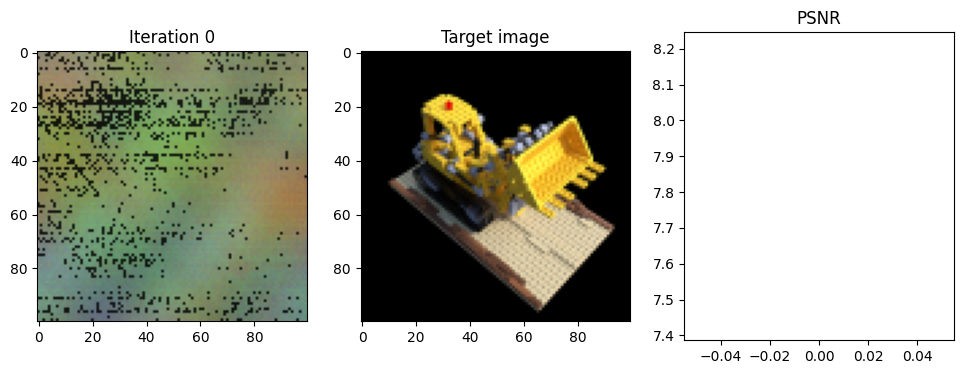

Iteration 25  Loss: 0.0976  PSNR: 10.10  Time: 1.00 secs per iter,  1.51 mins in total


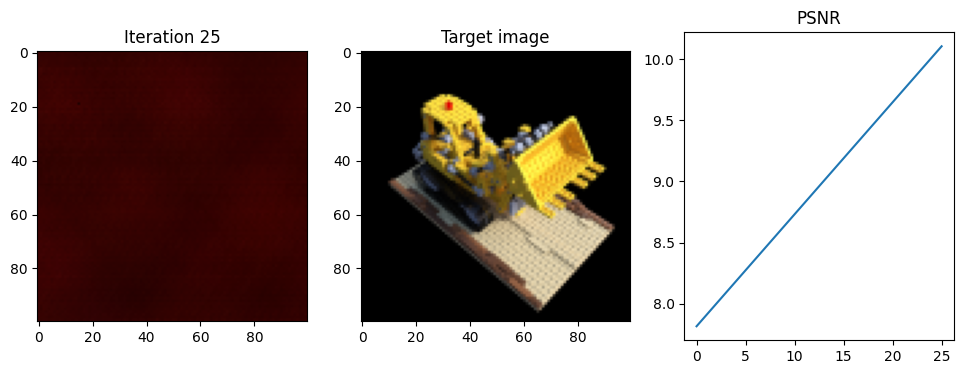

Iteration 50  Loss: 0.0818  PSNR: 10.87  Time: 1.01 secs per iter,  1.93 mins in total


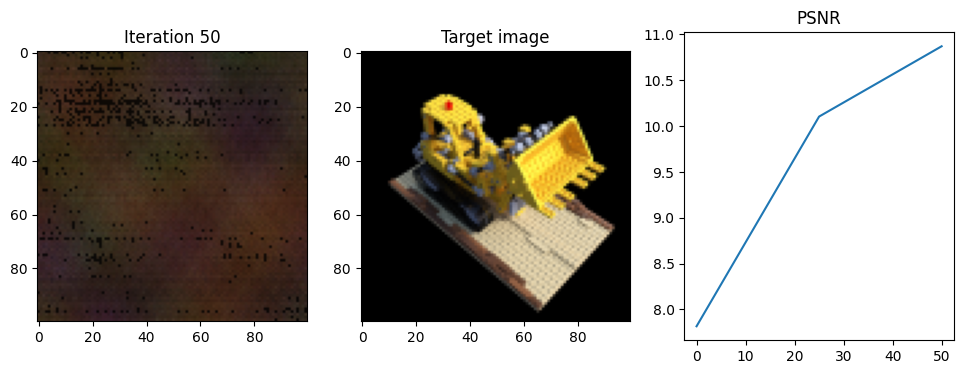

Iteration 75  Loss: 0.0783  PSNR: 11.06  Time: 1.02 secs per iter,  2.36 mins in total


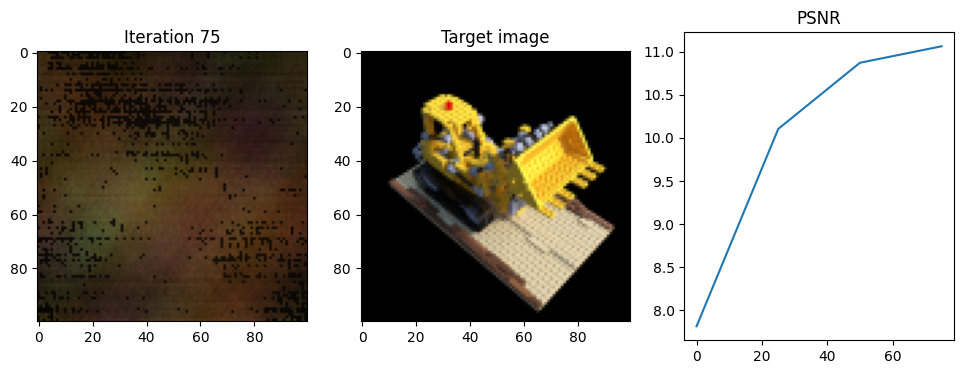

Iteration 100  Loss: 0.0741  PSNR: 11.30  Time: 1.02 secs per iter,  2.79 mins in total


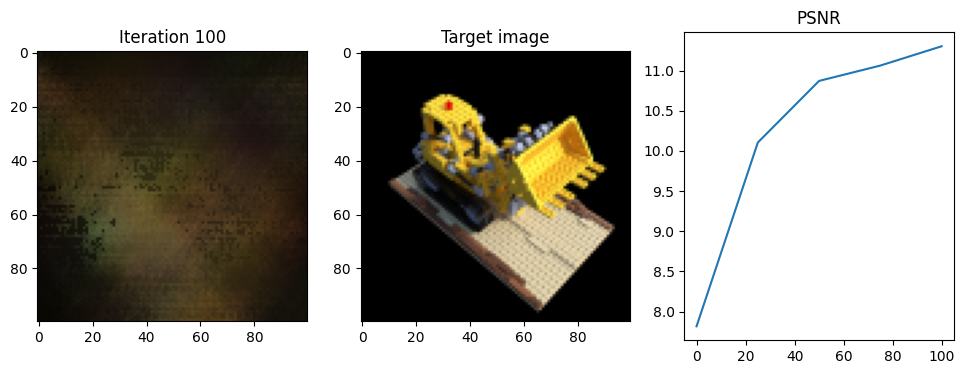

Iteration 125  Loss: 0.0511  PSNR: 12.92  Time: 1.01 secs per iter,  3.21 mins in total


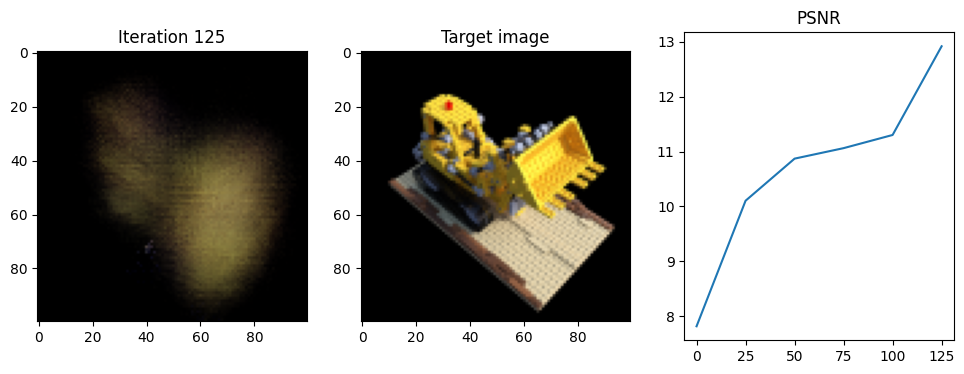

Iteration 150  Loss: 0.0382  PSNR: 14.18  Time: 1.03 secs per iter,  3.64 mins in total


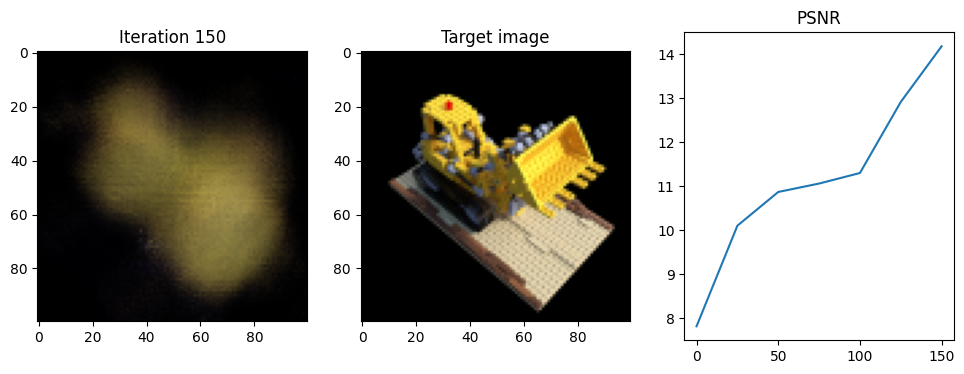

Iteration 175  Loss: 0.0324  PSNR: 14.90  Time: 1.02 secs per iter,  4.06 mins in total


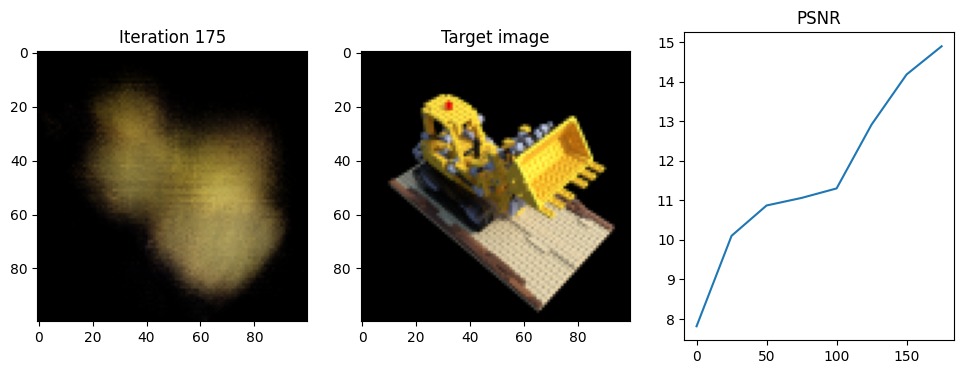

Iteration 200  Loss: 0.0500  PSNR: 13.01  Time: 1.04 secs per iter,  4.49 mins in total


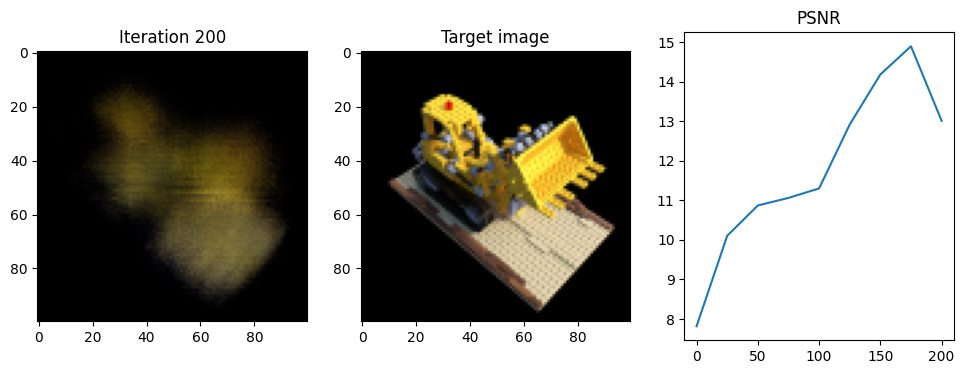

Iteration 225  Loss: 0.0244  PSNR: 16.13  Time: 1.04 secs per iter,  4.93 mins in total


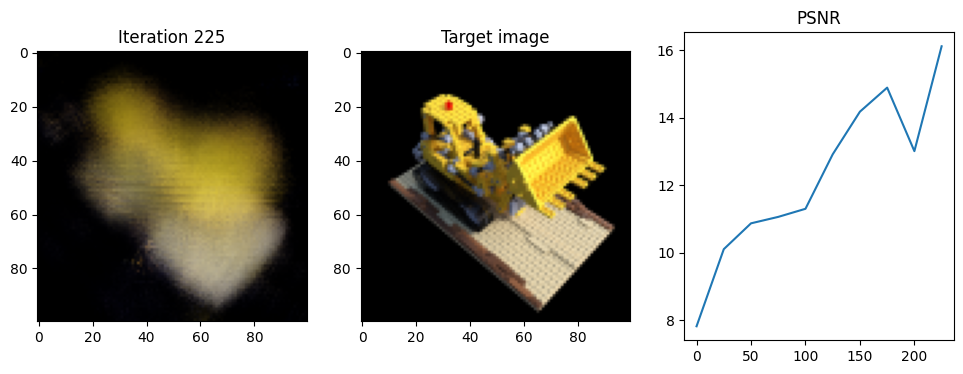

Iteration 250  Loss: 0.0210  PSNR: 16.77  Time: 1.06 secs per iter,  5.37 mins in total


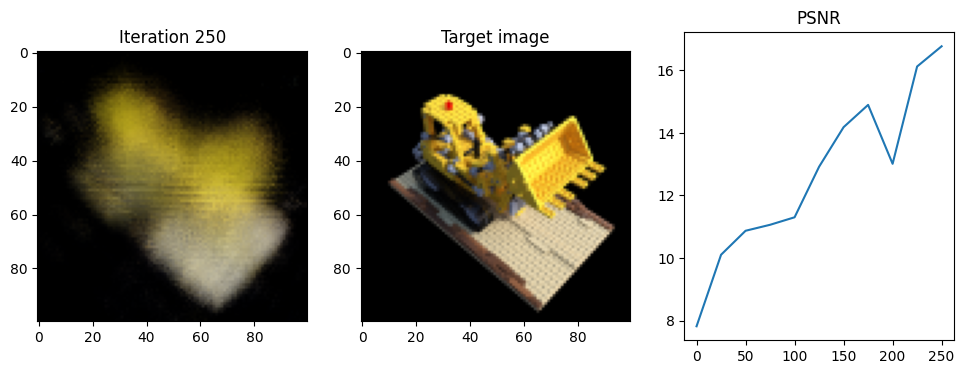

Iteration 275  Loss: 0.0181  PSNR: 17.43  Time: 1.07 secs per iter,  5.81 mins in total


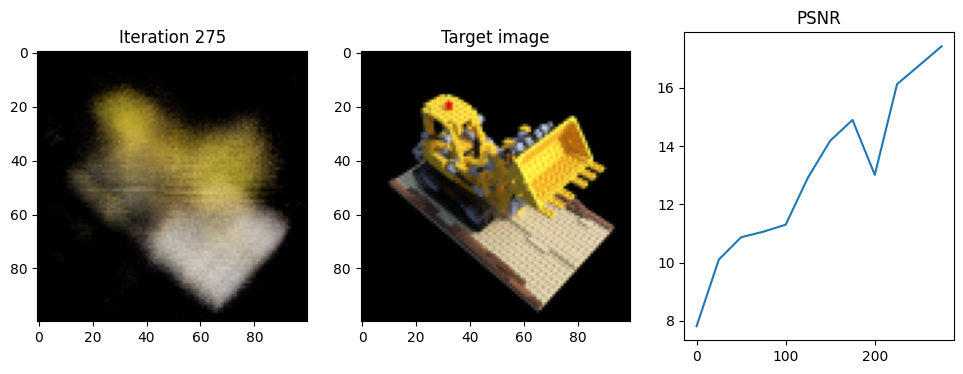

Iteration 300  Loss: 0.0191  PSNR: 17.18  Time: 1.05 secs per iter,  6.25 mins in total


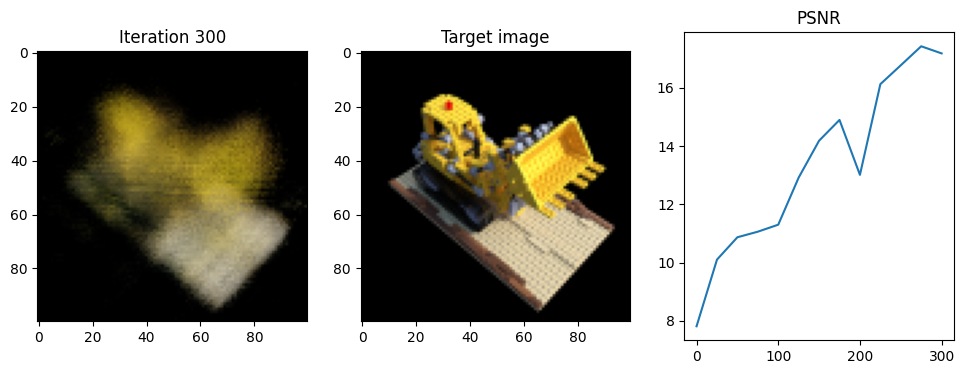

Iteration 325  Loss: 0.0152  PSNR: 18.19  Time: 1.05 secs per iter,  6.69 mins in total


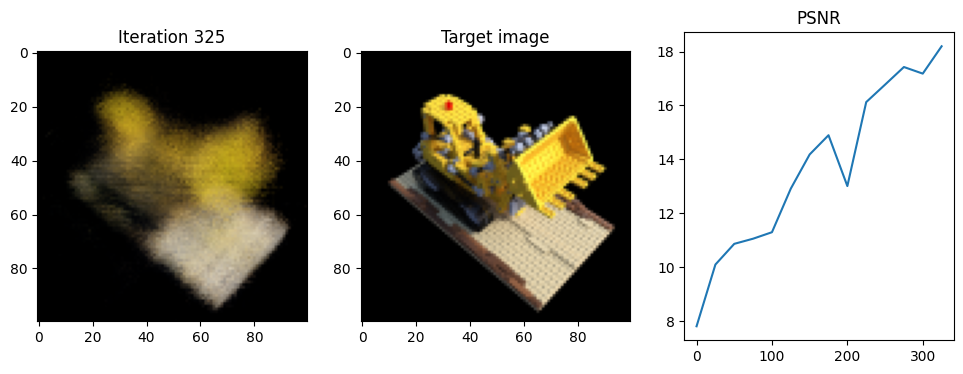

Iteration 350  Loss: 0.0136  PSNR: 18.67  Time: 1.05 secs per iter,  7.13 mins in total


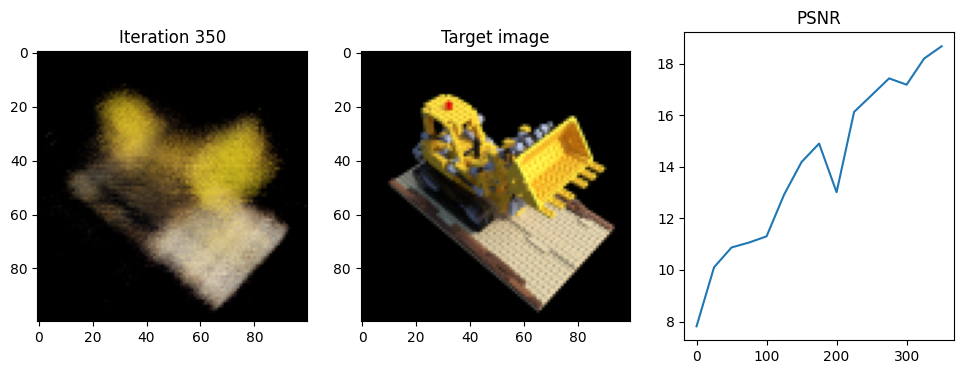

Iteration 375  Loss: 0.0174  PSNR: 17.59  Time: 1.05 secs per iter,  7.56 mins in total


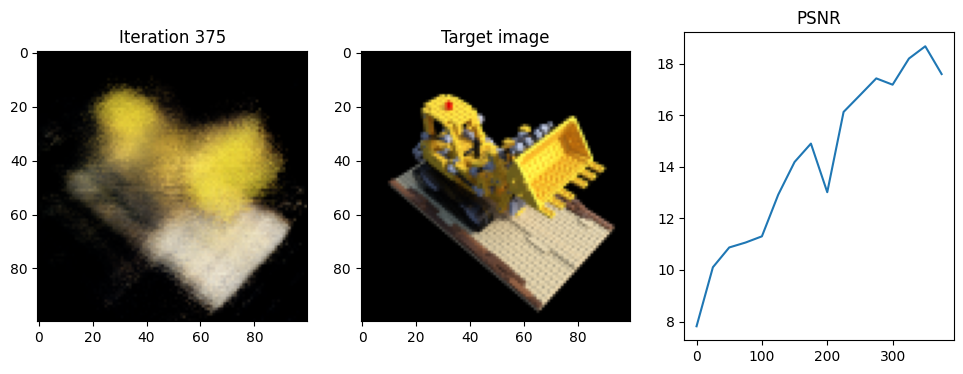

Iteration 400  Loss: 0.0155  PSNR: 18.09  Time: 1.06 secs per iter,  8.00 mins in total


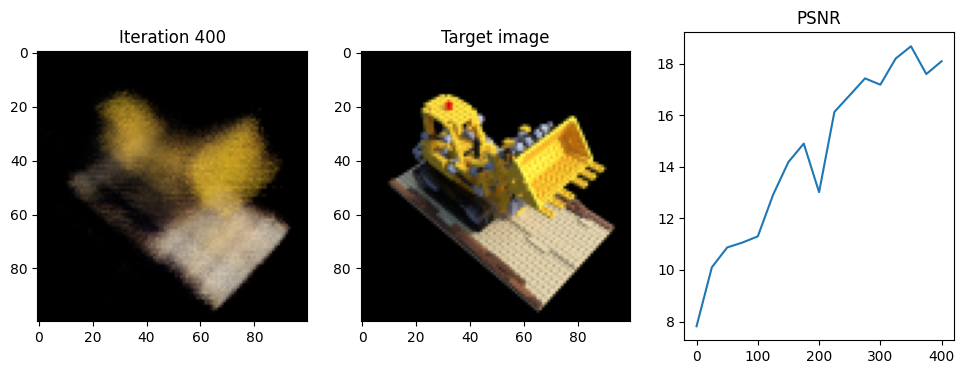

Iteration 425  Loss: 0.0114  PSNR: 19.41  Time: 1.04 secs per iter,  8.44 mins in total


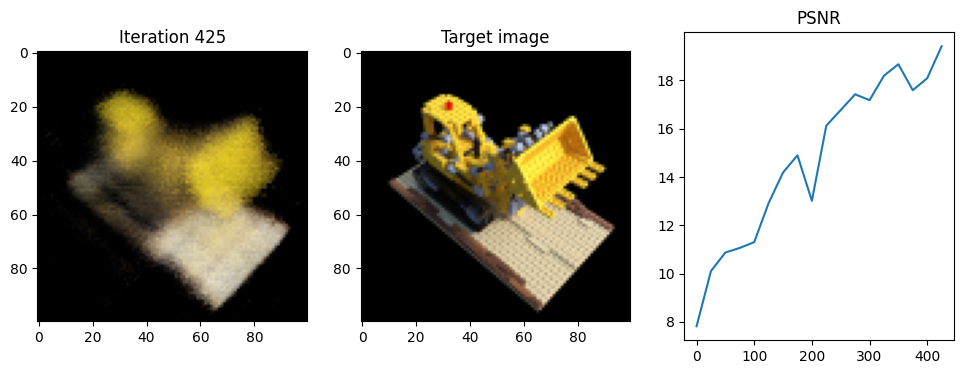

Iteration 450  Loss: 0.0117  PSNR: 19.33  Time: 1.04 secs per iter,  8.87 mins in total


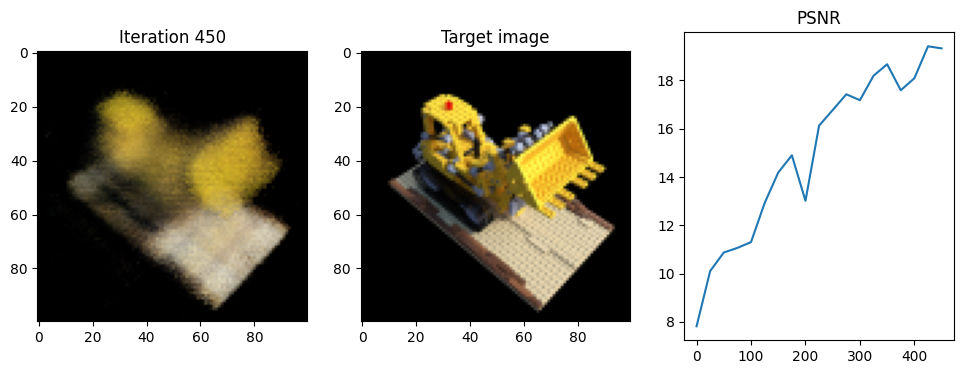

Iteration 475  Loss: 0.0112  PSNR: 19.49  Time: 1.04 secs per iter,  9.30 mins in total


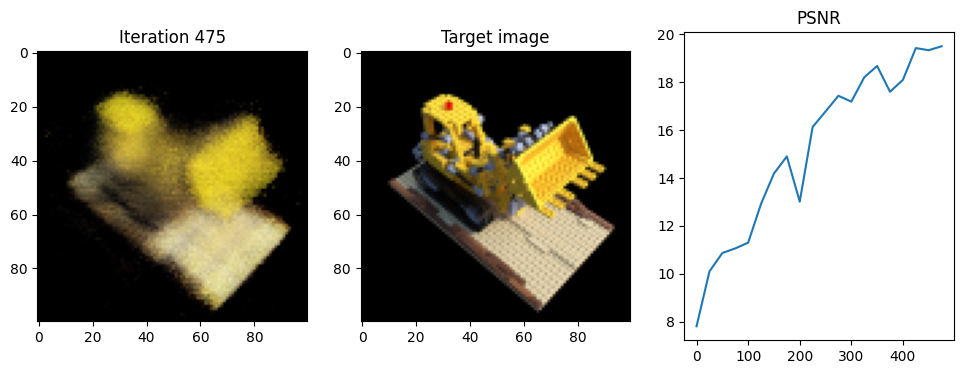

Iteration 500  Loss: 0.0113  PSNR: 19.47  Time: 1.04 secs per iter,  9.73 mins in total


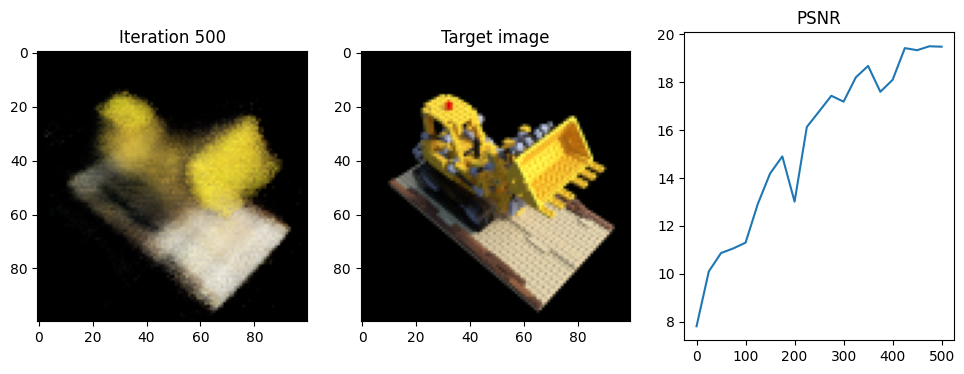

Iteration 525  Loss: 0.0107  PSNR: 19.72  Time: 1.03 secs per iter,  10.16 mins in total


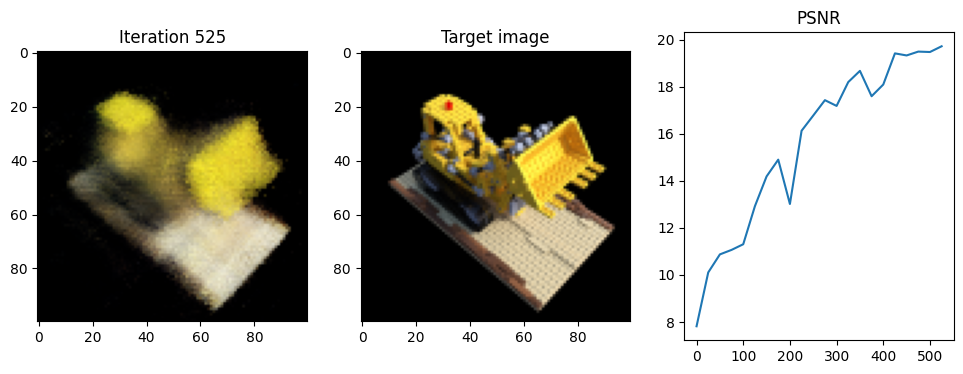

Iteration 550  Loss: 0.0102  PSNR: 19.91  Time: 1.03 secs per iter,  10.60 mins in total


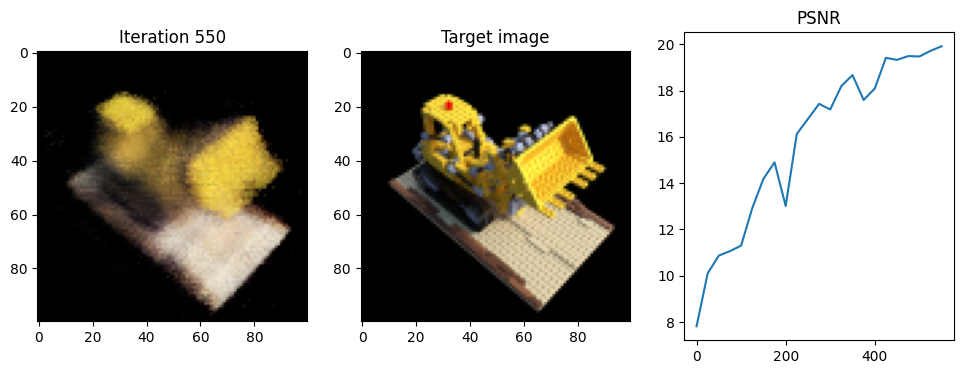

Iteration 575  Loss: 0.0098  PSNR: 20.08  Time: 1.04 secs per iter,  11.03 mins in total


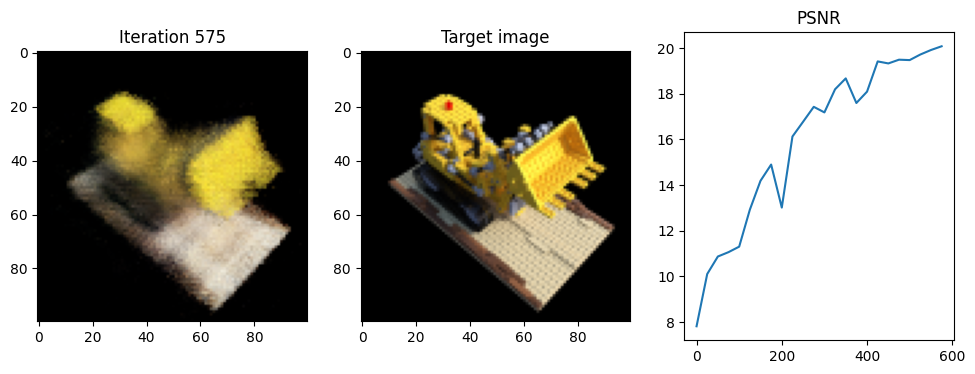

Iteration 600  Loss: 0.0101  PSNR: 19.95  Time: 1.05 secs per iter,  11.47 mins in total


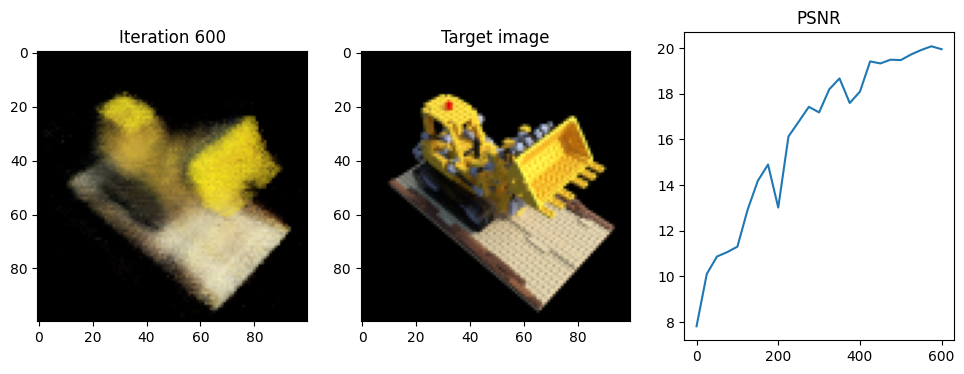

Iteration 625  Loss: 0.0088  PSNR: 20.56  Time: 1.04 secs per iter,  11.90 mins in total


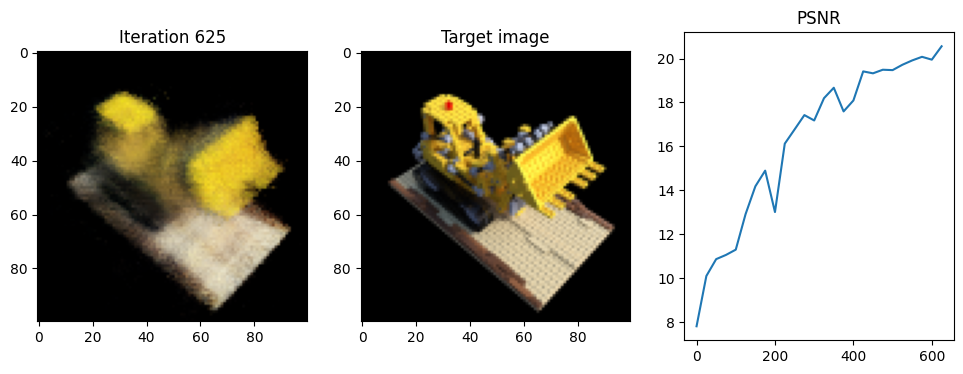

Iteration 650  Loss: 0.0088  PSNR: 20.55  Time: 1.04 secs per iter,  12.33 mins in total


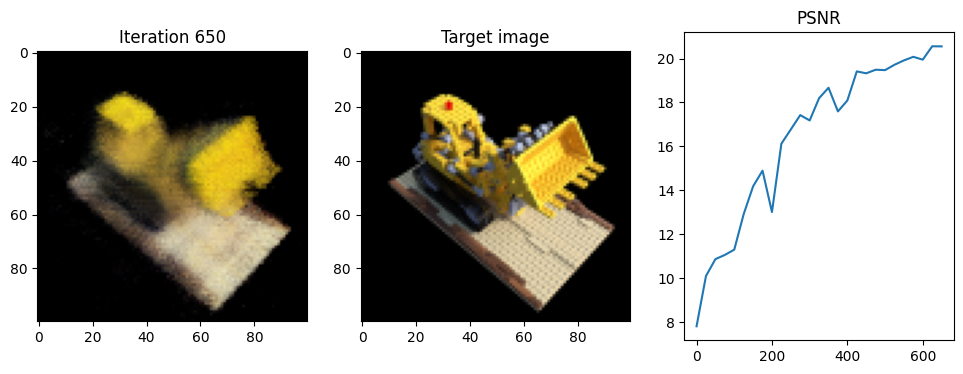

Iteration 675  Loss: 0.0090  PSNR: 20.45  Time: 1.03 secs per iter,  12.76 mins in total


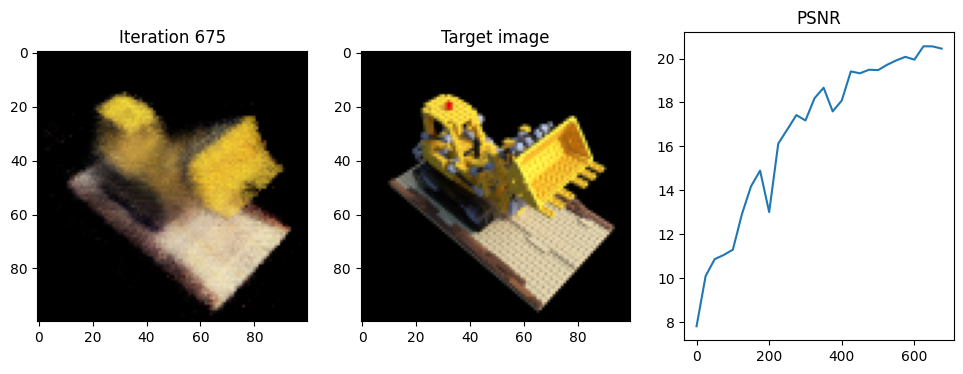

Iteration 700  Loss: 0.0086  PSNR: 20.67  Time: 1.03 secs per iter,  13.19 mins in total


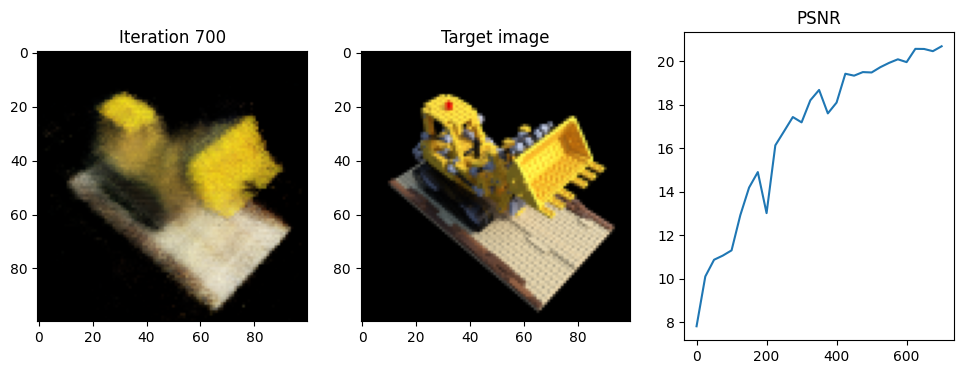

Iteration 725  Loss: 0.0081  PSNR: 20.90  Time: 1.03 secs per iter,  13.62 mins in total


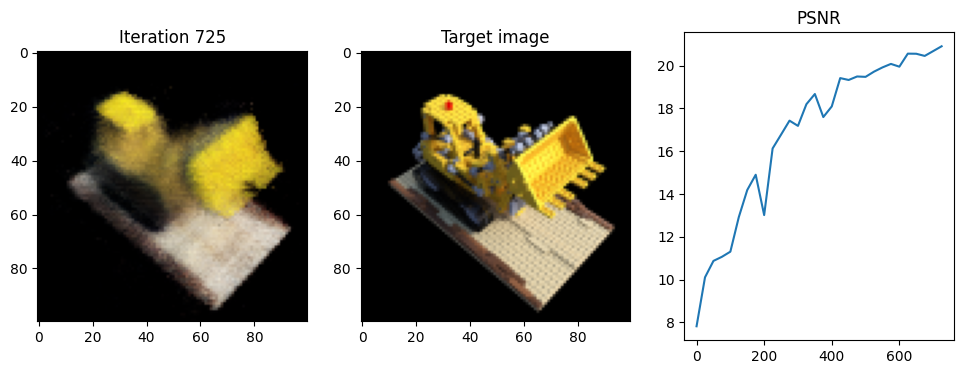

Iteration 750  Loss: 0.0081  PSNR: 20.90  Time: 1.03 secs per iter,  14.05 mins in total


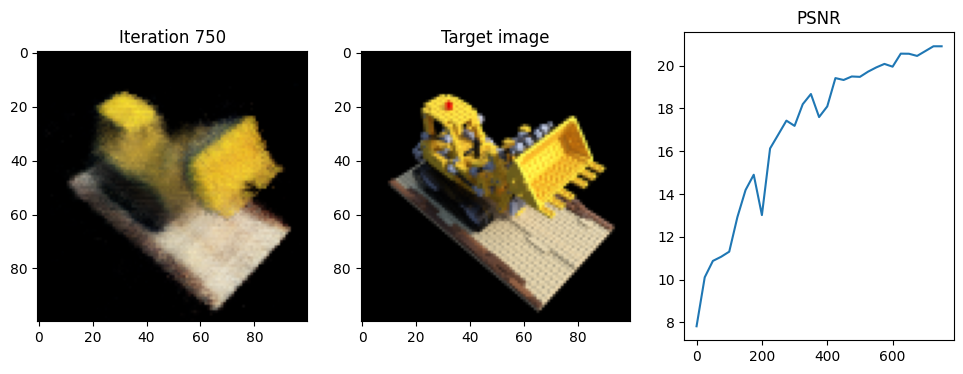

Iteration 775  Loss: 0.0084  PSNR: 20.76  Time: 1.04 secs per iter,  14.48 mins in total


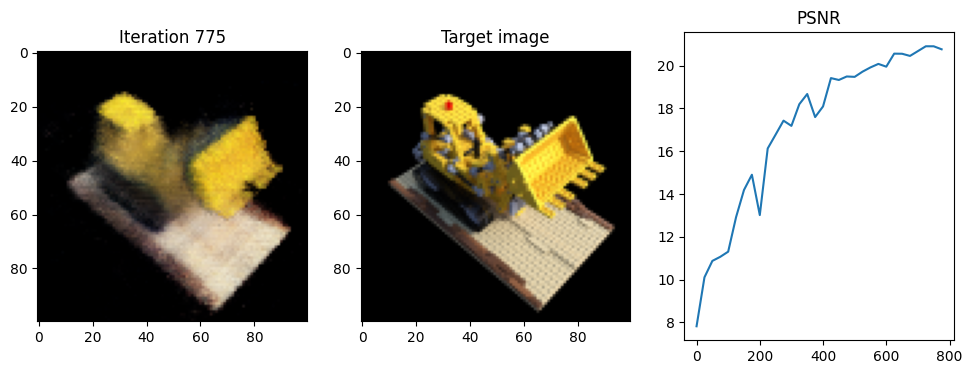

Iteration 800  Loss: 0.0084  PSNR: 20.77  Time: 1.03 secs per iter,  14.91 mins in total


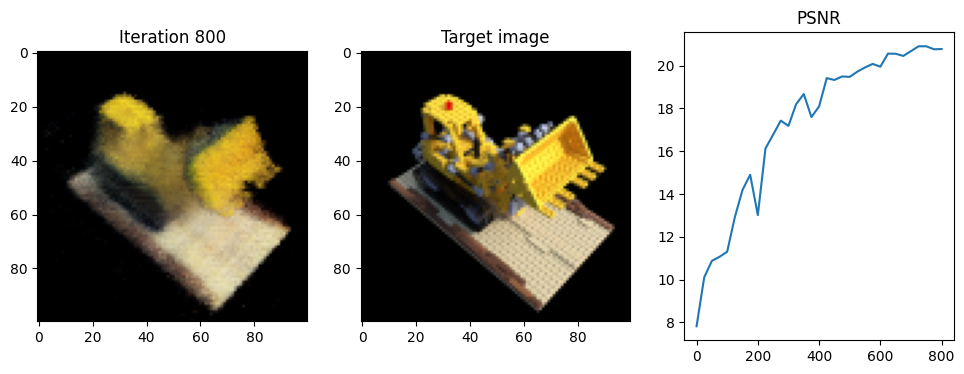

Iteration 825  Loss: 0.0077  PSNR: 21.14  Time: 1.04 secs per iter,  15.34 mins in total


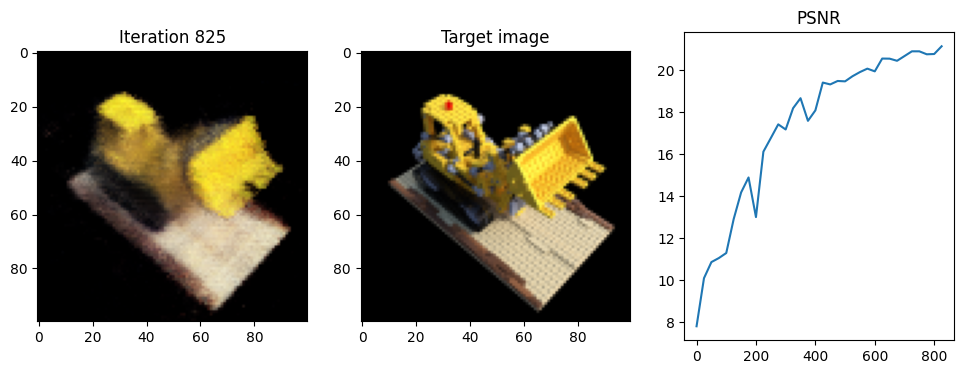

Iteration 850  Loss: 0.0082  PSNR: 20.89  Time: 1.03 secs per iter,  15.78 mins in total


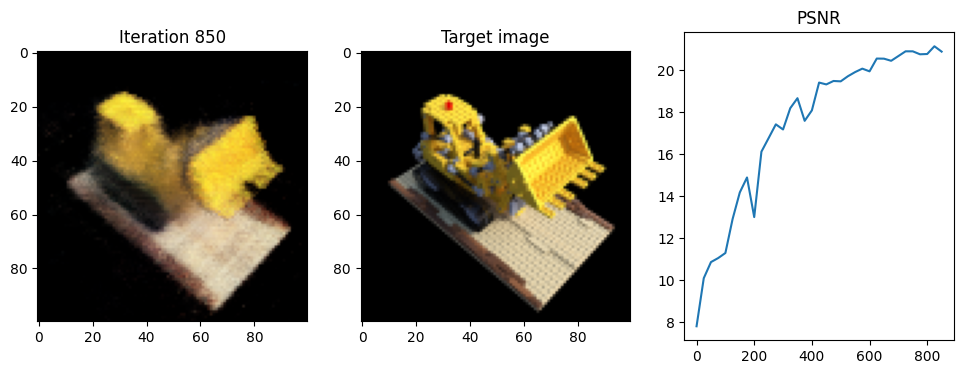

Iteration 875  Loss: 0.0077  PSNR: 21.11  Time: 1.03 secs per iter,  16.20 mins in total


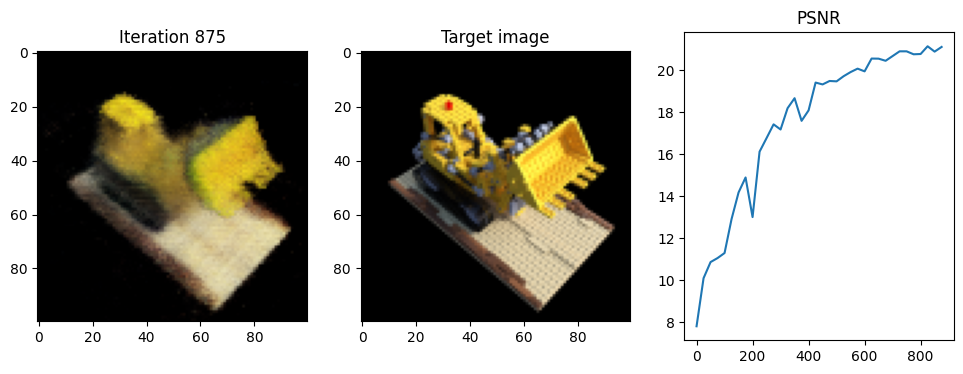

Iteration 900  Loss: 0.0072  PSNR: 21.44  Time: 1.03 secs per iter,  16.63 mins in total


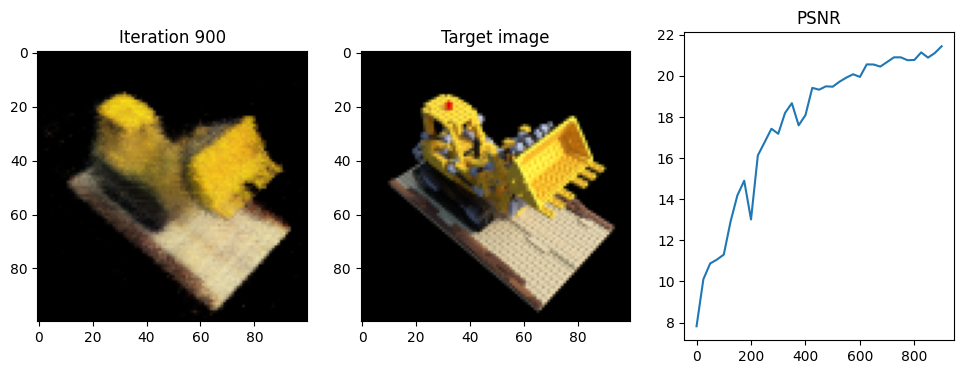

Iteration 925  Loss: 0.0067  PSNR: 21.75  Time: 1.03 secs per iter,  17.06 mins in total


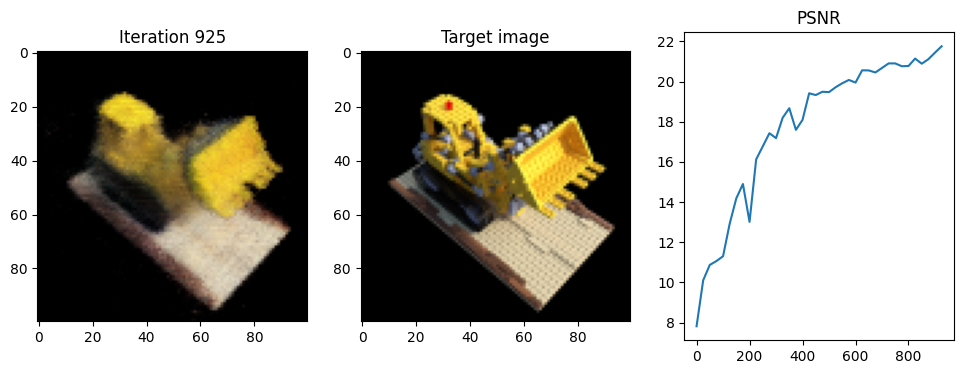

Iteration 950  Loss: 0.0073  PSNR: 21.36  Time: 1.03 secs per iter,  17.49 mins in total


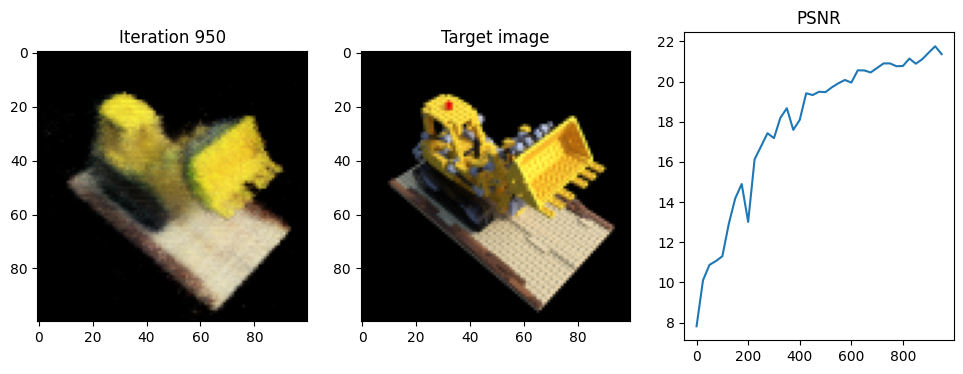

Iteration 975  Loss: 0.0070  PSNR: 21.54  Time: 1.04 secs per iter,  17.92 mins in total


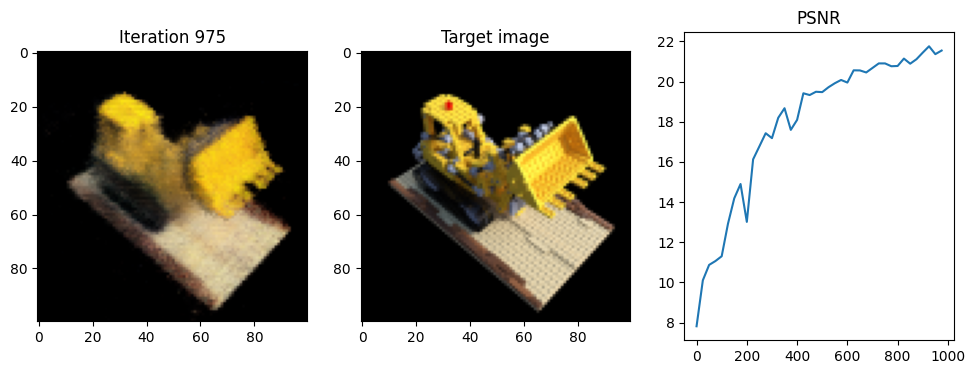

Iteration 1000  Loss: 0.0078  PSNR: 21.08  Time: 1.03 secs per iter,  18.35 mins in total


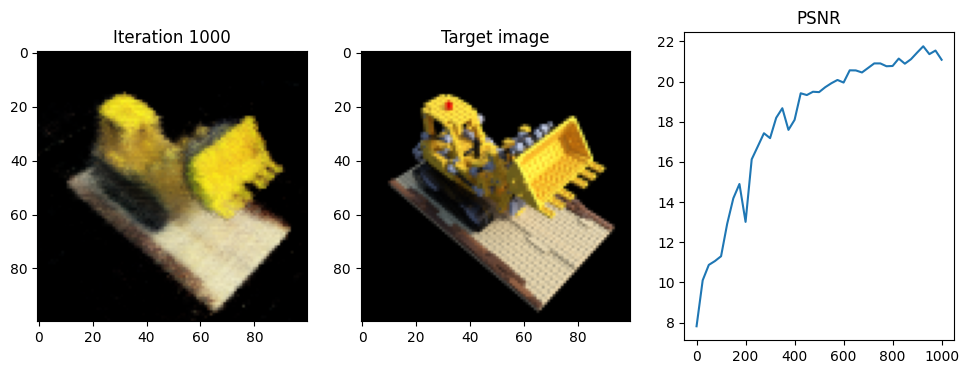

Iteration 1025  Loss: 0.0068  PSNR: 21.67  Time: 1.04 secs per iter,  18.78 mins in total


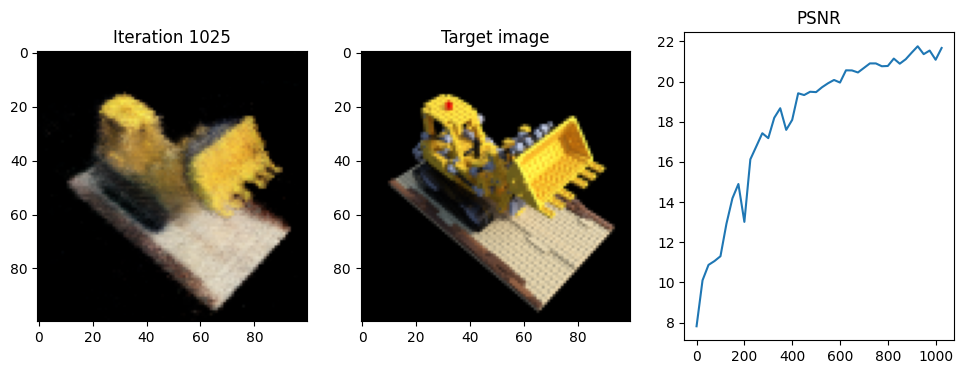

Iteration 1050  Loss: 0.0074  PSNR: 21.32  Time: 1.04 secs per iter,  19.22 mins in total


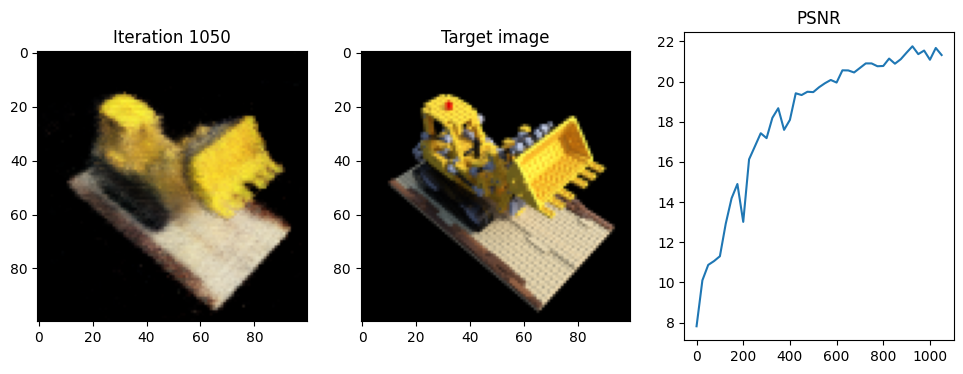

Iteration 1075  Loss: 0.0074  PSNR: 21.32  Time: 1.03 secs per iter,  19.65 mins in total


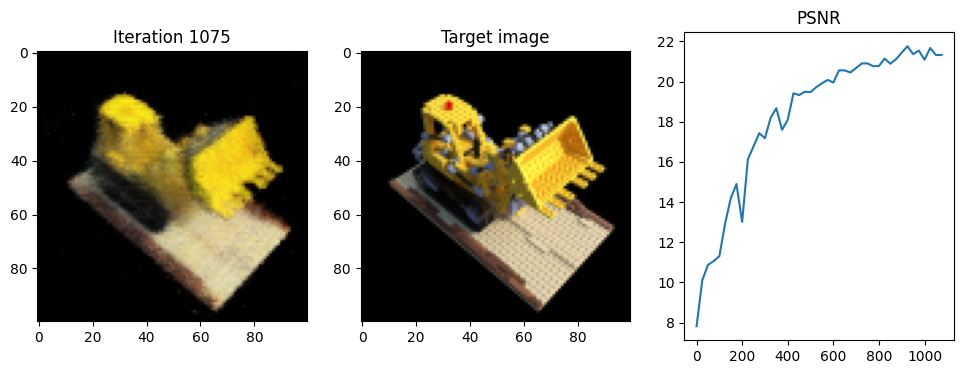

Iteration 1100  Loss: 0.0077  PSNR: 21.15  Time: 1.03 secs per iter,  20.07 mins in total


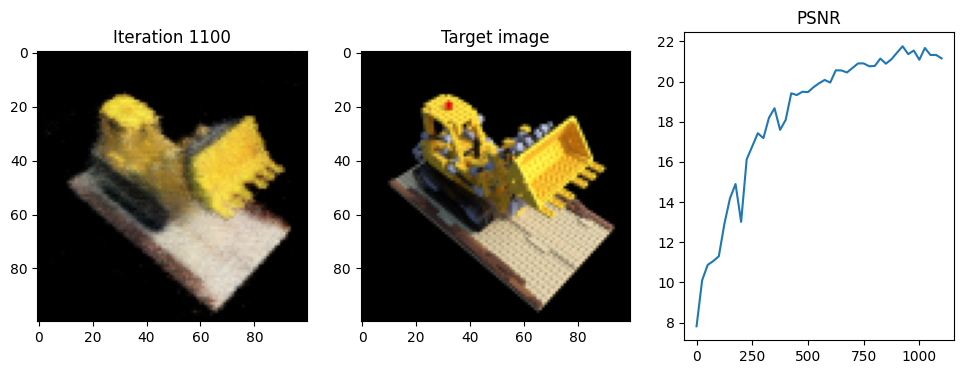

Iteration 1125  Loss: 0.0060  PSNR: 22.19  Time: 1.03 secs per iter,  20.50 mins in total


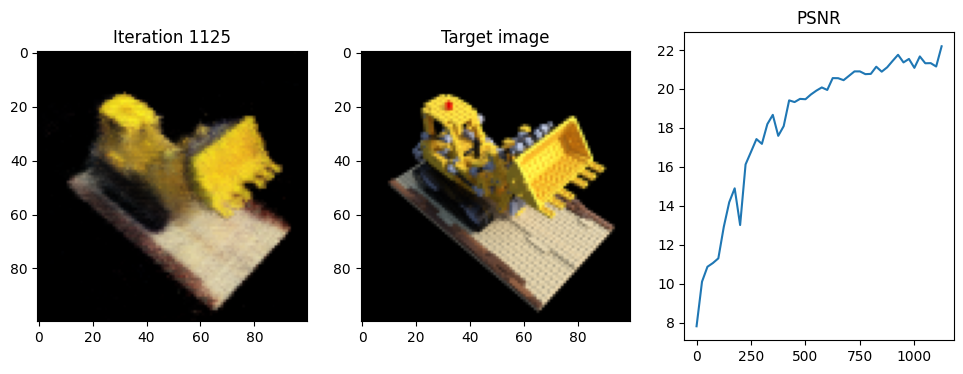

Iteration 1150  Loss: 0.0066  PSNR: 21.81  Time: 1.03 secs per iter,  20.93 mins in total


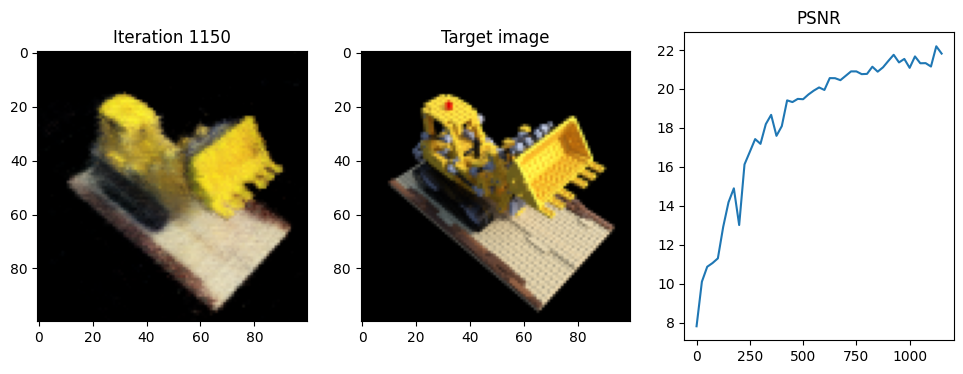

Iteration 1175  Loss: 0.0066  PSNR: 21.83  Time: 1.03 secs per iter,  21.36 mins in total


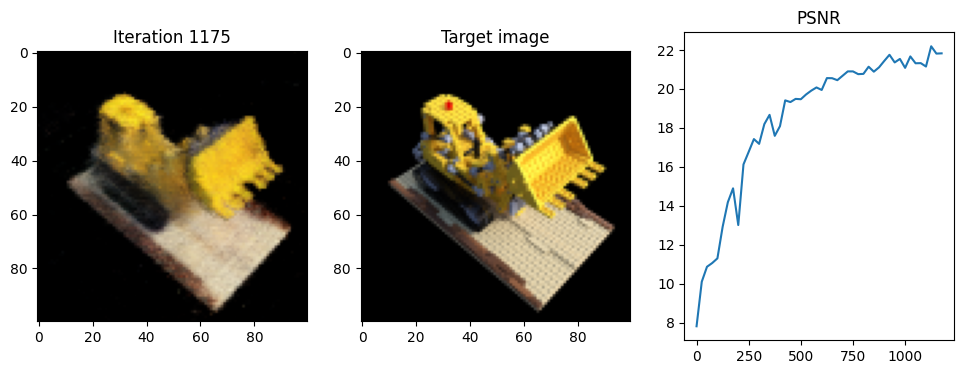

Iteration 1200  Loss: 0.0063  PSNR: 21.98  Time: 1.03 secs per iter,  21.79 mins in total


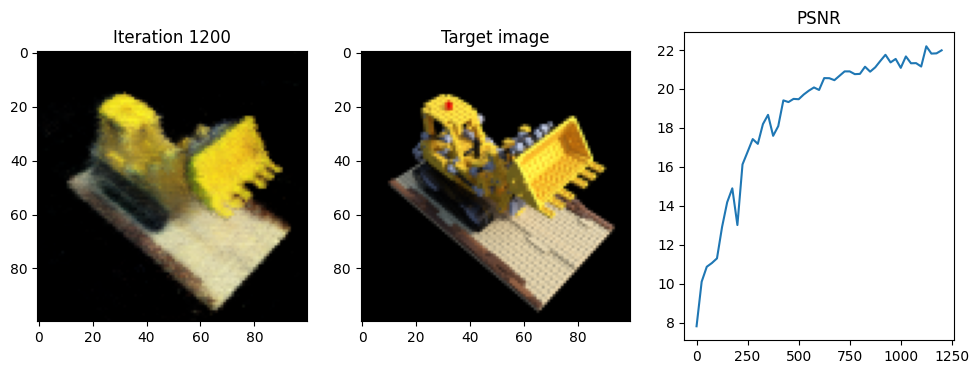

Iteration 1225  Loss: 0.0065  PSNR: 21.86  Time: 1.04 secs per iter,  22.22 mins in total


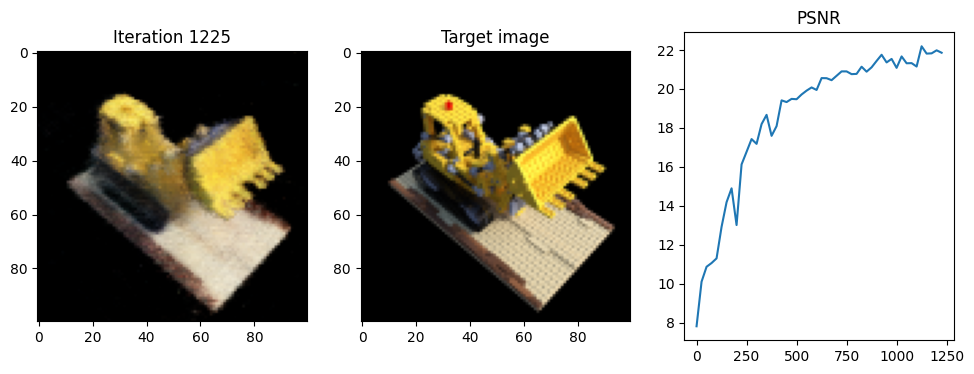

Iteration 1250  Loss: 0.0070  PSNR: 21.55  Time: 1.04 secs per iter,  22.66 mins in total


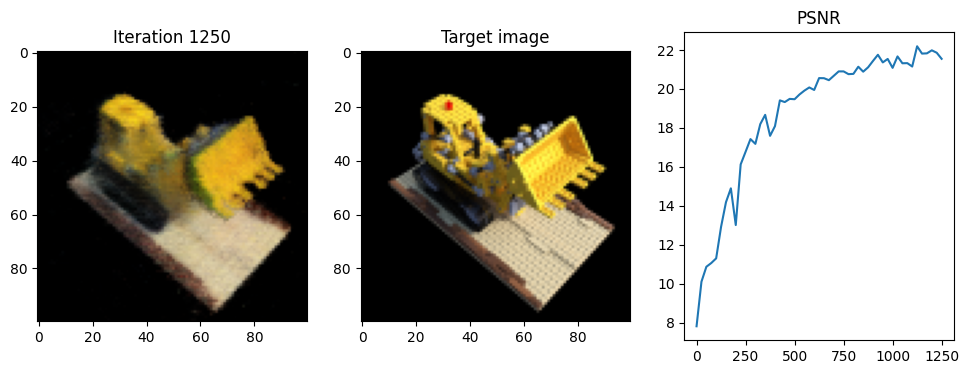

Iteration 1275  Loss: 0.0067  PSNR: 21.71  Time: 1.03 secs per iter,  23.09 mins in total


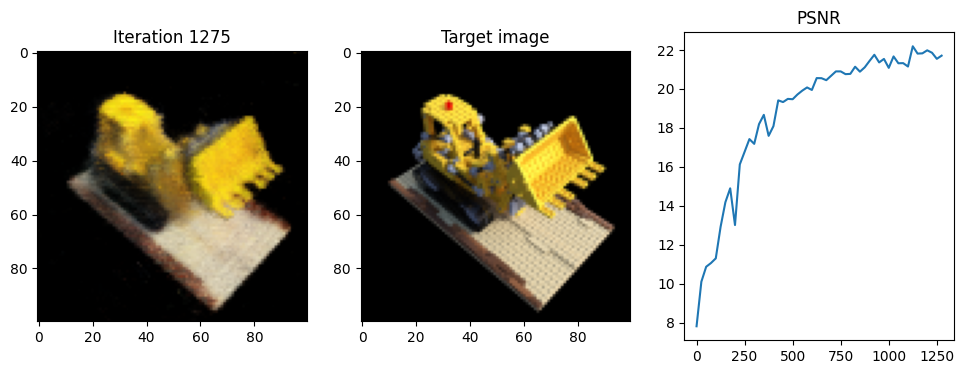

Iteration 1300  Loss: 0.0064  PSNR: 21.95  Time: 1.03 secs per iter,  23.51 mins in total


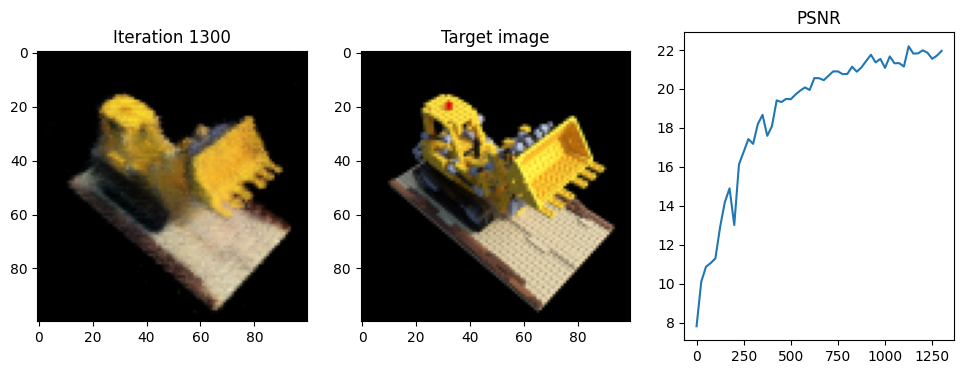

Iteration 1325  Loss: 0.0063  PSNR: 21.99  Time: 1.03 secs per iter,  23.94 mins in total


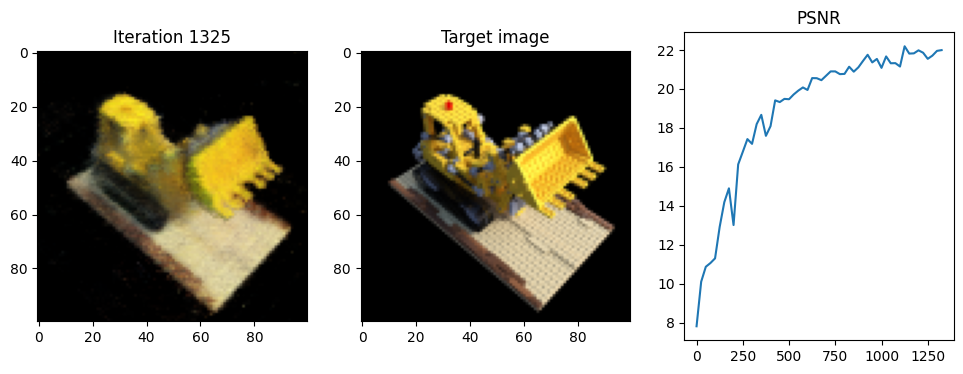

Iteration 1350  Loss: 0.0062  PSNR: 22.06  Time: 1.03 secs per iter,  24.37 mins in total


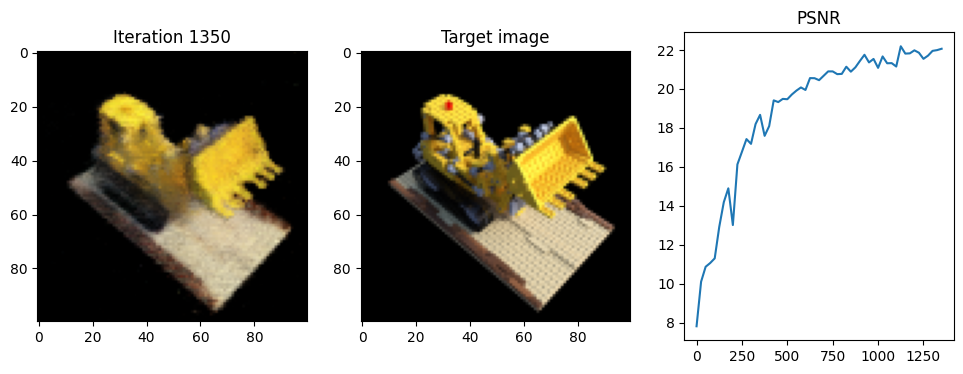

Iteration 1375  Loss: 0.0063  PSNR: 21.99  Time: 1.03 secs per iter,  24.80 mins in total


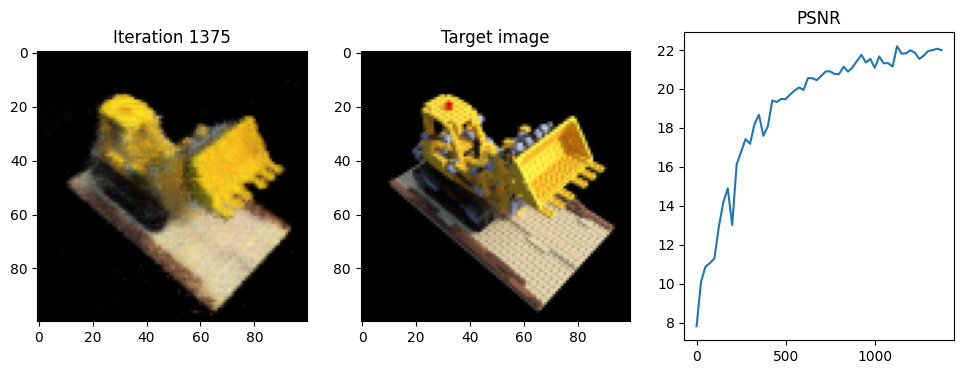

Iteration 1400  Loss: 0.0063  PSNR: 21.98  Time: 1.02 secs per iter,  25.23 mins in total


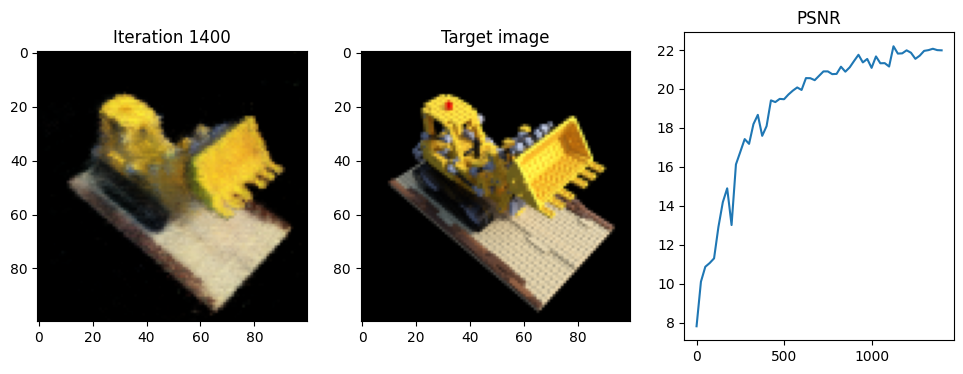

Iteration 1425  Loss: 0.0066  PSNR: 21.78  Time: 1.02 secs per iter,  25.65 mins in total


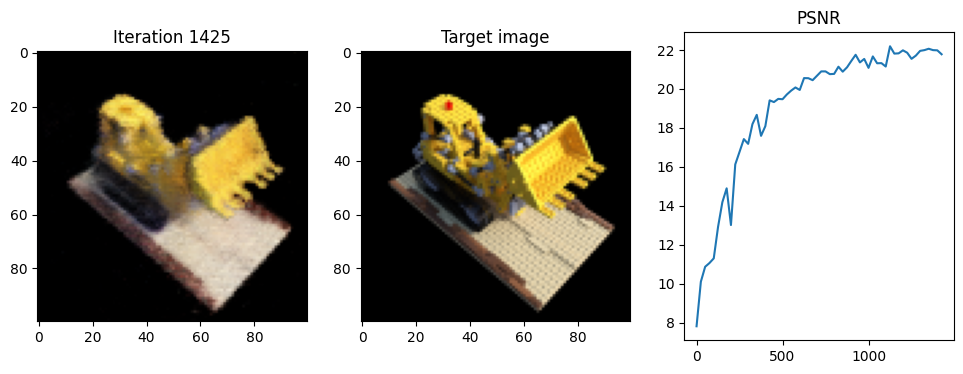

Iteration 1450  Loss: 0.0056  PSNR: 22.53  Time: 1.02 secs per iter,  26.08 mins in total


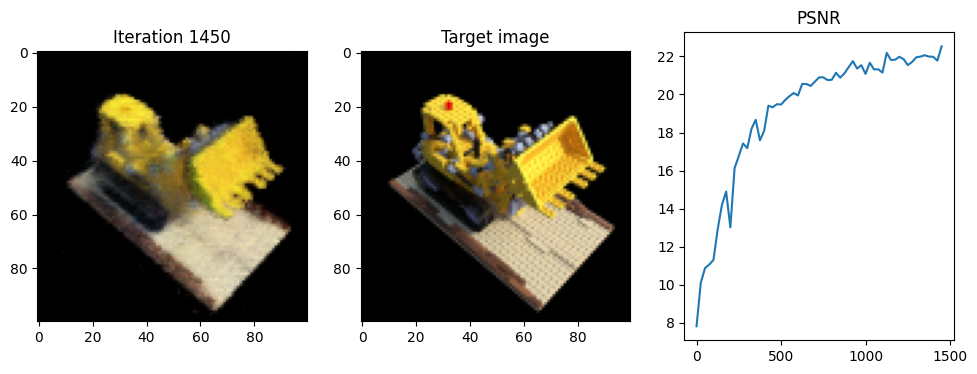

Iteration 1475  Loss: 0.0056  PSNR: 22.51  Time: 1.01 secs per iter,  26.50 mins in total


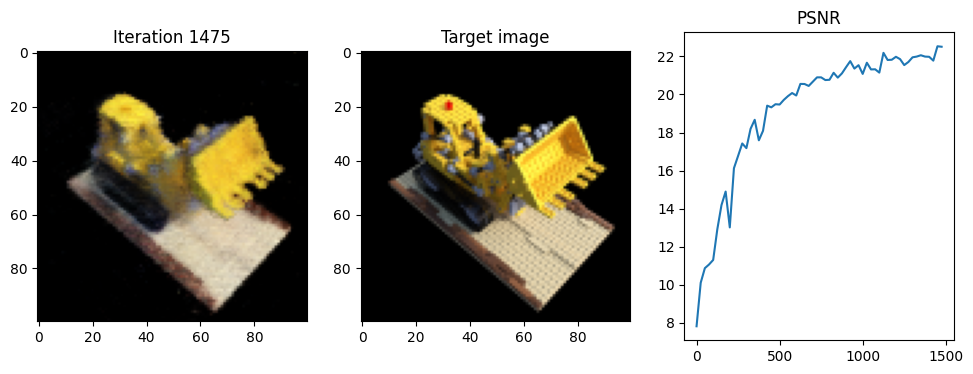

Iteration 1500  Loss: 0.0055  PSNR: 22.60  Time: 1.01 secs per iter,  26.92 mins in total


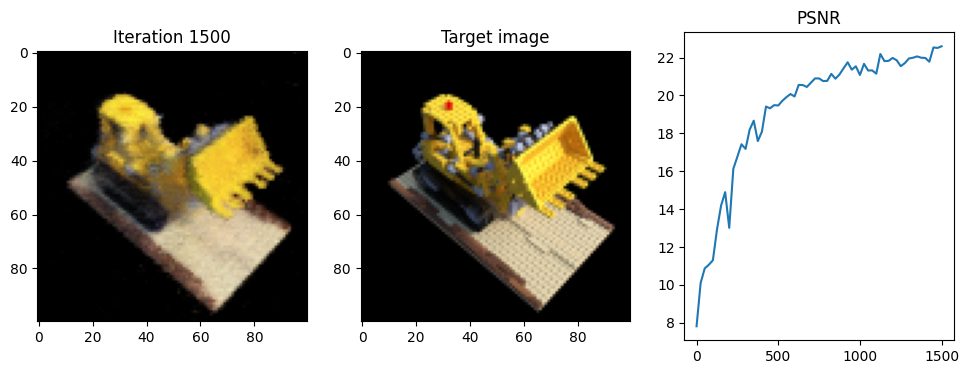

Iteration 1525  Loss: 0.0056  PSNR: 22.48  Time: 1.01 secs per iter,  27.34 mins in total


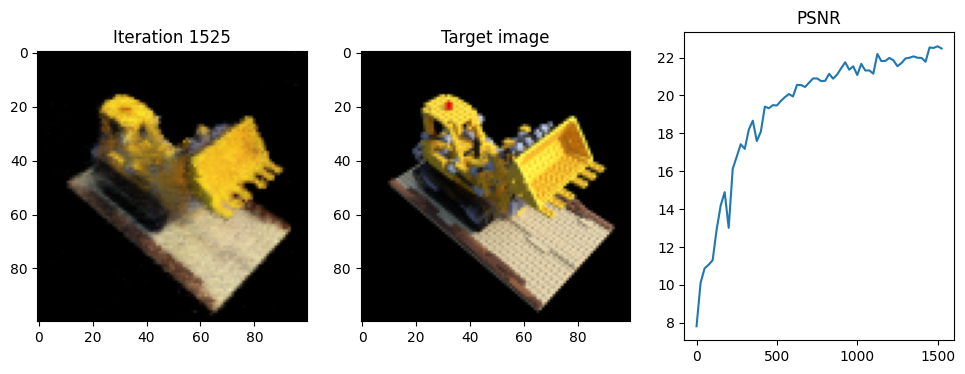

Iteration 1550  Loss: 0.0052  PSNR: 22.87  Time: 1.00 secs per iter,  27.75 mins in total


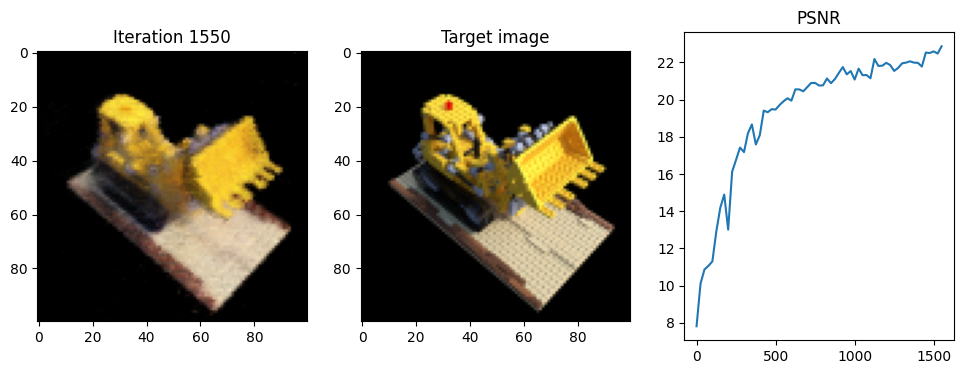

Iteration 1575  Loss: 0.0053  PSNR: 22.78  Time: 1.01 secs per iter,  28.17 mins in total


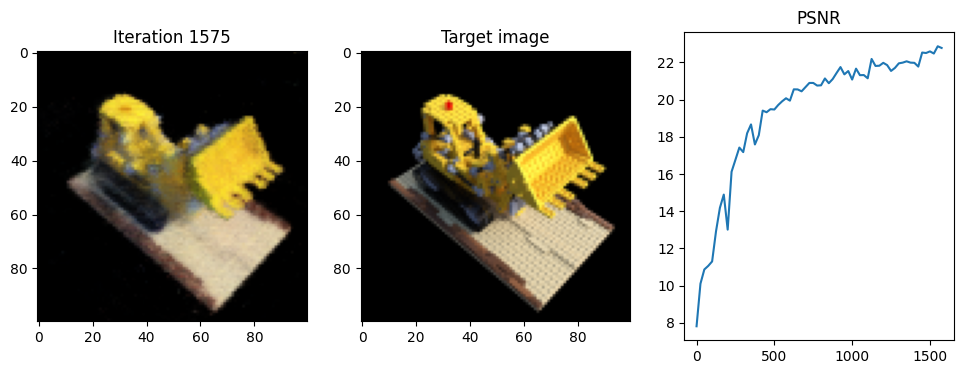

Iteration 1600  Loss: 0.0060  PSNR: 22.19  Time: 1.01 secs per iter,  28.59 mins in total


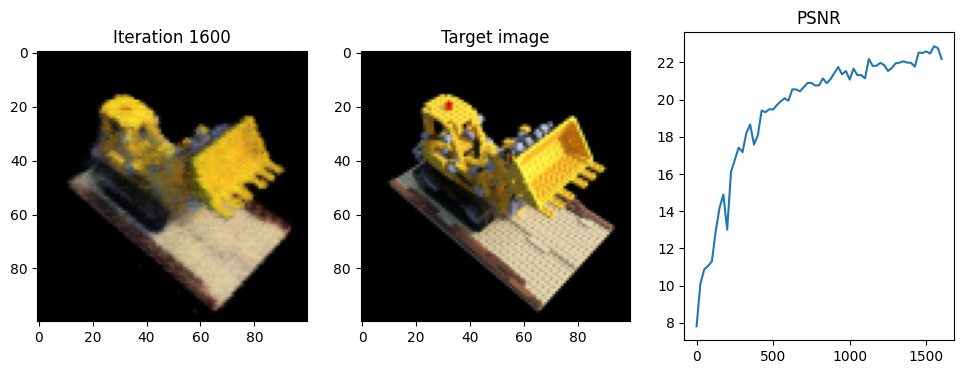

Iteration 1625  Loss: 0.0050  PSNR: 23.00  Time: 1.00 secs per iter,  29.01 mins in total


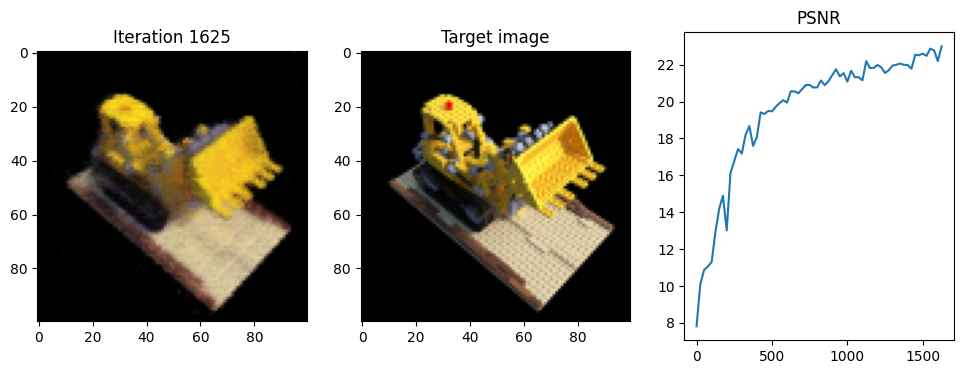

Iteration 1650  Loss: 0.0047  PSNR: 23.32  Time: 1.00 secs per iter,  29.43 mins in total


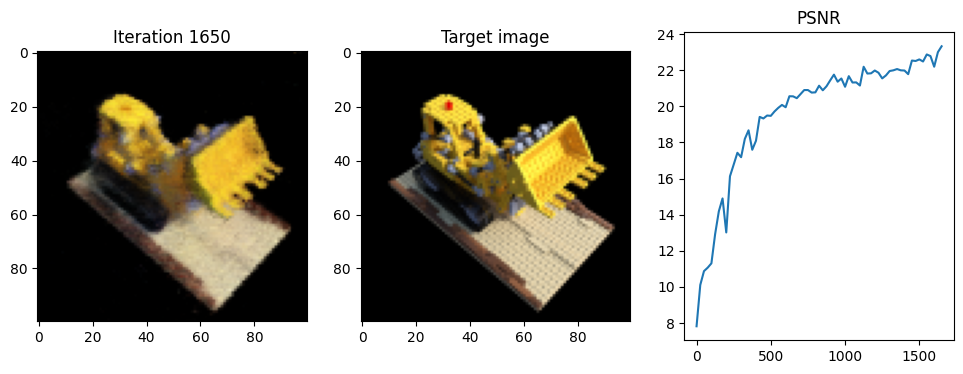

Iteration 1675  Loss: 0.0048  PSNR: 23.21  Time: 1.00 secs per iter,  29.84 mins in total


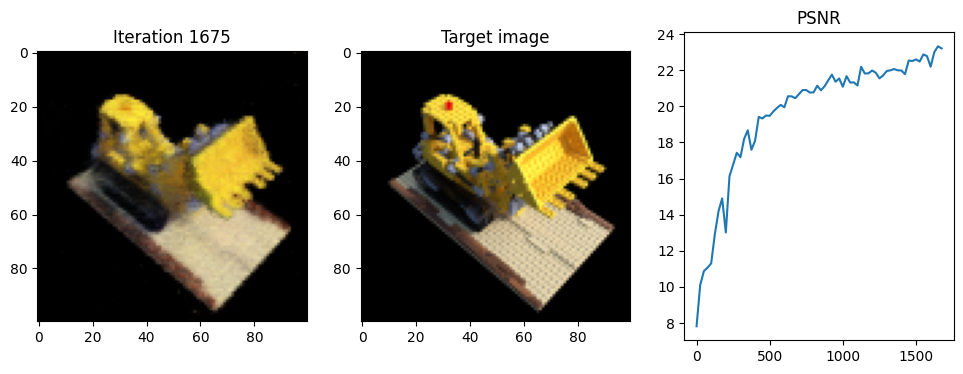

Iteration 1700  Loss: 0.0053  PSNR: 22.79  Time: 1.00 secs per iter,  30.26 mins in total


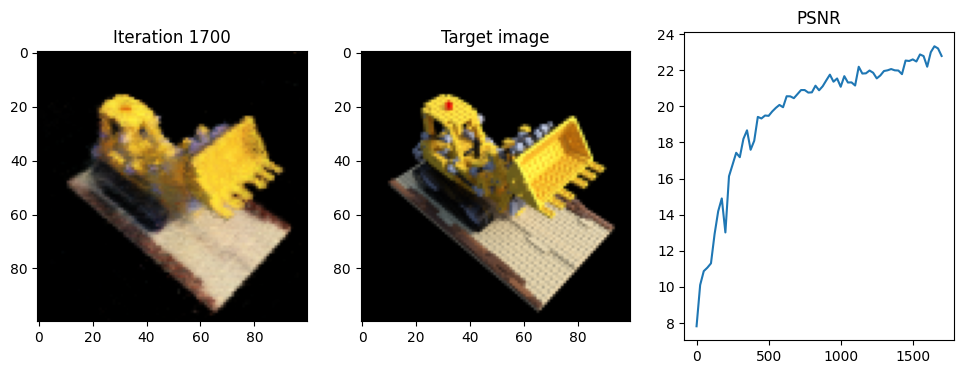

Iteration 1725  Loss: 0.0047  PSNR: 23.32  Time: 1.01 secs per iter,  30.68 mins in total


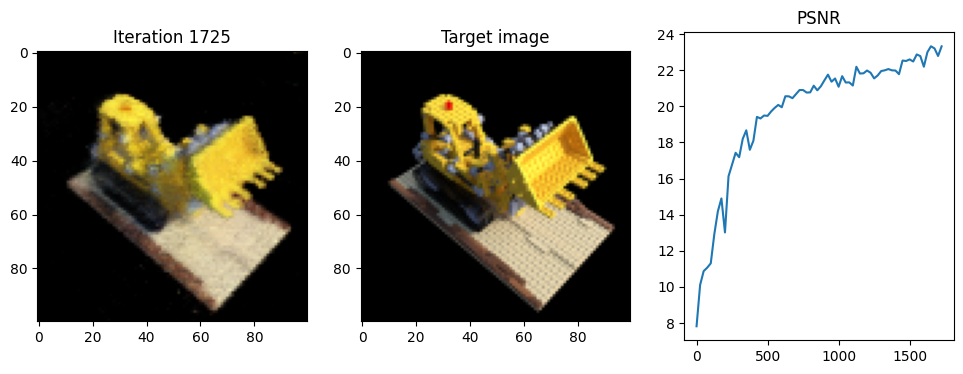

Iteration 1750  Loss: 0.0045  PSNR: 23.51  Time: 1.00 secs per iter,  31.10 mins in total


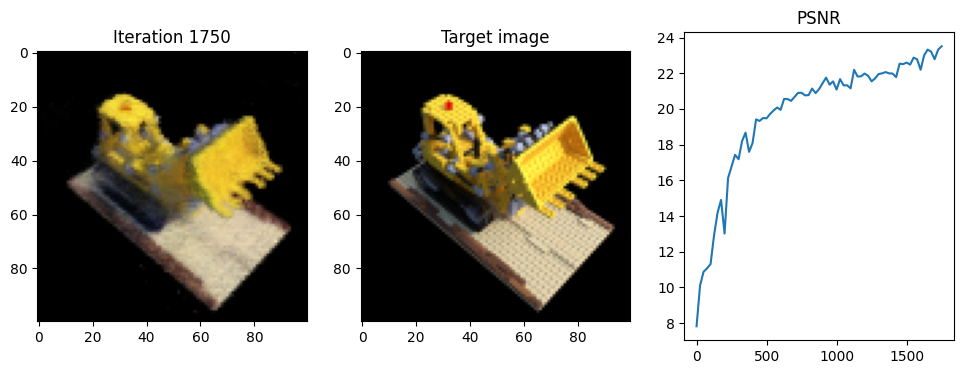

Iteration 1775  Loss: 0.0050  PSNR: 23.01  Time: 1.00 secs per iter,  31.51 mins in total


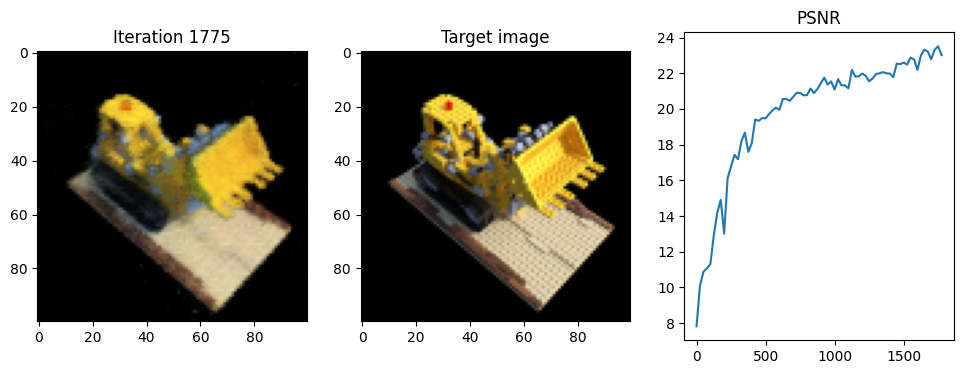

Iteration 1800  Loss: 0.0044  PSNR: 23.58  Time: 1.00 secs per iter,  31.93 mins in total


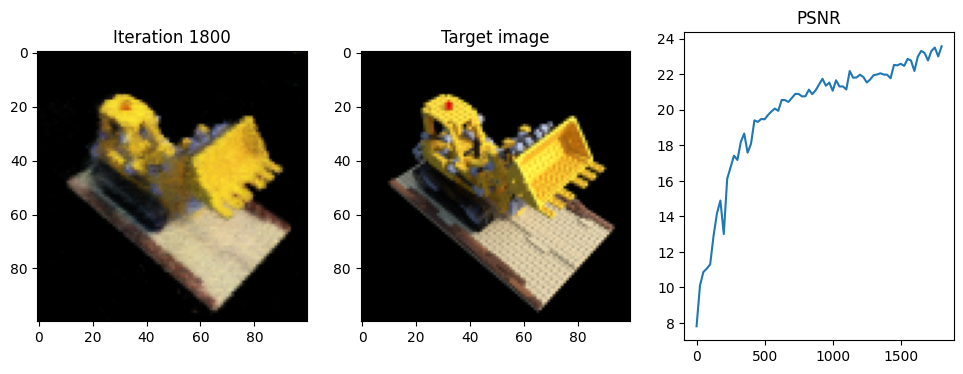

Iteration 1825  Loss: 0.0041  PSNR: 23.89  Time: 0.99 secs per iter,  32.34 mins in total


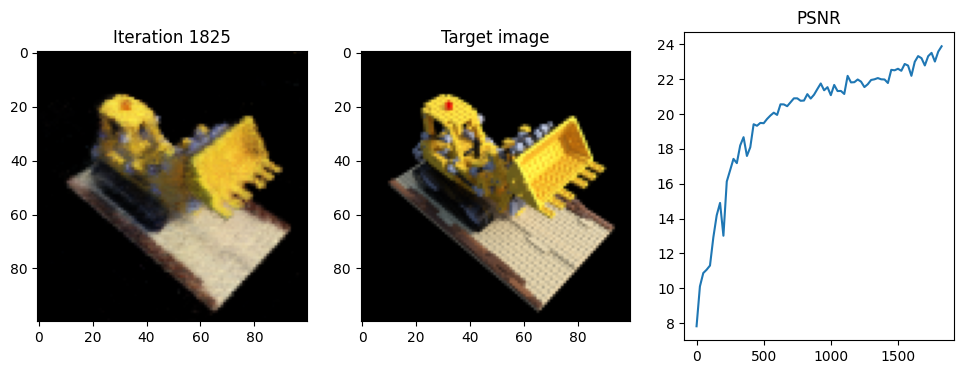

Iteration 1850  Loss: 0.0049  PSNR: 23.14  Time: 1.01 secs per iter,  32.76 mins in total


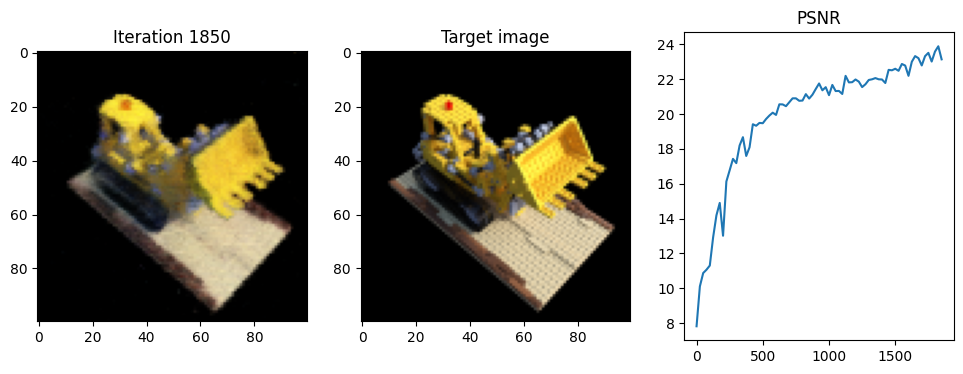

Iteration 1875  Loss: 0.0046  PSNR: 23.40  Time: 1.00 secs per iter,  33.17 mins in total


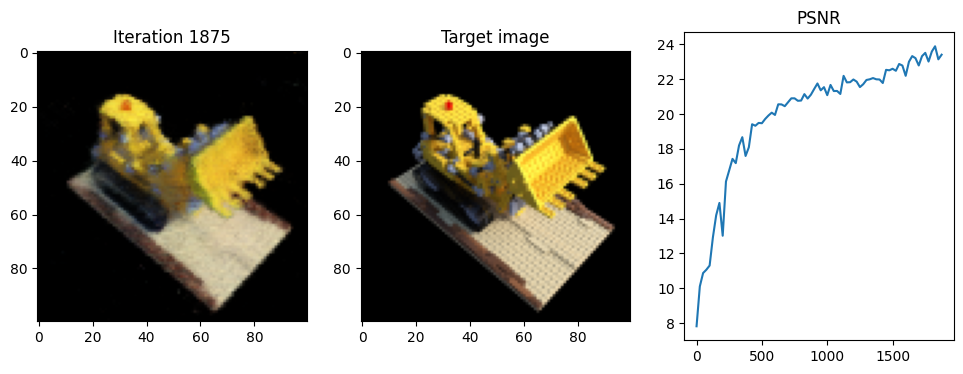

Iteration 1900  Loss: 0.0045  PSNR: 23.48  Time: 1.00 secs per iter,  33.59 mins in total


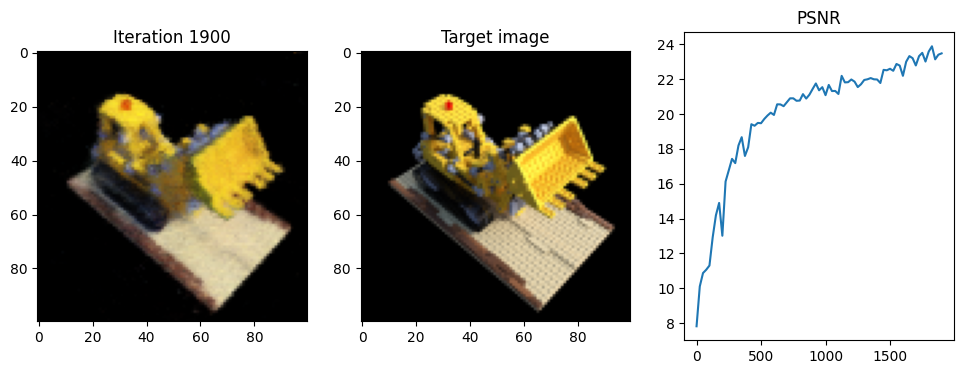

Iteration 1925  Loss: 0.0044  PSNR: 23.57  Time: 1.00 secs per iter,  34.01 mins in total


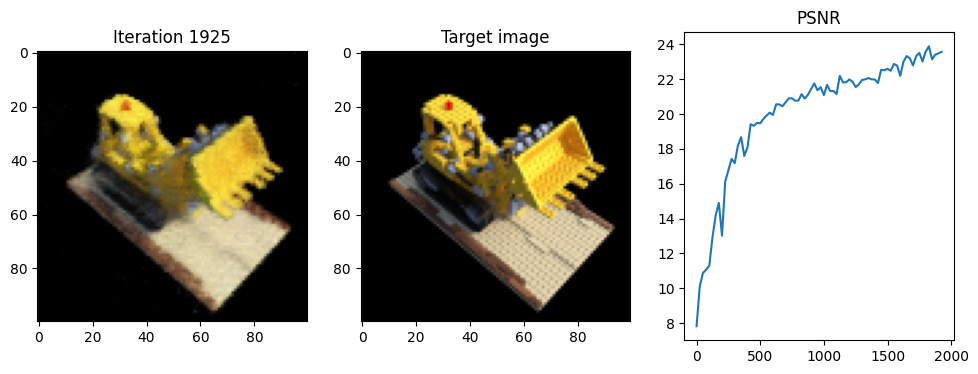

Iteration 1950  Loss: 0.0049  PSNR: 23.13  Time: 1.00 secs per iter,  34.43 mins in total


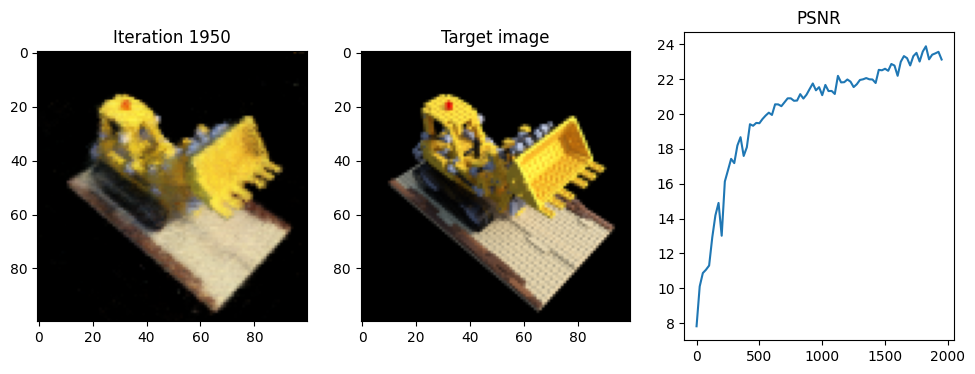

Iteration 1975  Loss: 0.0041  PSNR: 23.91  Time: 1.00 secs per iter,  34.84 mins in total


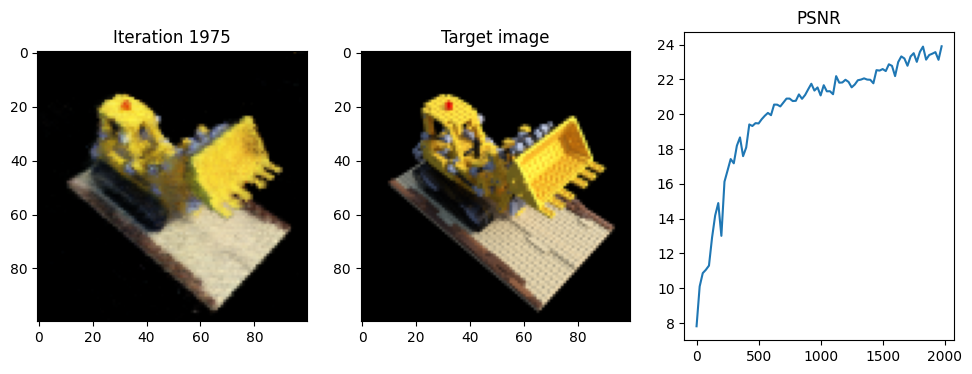

Iteration 2000  Loss: 0.0036  PSNR: 24.40  Time: 1.00 secs per iter,  35.26 mins in total


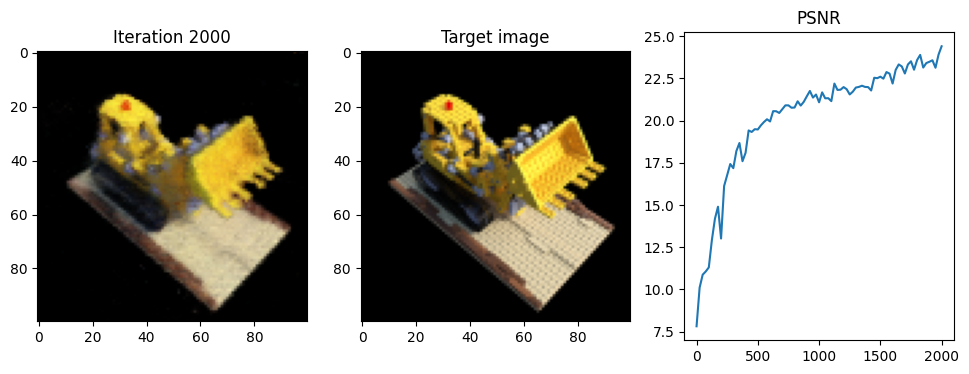

Iteration 2025  Loss: 0.0046  PSNR: 23.40  Time: 1.00 secs per iter,  35.68 mins in total


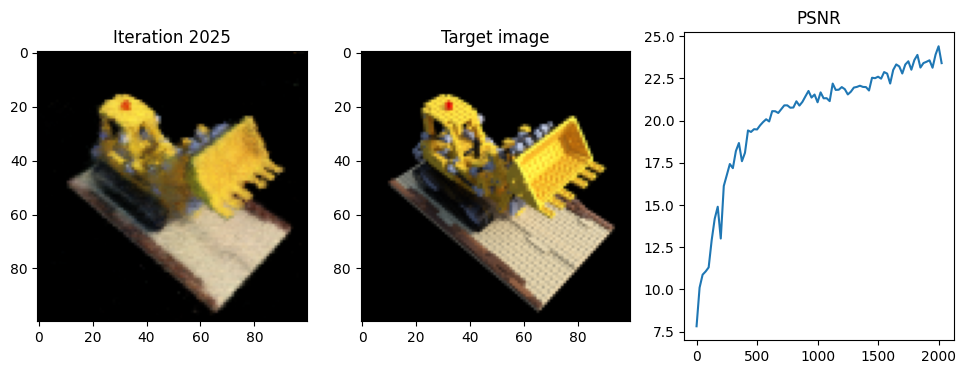

Iteration 2050  Loss: 0.0042  PSNR: 23.76  Time: 1.00 secs per iter,  36.10 mins in total


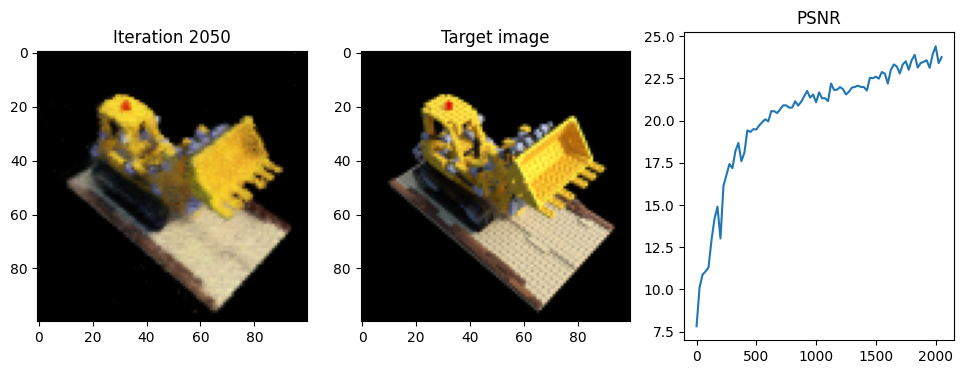

Iteration 2075  Loss: 0.0048  PSNR: 23.18  Time: 1.00 secs per iter,  36.51 mins in total


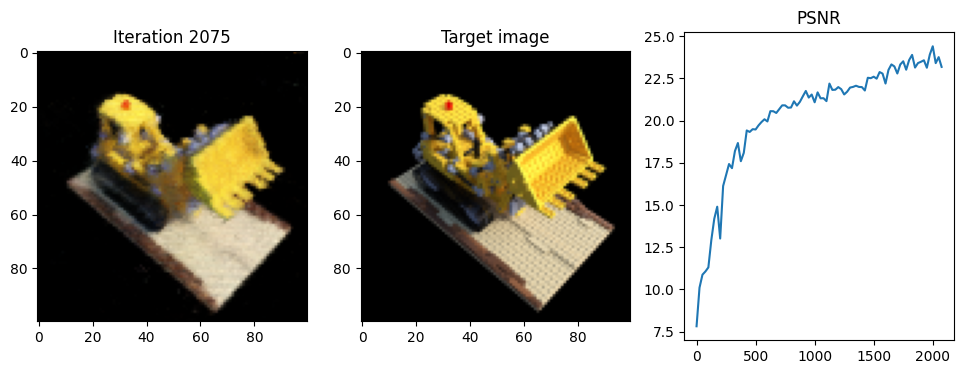

Iteration 2100  Loss: 0.0042  PSNR: 23.73  Time: 1.01 secs per iter,  36.93 mins in total


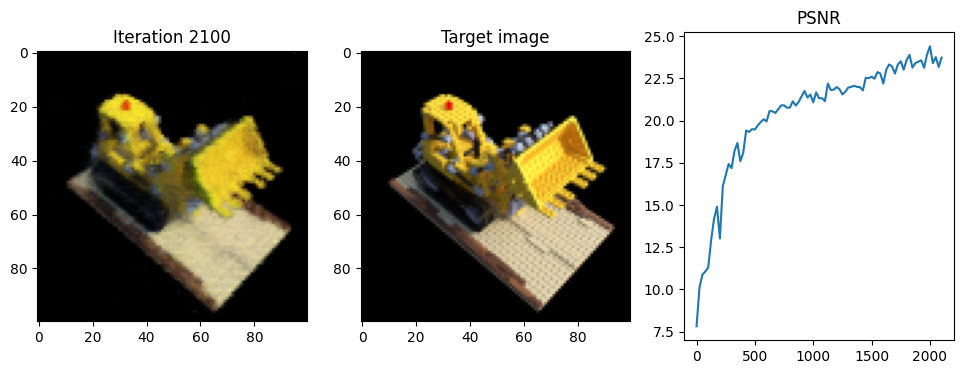

Iteration 2125  Loss: 0.0047  PSNR: 23.24  Time: 1.01 secs per iter,  37.35 mins in total


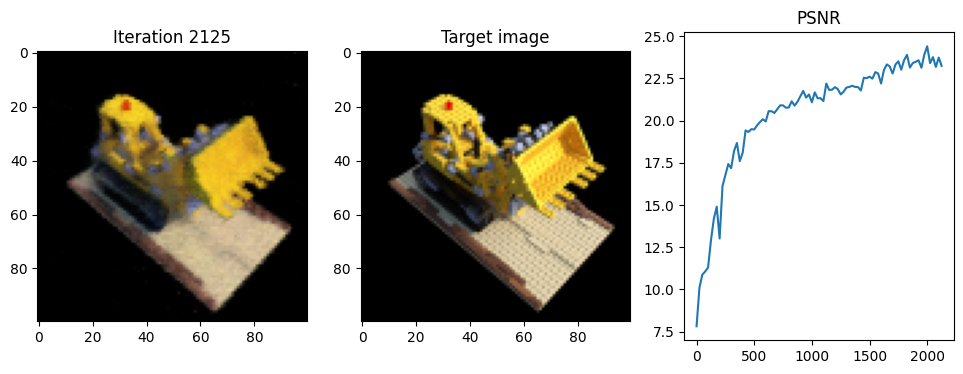

Iteration 2150  Loss: 0.0043  PSNR: 23.71  Time: 1.00 secs per iter,  37.77 mins in total


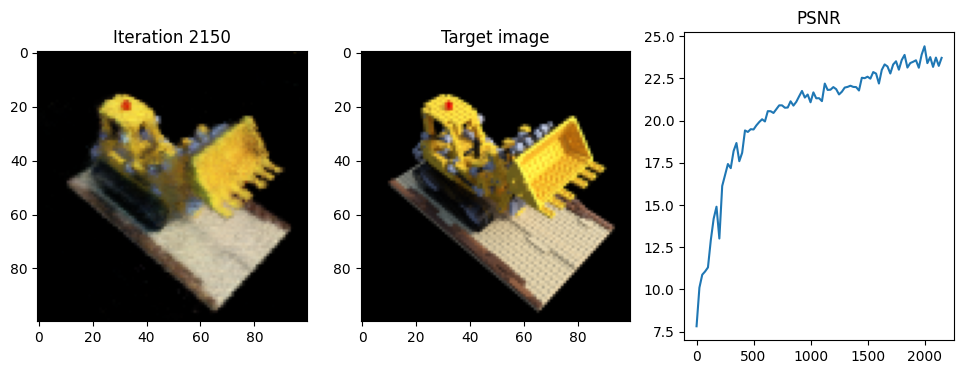

Iteration 2175  Loss: 0.0046  PSNR: 23.38  Time: 1.00 secs per iter,  38.18 mins in total


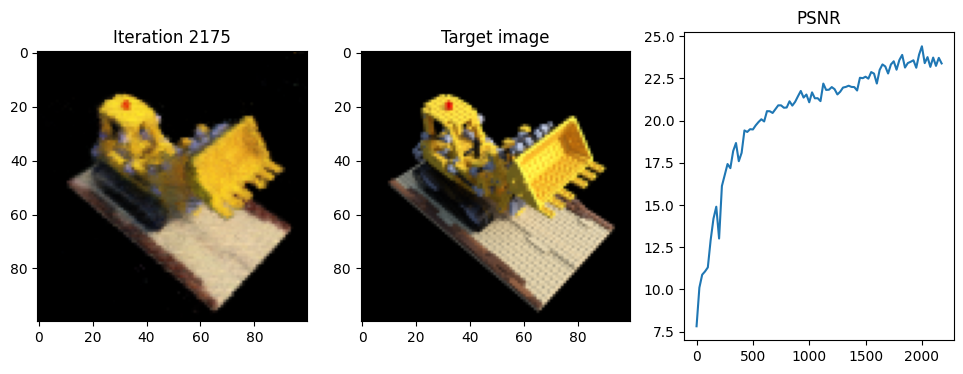

Iteration 2200  Loss: 0.0040  PSNR: 23.99  Time: 1.00 secs per iter,  38.60 mins in total


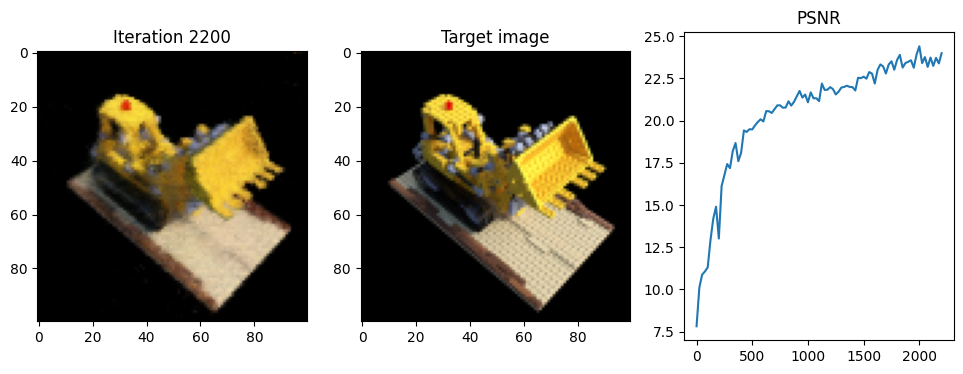

Iteration 2225  Loss: 0.0038  PSNR: 24.20  Time: 0.99 secs per iter,  39.01 mins in total


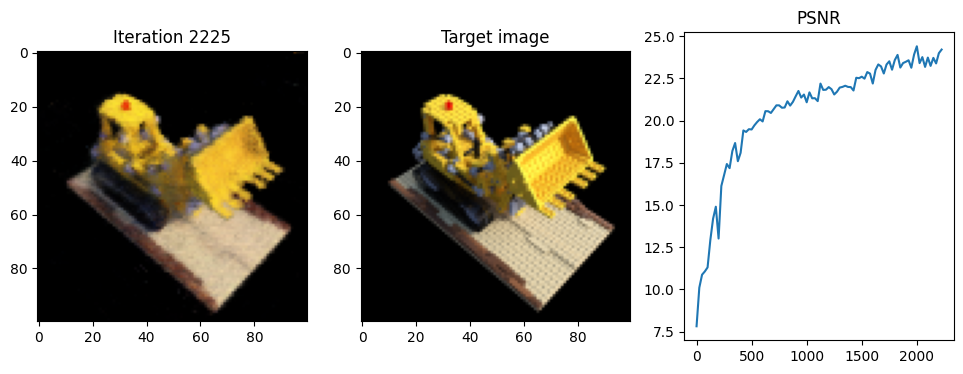

Iteration 2250  Loss: 0.0040  PSNR: 24.00  Time: 1.00 secs per iter,  39.43 mins in total


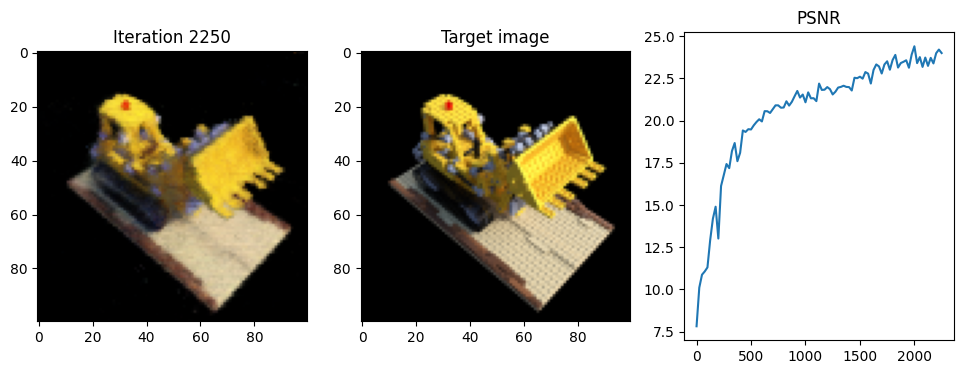

Iteration 2275  Loss: 0.0041  PSNR: 23.91  Time: 1.00 secs per iter,  39.85 mins in total


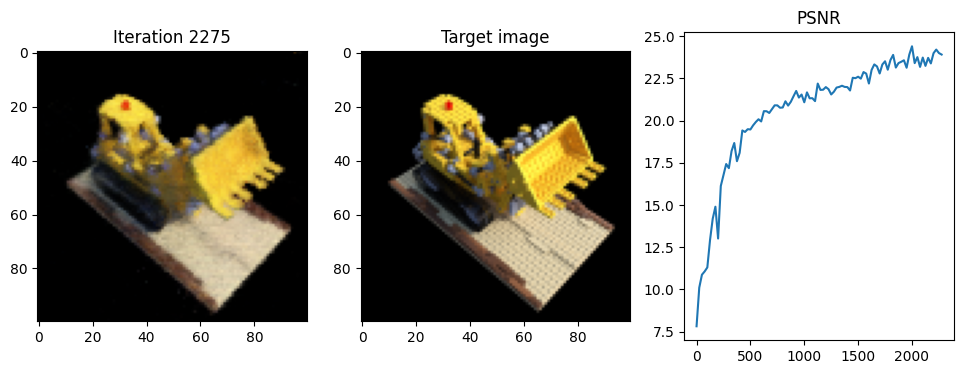

Iteration 2300  Loss: 0.0042  PSNR: 23.81  Time: 1.01 secs per iter,  40.27 mins in total


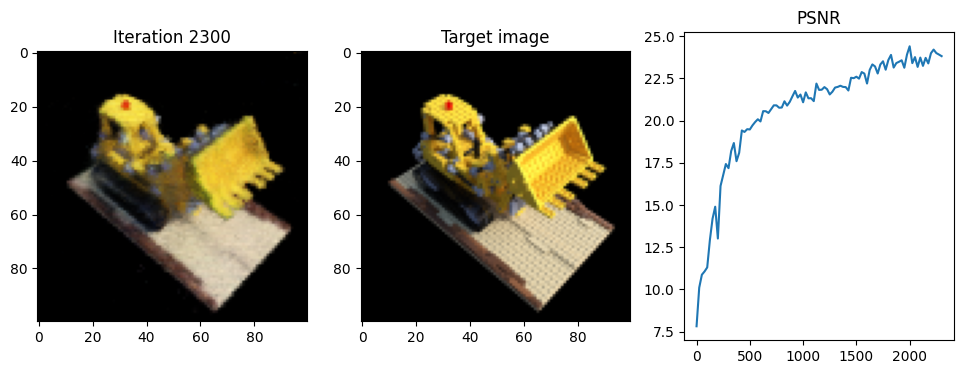

Iteration 2325  Loss: 0.0047  PSNR: 23.26  Time: 1.00 secs per iter,  40.68 mins in total


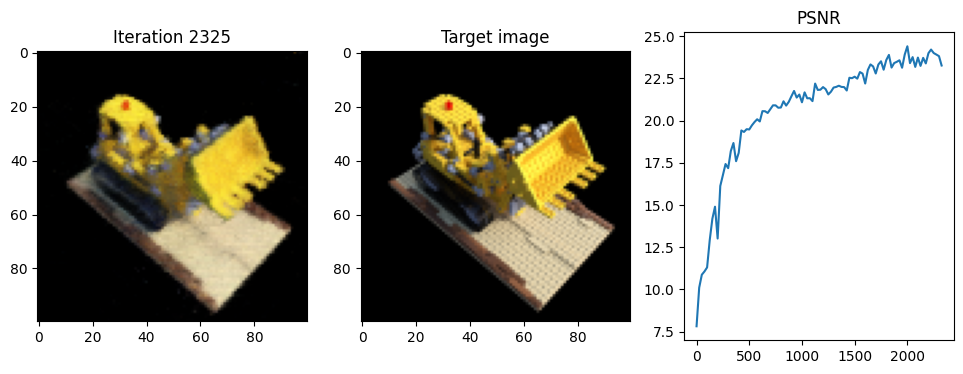

Iteration 2350  Loss: 0.0043  PSNR: 23.66  Time: 1.00 secs per iter,  41.10 mins in total


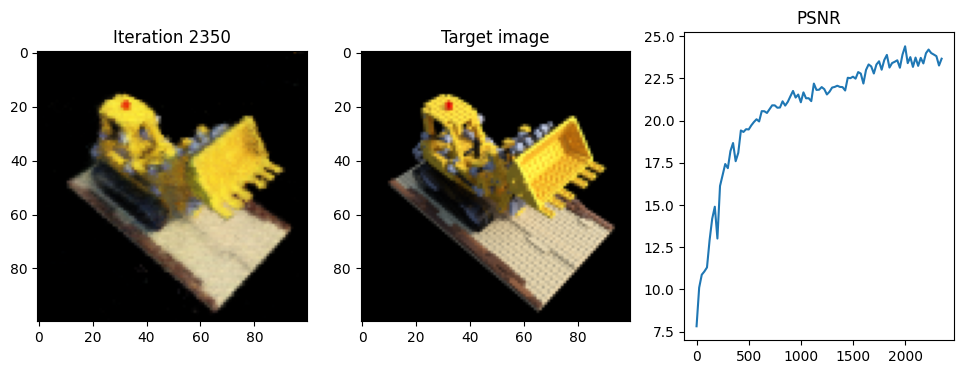

Iteration 2375  Loss: 0.0039  PSNR: 24.09  Time: 1.01 secs per iter,  41.52 mins in total


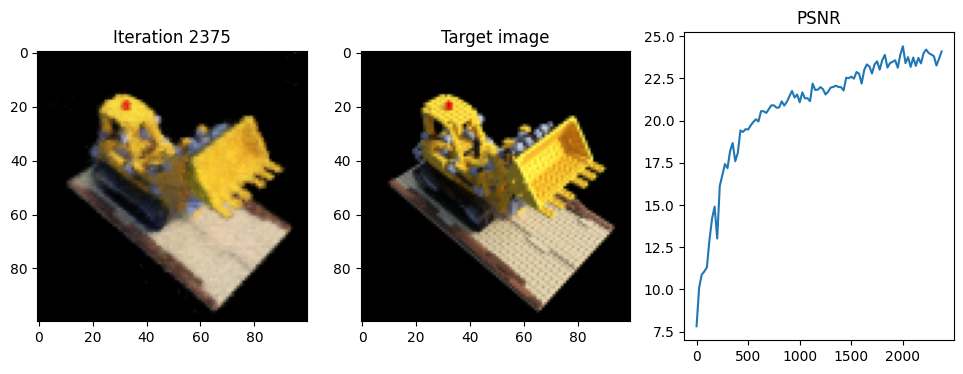

Iteration 2400  Loss: 0.0035  PSNR: 24.53  Time: 1.00 secs per iter,  41.93 mins in total


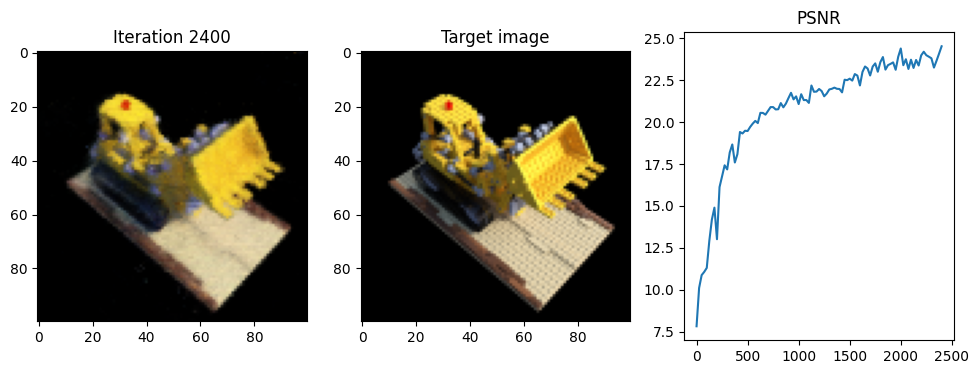

Iteration 2425  Loss: 0.0036  PSNR: 24.41  Time: 1.00 secs per iter,  42.35 mins in total


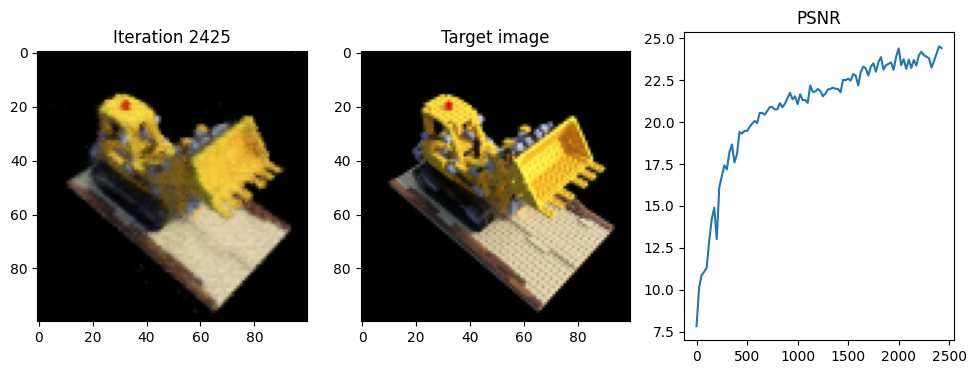

Iteration 2450  Loss: 0.0048  PSNR: 23.19  Time: 1.00 secs per iter,  42.77 mins in total


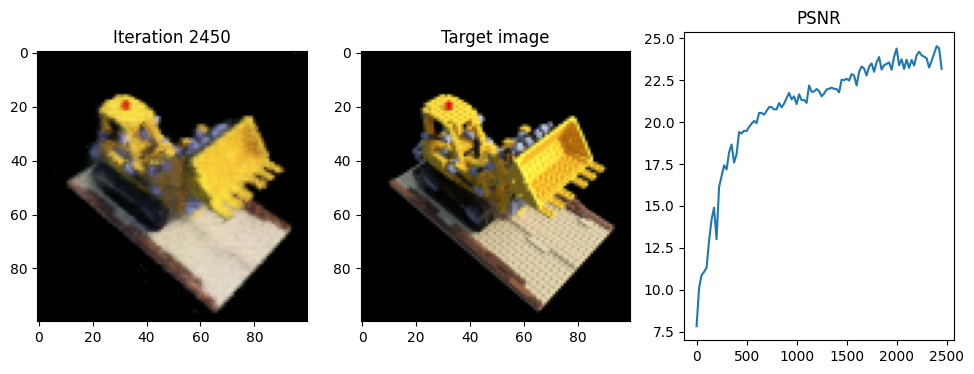

Iteration 2475  Loss: 0.0041  PSNR: 23.90  Time: 1.01 secs per iter,  43.18 mins in total


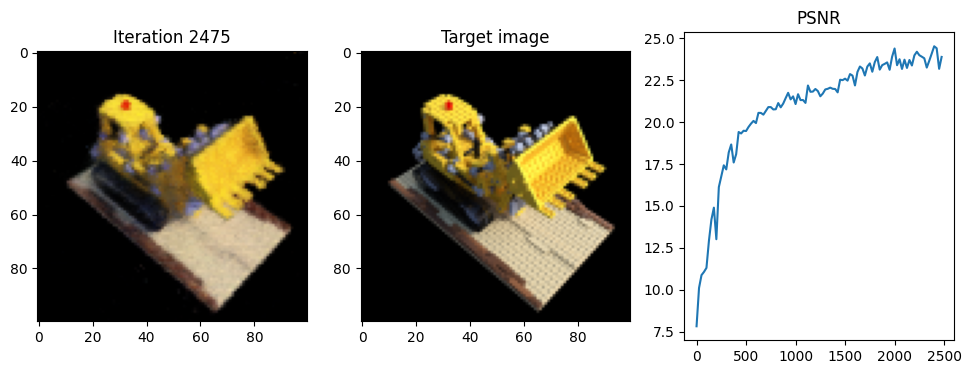

Iteration 2500  Loss: 0.0041  PSNR: 23.88  Time: 1.01 secs per iter,  43.60 mins in total


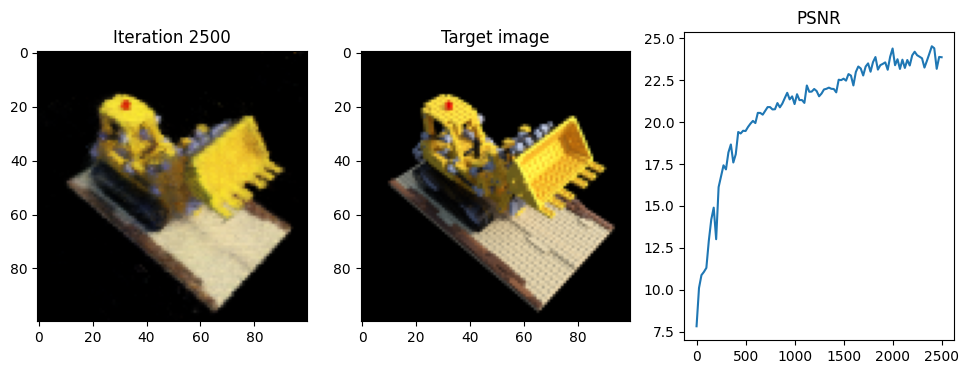

Iteration 2525  Loss: 0.0048  PSNR: 23.21  Time: 1.01 secs per iter,  44.02 mins in total


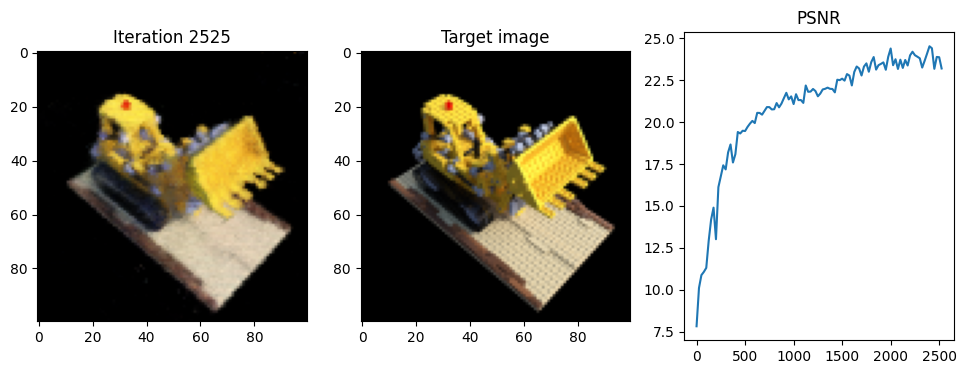

Iteration 2550  Loss: 0.0044  PSNR: 23.55  Time: 1.00 secs per iter,  44.44 mins in total


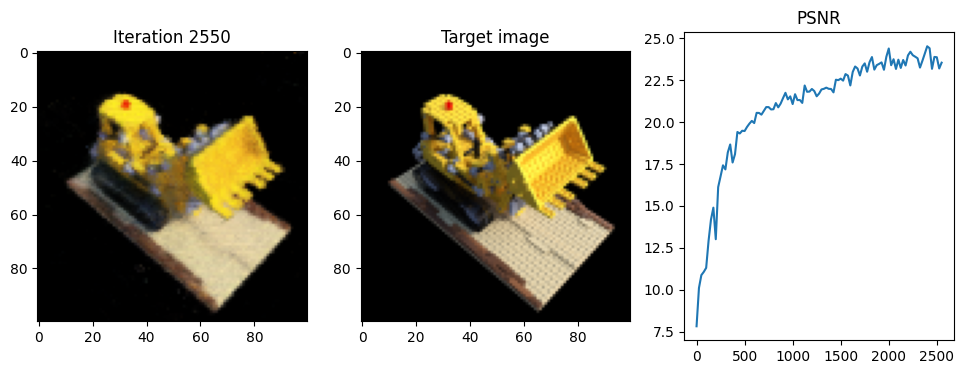

Iteration 2575  Loss: 0.0040  PSNR: 23.96  Time: 1.00 secs per iter,  44.86 mins in total


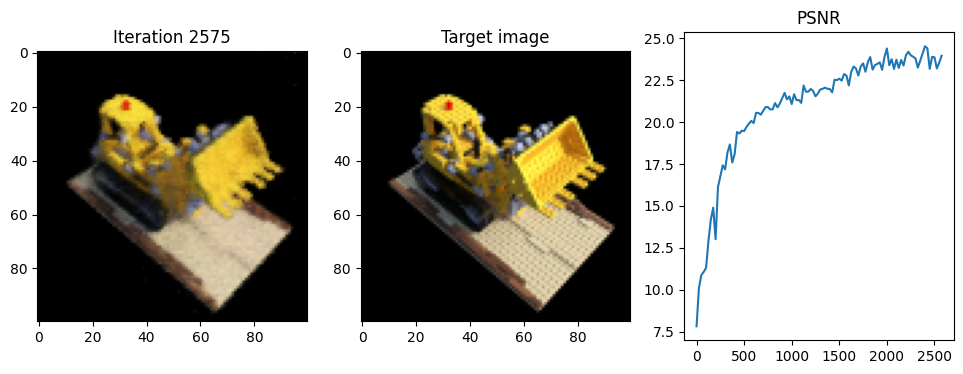

Iteration 2600  Loss: 0.0037  PSNR: 24.27  Time: 1.00 secs per iter,  45.27 mins in total


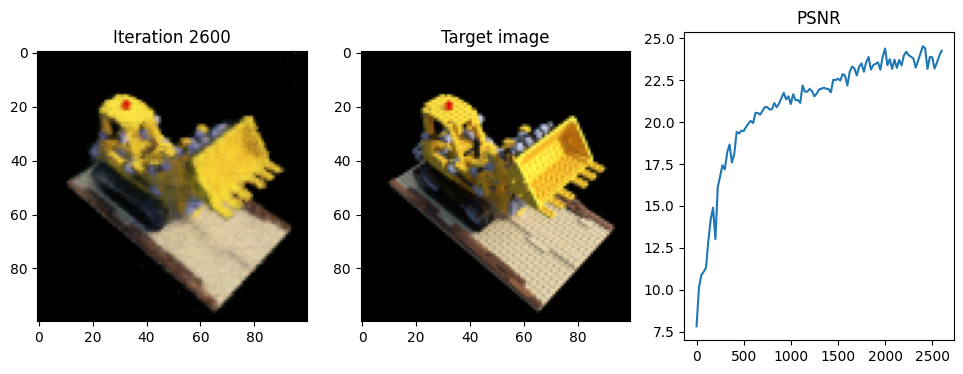

Iteration 2625  Loss: 0.0038  PSNR: 24.20  Time: 1.00 secs per iter,  45.69 mins in total


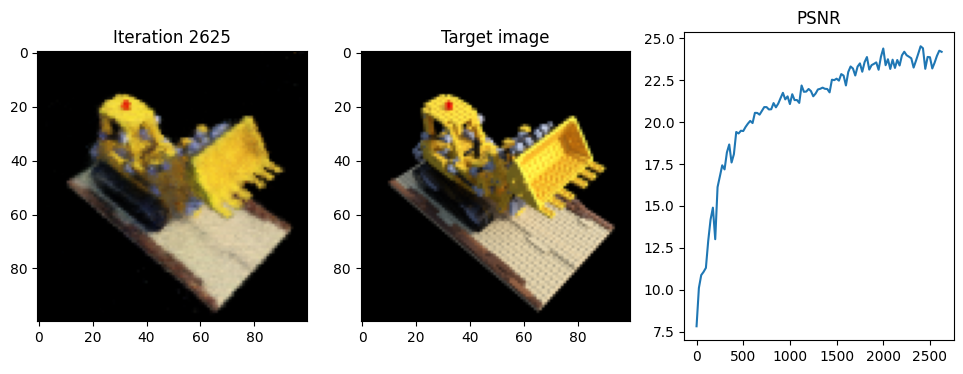

Iteration 2650  Loss: 0.0035  PSNR: 24.56  Time: 1.01 secs per iter,  46.11 mins in total


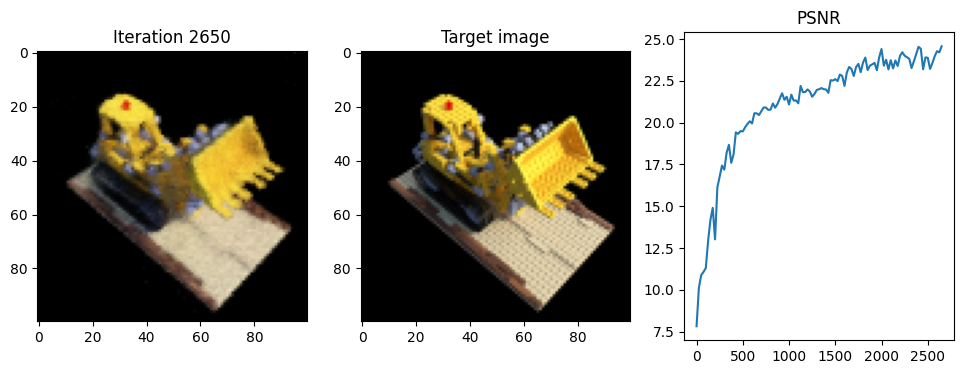

Iteration 2675  Loss: 0.0038  PSNR: 24.15  Time: 1.00 secs per iter,  46.53 mins in total


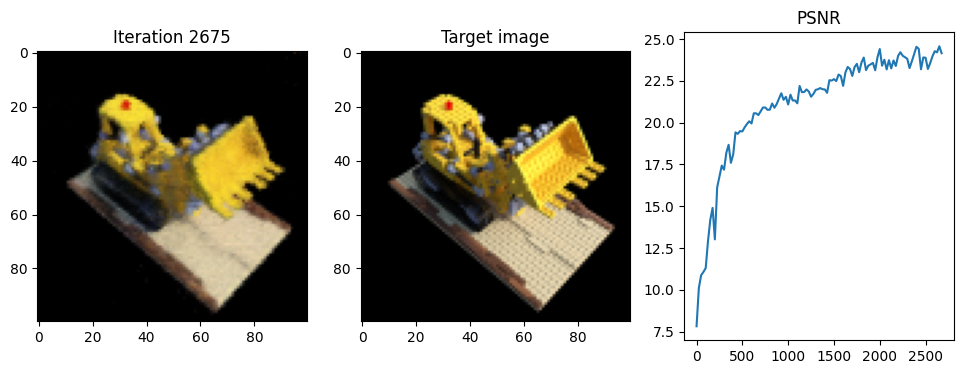

Iteration 2700  Loss: 0.0035  PSNR: 24.54  Time: 1.00 secs per iter,  46.94 mins in total


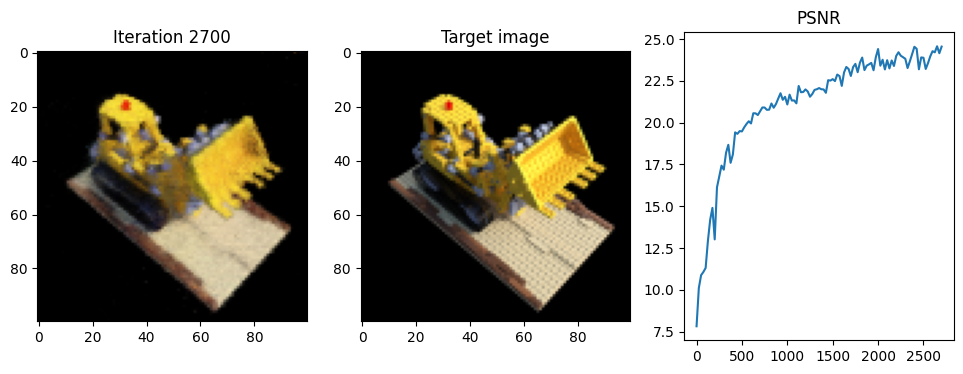

Iteration 2725  Loss: 0.0037  PSNR: 24.27  Time: 1.00 secs per iter,  47.36 mins in total


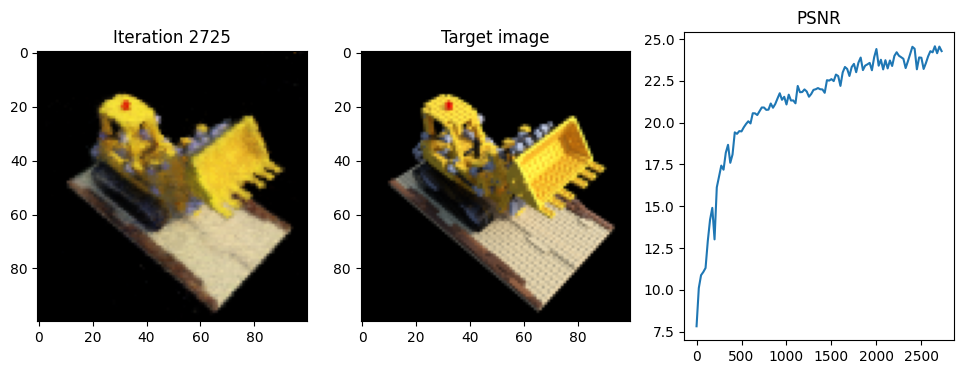

Iteration 2750  Loss: 0.0036  PSNR: 24.44  Time: 1.00 secs per iter,  47.77 mins in total


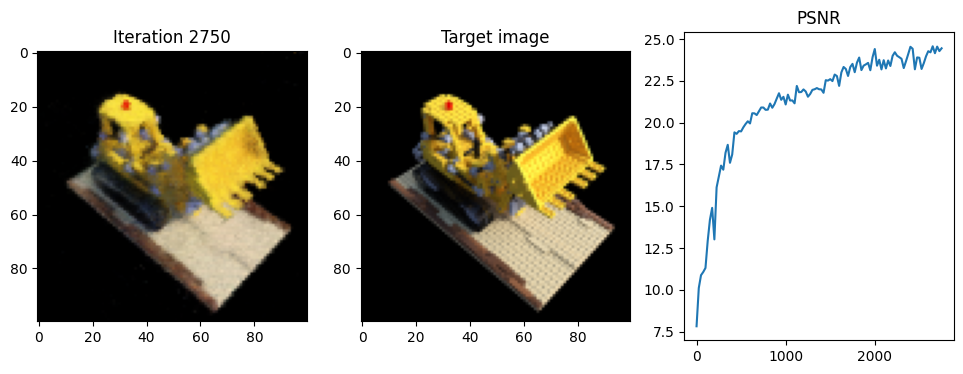

Iteration 2775  Loss: 0.0039  PSNR: 24.13  Time: 1.00 secs per iter,  48.19 mins in total


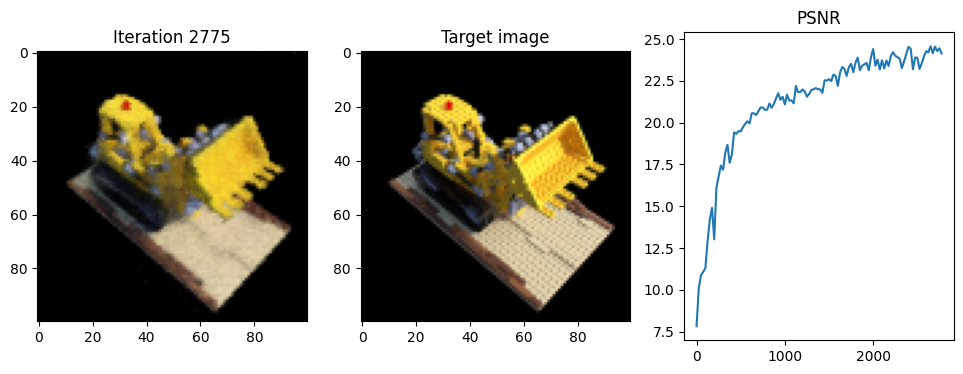

Iteration 2800  Loss: 0.0033  PSNR: 24.79  Time: 1.00 secs per iter,  48.60 mins in total


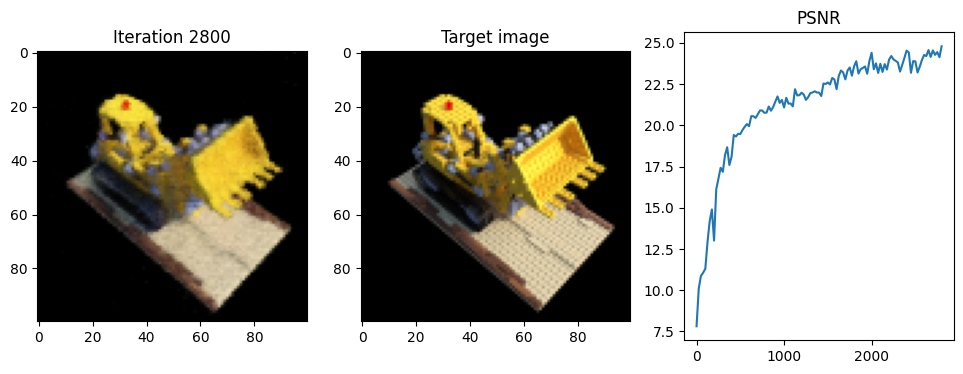

Iteration 2825  Loss: 0.0033  PSNR: 24.87  Time: 1.00 secs per iter,  49.02 mins in total


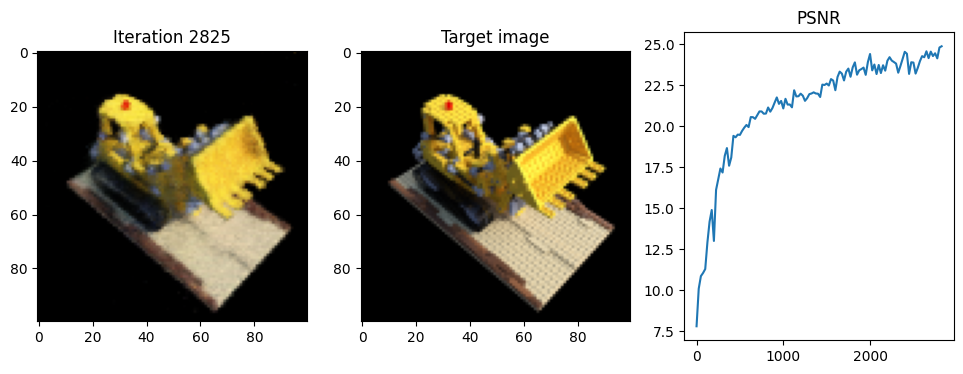

Iteration 2850  Loss: 0.0042  PSNR: 23.80  Time: 1.00 secs per iter,  49.44 mins in total


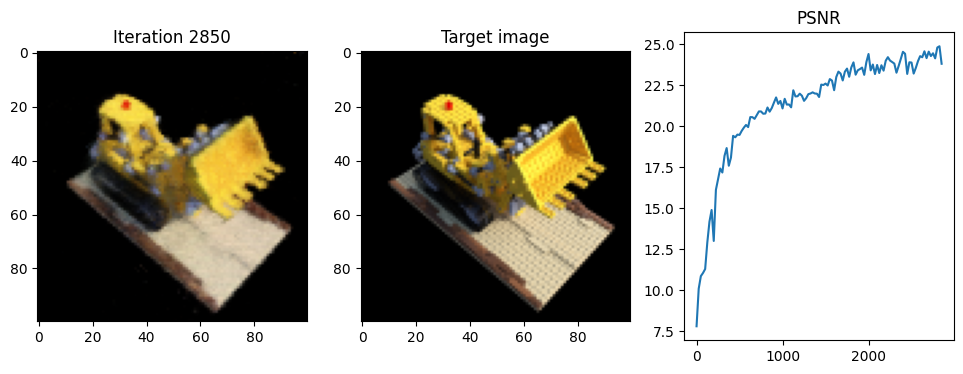

Iteration 2875  Loss: 0.0034  PSNR: 24.72  Time: 1.00 secs per iter,  49.85 mins in total


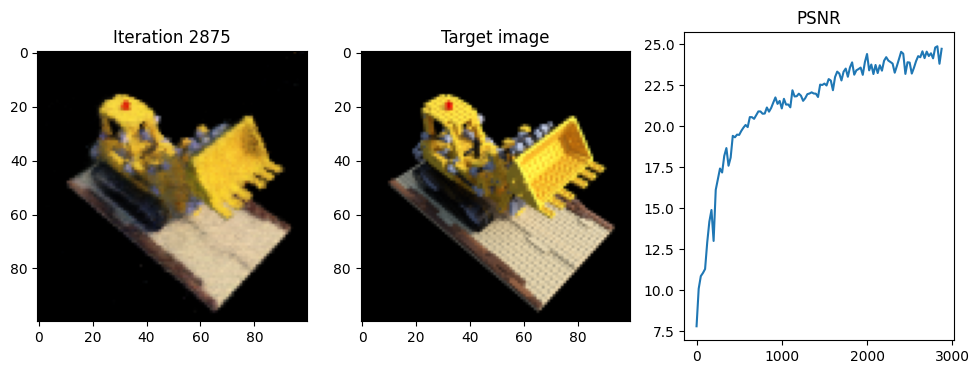

Iteration 2900  Loss: 0.0033  PSNR: 24.76  Time: 1.01 secs per iter,  50.27 mins in total


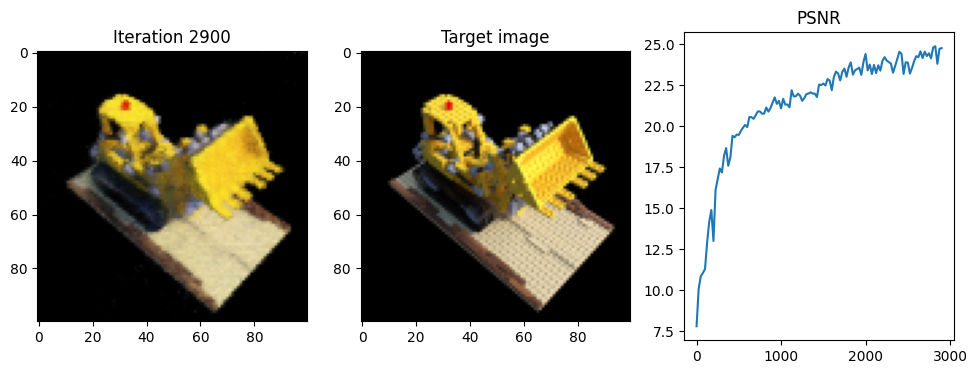

Iteration 2925  Loss: 0.0047  PSNR: 23.27  Time: 1.01 secs per iter,  50.69 mins in total


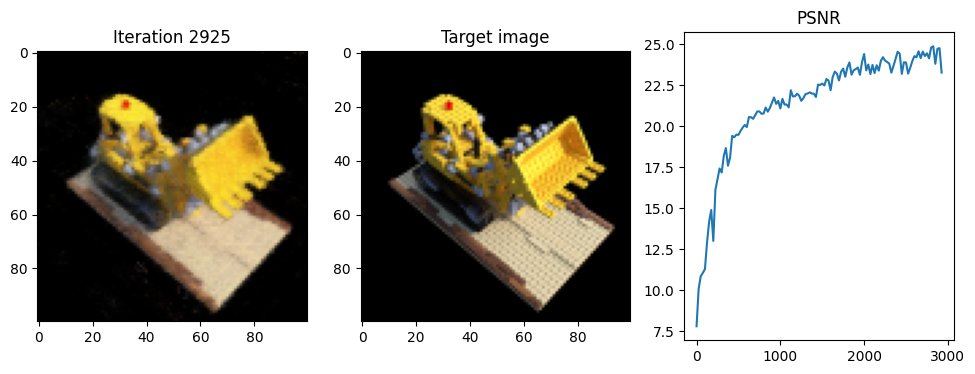

Iteration 2950  Loss: 0.0035  PSNR: 24.50  Time: 1.00 secs per iter,  51.11 mins in total


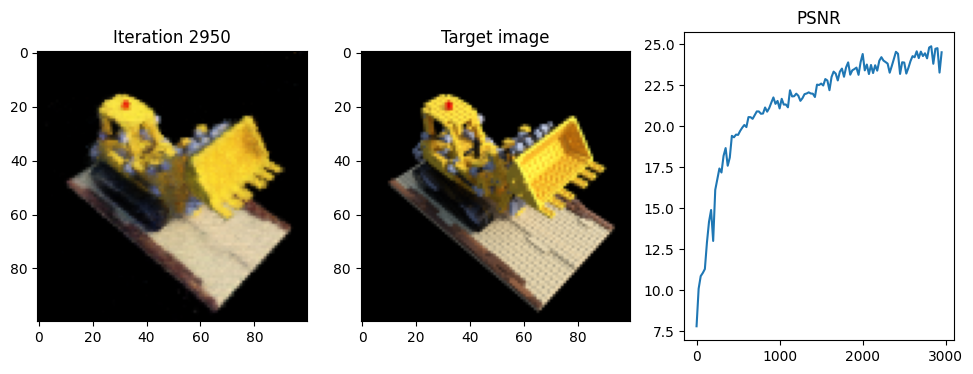

Iteration 2975  Loss: 0.0039  PSNR: 24.05  Time: 1.00 secs per iter,  51.52 mins in total


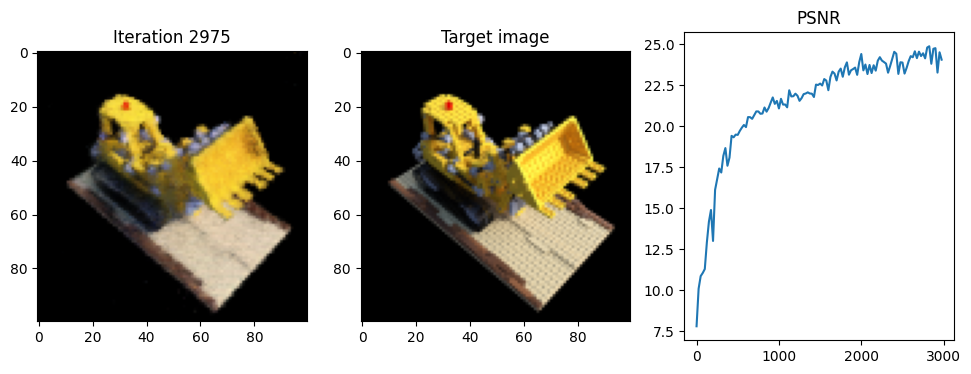

Iteration 3000  Loss: 0.0035  PSNR: 24.52  Time: 1.00 secs per iter,  51.94 mins in total


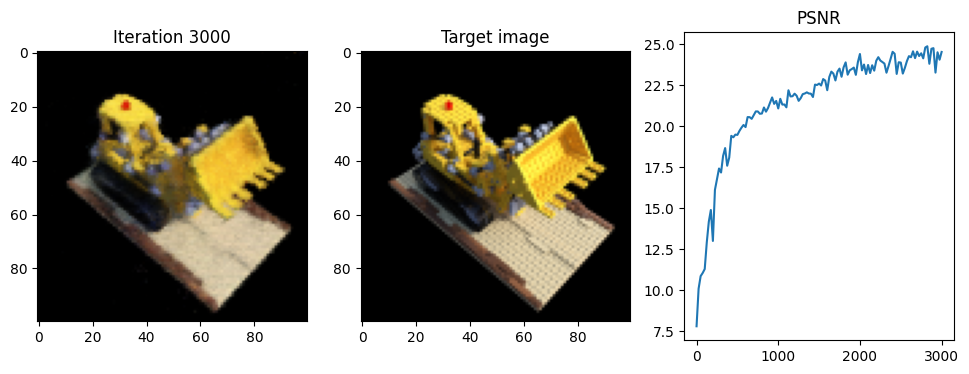

Done!


In [ ]:
for i in range(iterations+1):

    #############################  TODO 2.6 BEGIN  ############################

    #choose randomly a picture for the forward pass
    random_index = random.randint(0,len(images)-1)

    random_image, random_pose = images[random_index], poses[random_index]
    random_image = random_image.to(device)
    random_pose = random_pose.to(device)


    # Run one iteration of NeRF and get the rendered RGB image.
    rec_image = one_forward_pass(height, width, intrinsics, random_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)


    # Compute mean-squared error between the predicted and target images. Backprop!
    loss = criterion(rec_image, random_image)
    loss.backward()
    optimizer.step()

    optimizer.zero_grad()
    torch.cuda.empty_cache()

    #############################  TODO 2.6 END  ############################
    if i % 500 == 0:
      torch.save(model.state_dict(), '/content/drive/MyDrive/NeRF/nerf_{}.pth'.format(i) )
      torch.cuda.empty_cache()

    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        #############################  TODO 2.6 BEGIN  ############################
            # Render the held-out view
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)
            loss = criterion(test_rec_image, test_image)


        #calculate the loss and the psnr between the original test image and the reconstructed one.
        psnr = 10 * torch.log10(1./ loss)

        #############################  TODO 2.6 END  ############################

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

print('Done!')

###Testing our Model

In [20]:
import gc
gc.collect()
torch.cuda.empty_cache()
gc.collect()


0

In [15]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)
!cp '/content/drive/MyDrive/NeRF/nerf_final.pth' '/content/nerf_final.pth'
model.load_state_dict(torch.load('/content/nerf_final.pth', map_location=torch.device(device)))
model.eval()

nerf_model(
  (fc1): Linear(in_features=63, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=256, bias=True)
  (fc3): Linear(in_features=256, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=256, bias=True)
  (fc5): Linear(in_features=256, out_features=256, bias=True)
  (fc6): Linear(in_features=319, out_features=256, bias=True)
  (fc7): Linear(in_features=256, out_features=256, bias=True)
  (fc8): Linear(in_features=256, out_features=256, bias=True)
  (fc9): Linear(in_features=256, out_features=1, bias=True)
  (fc10): Linear(in_features=256, out_features=256, bias=True)
  (fc11): Linear(in_features=283, out_features=128, bias=True)
  (fc12): Linear(in_features=128, out_features=3, bias=True)
  (relu): ReLU()
  (sigmoid): Sigmoid()
)

tensor([[-7.2321e-01,  2.7935e-01, -6.3160e-01,  8.4869e-01],
        [ 6.9062e-01,  2.9253e-01, -6.6141e-01,  8.8874e-01],
        [-1.4901e-08, -9.1454e-01, -4.0449e-01,  5.4352e-01],
        [ 0.0000e+00, -0.0000e+00, -0.0000e+00,  1.0000e+00]], device='cuda:0')
Volumetric = cpu
tensor(0., grad_fn=<MinBackward1>)


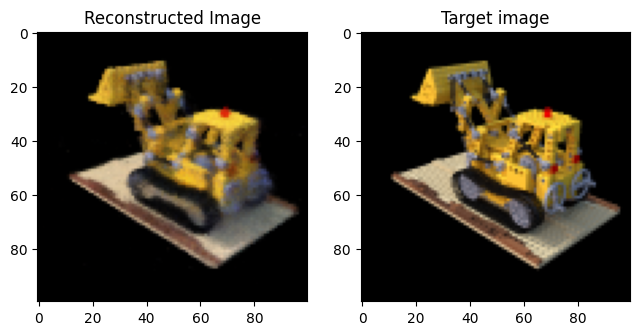

In [18]:
trial_image, trial_pose = images[74], poses[74]
print(trial_pose)

rec_image = one_forward_pass(height, width, intrinsics, trial_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)
torch.cuda.empty_cache()
print(rec_image.min())
plt.figure(figsize=(16, 4))
plt.subplot(141)
plt.imshow(rec_image.detach().cpu().numpy())
plt.title("Reconstructed Image")
plt.subplot(142)
plt.imshow(trial_image.detach().cpu().numpy())
plt.title("Target image")
plt.show()

Volumetric = cpu


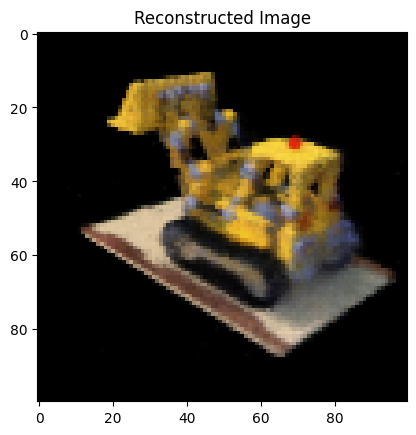

Volumetric = cpu


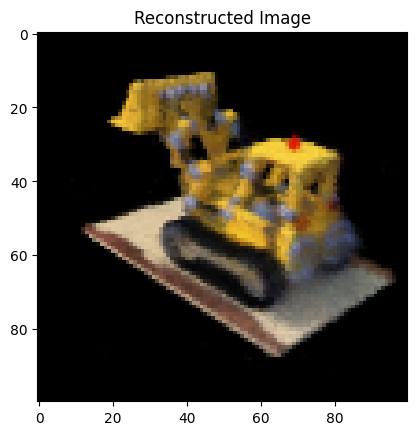

Volumetric = cpu


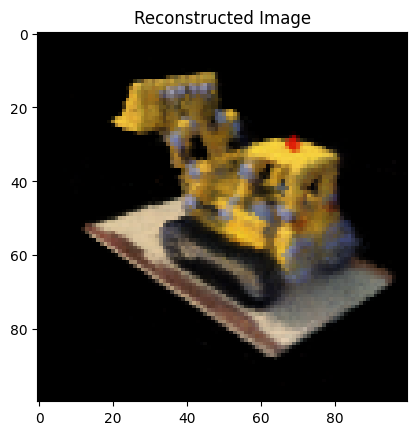

Volumetric = cpu


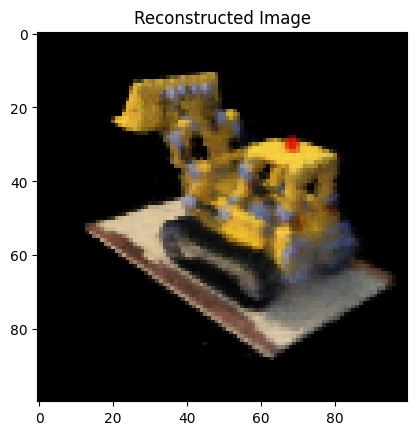

Volumetric = cpu


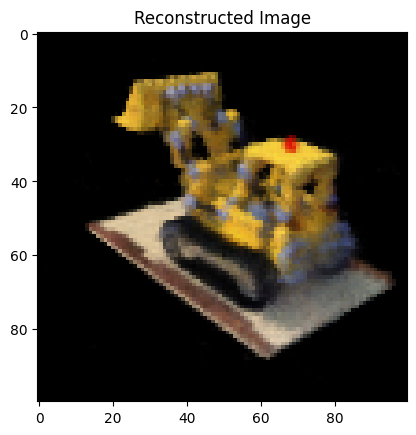

Volumetric = cpu


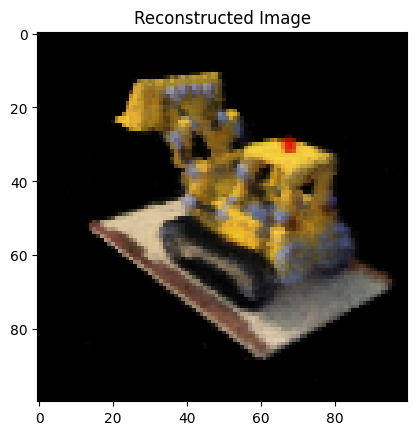

Volumetric = cpu


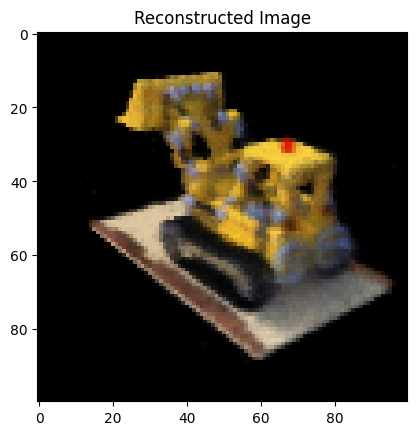

Volumetric = cpu


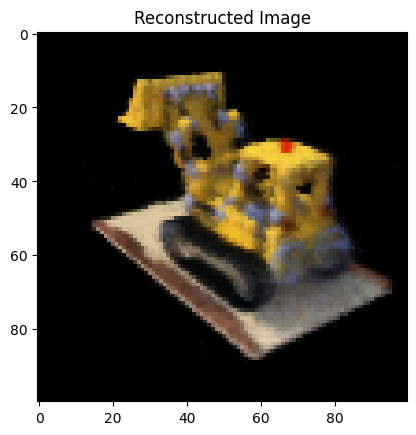

Volumetric = cpu


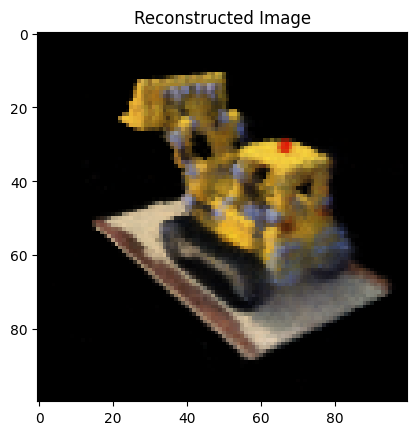

Volumetric = cpu


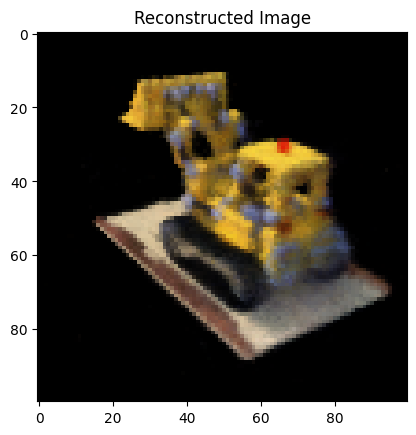

Volumetric = cpu


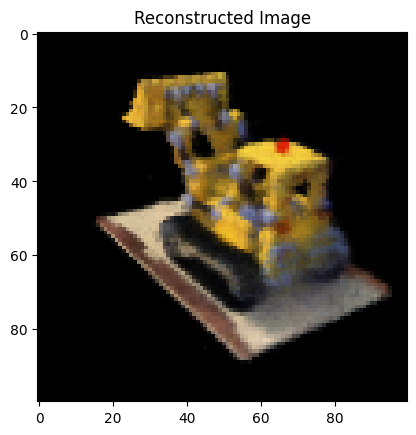

Volumetric = cpu


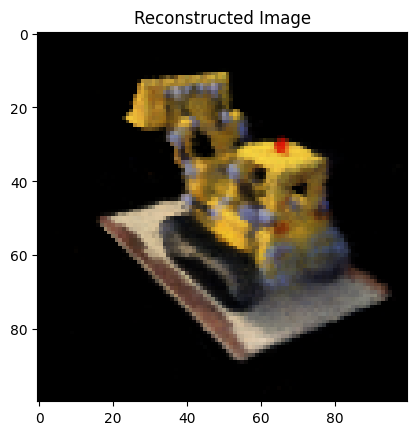

Volumetric = cpu


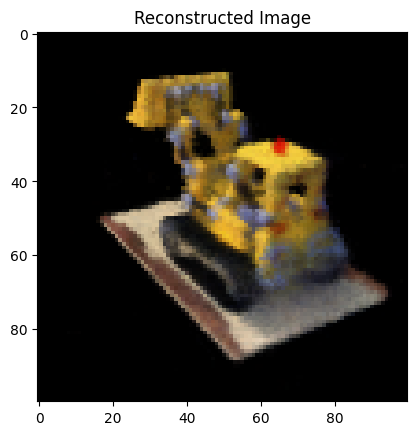

Volumetric = cpu


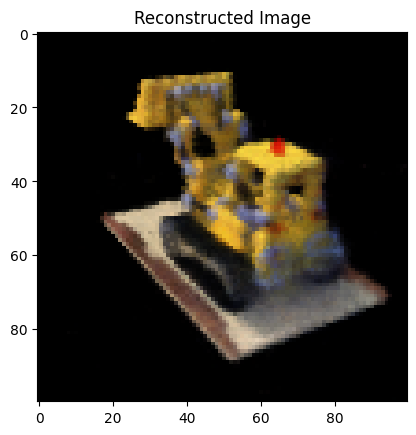

Volumetric = cpu


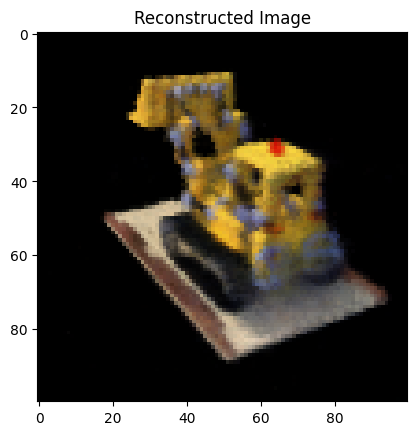

Volumetric = cpu


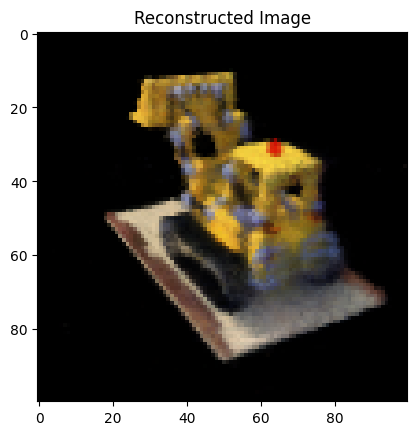

Volumetric = cpu


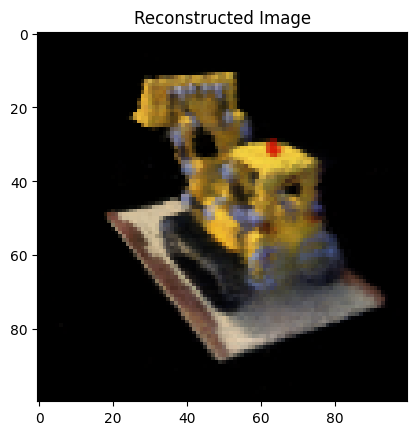

Volumetric = cpu


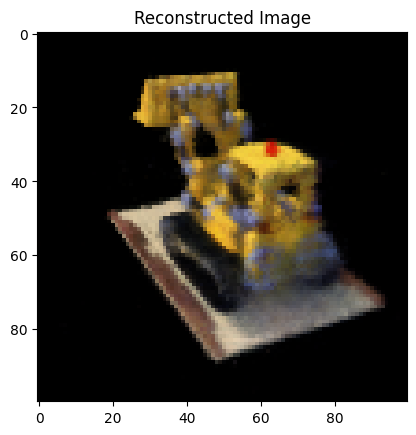

Volumetric = cpu


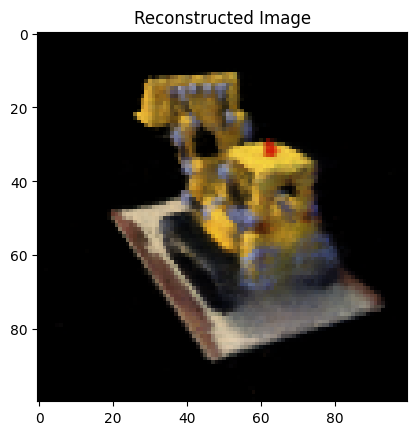

Volumetric = cpu


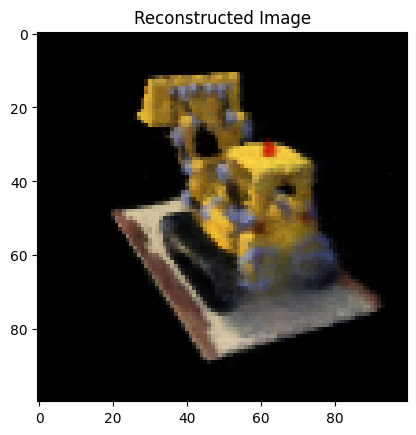

Volumetric = cpu


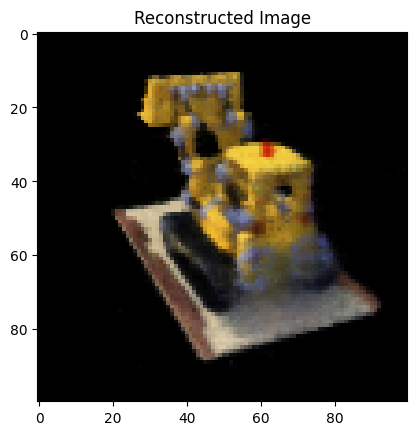

Volumetric = cpu


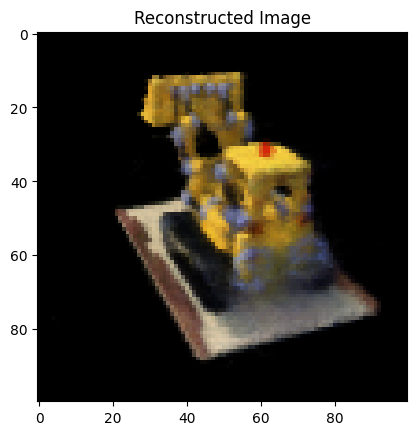

Volumetric = cpu


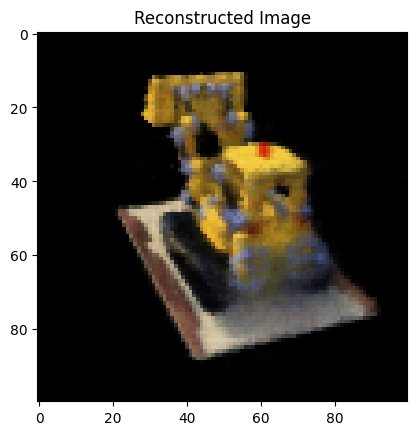

Volumetric = cpu


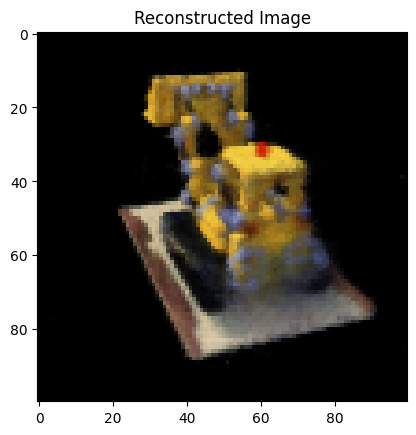

Volumetric = cpu


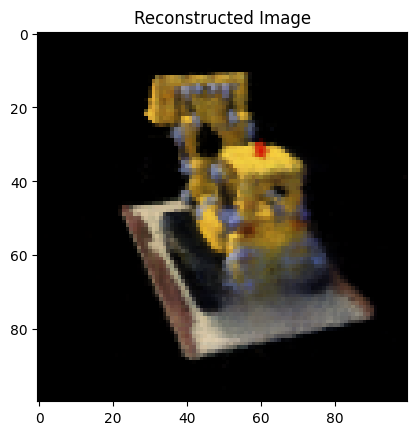

Volumetric = cpu


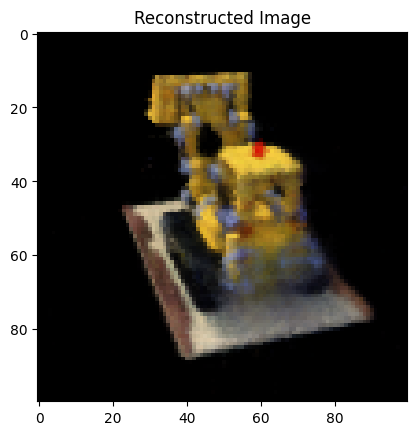

Volumetric = cpu


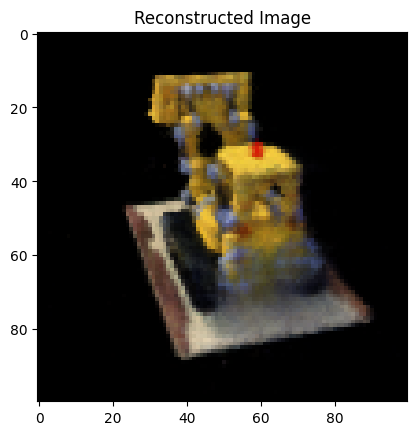

Volumetric = cpu


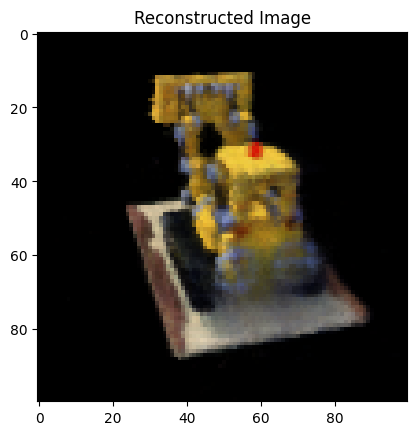

Volumetric = cpu


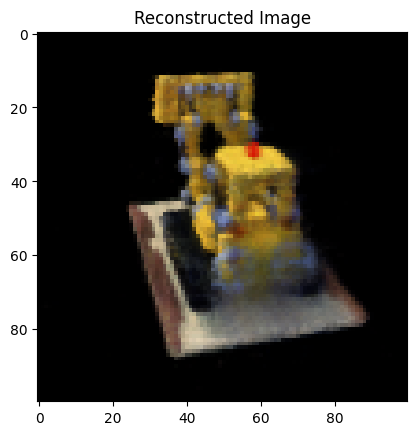

Volumetric = cpu


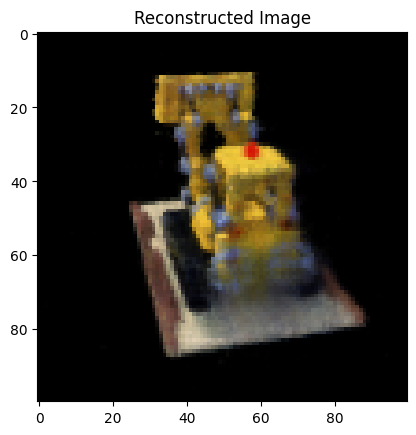

Volumetric = cpu


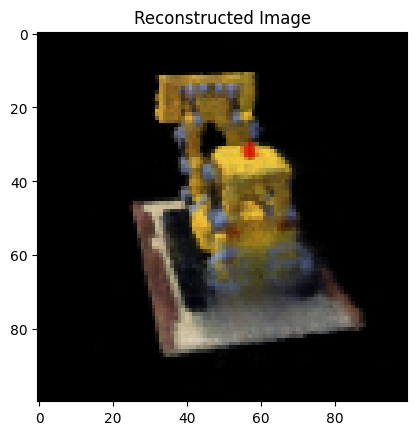

Volumetric = cpu


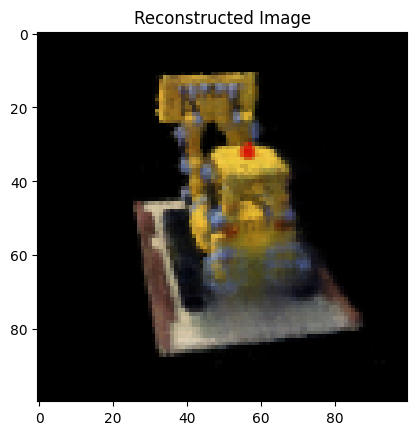

Volumetric = cpu


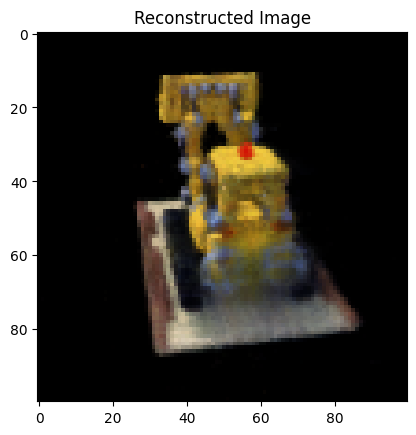

Volumetric = cpu


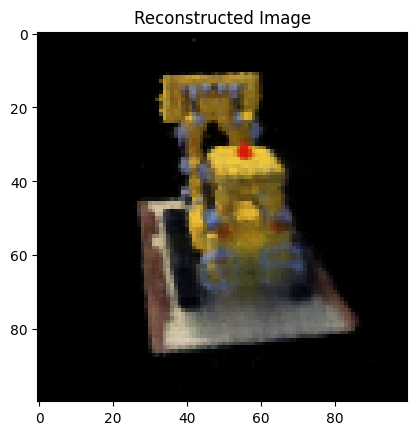

Volumetric = cpu


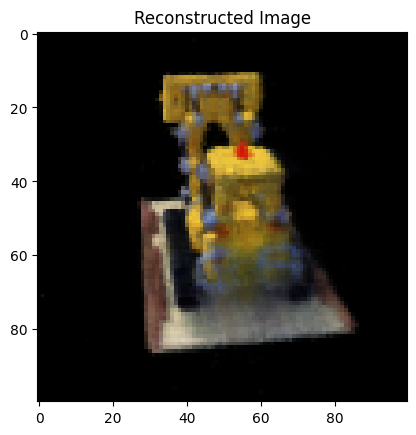

Volumetric = cpu


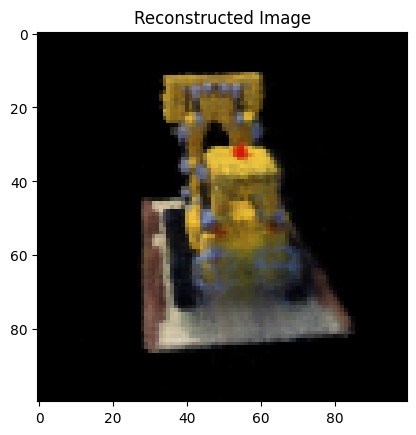

Volumetric = cpu


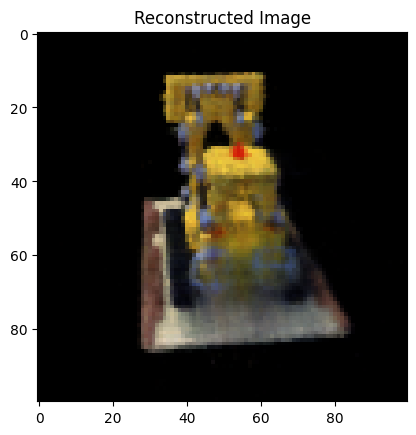

Volumetric = cpu


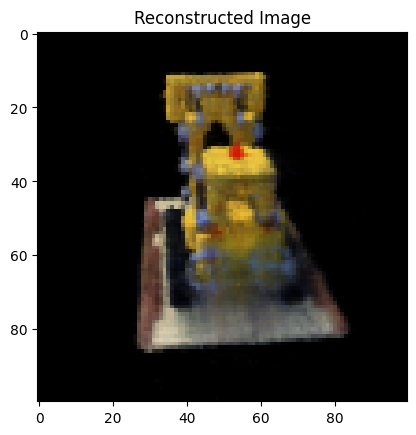

Volumetric = cpu


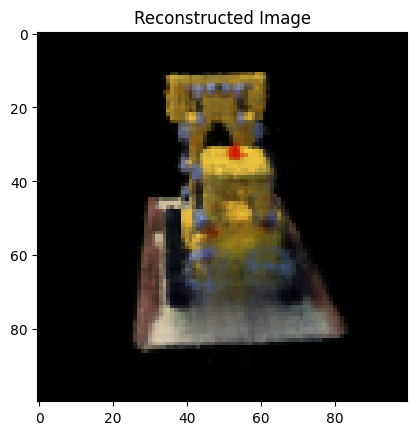

Volumetric = cpu


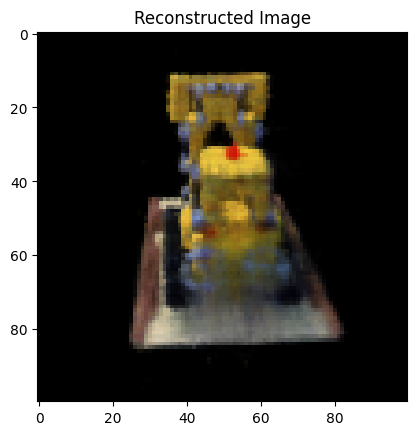

Volumetric = cpu


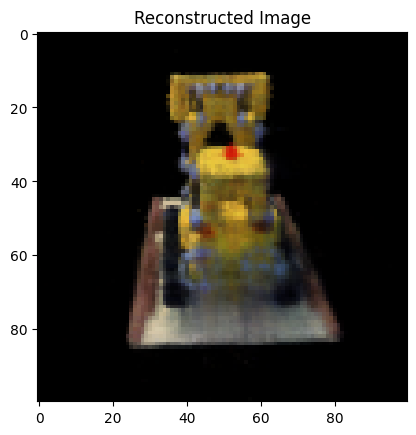

Volumetric = cpu


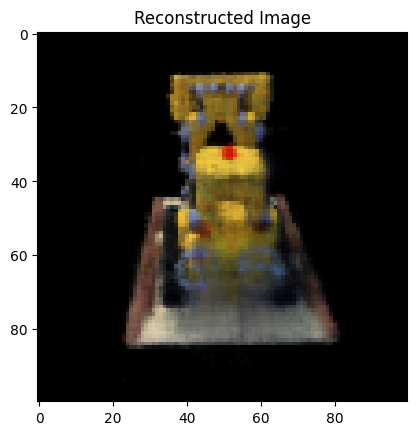

Volumetric = cpu


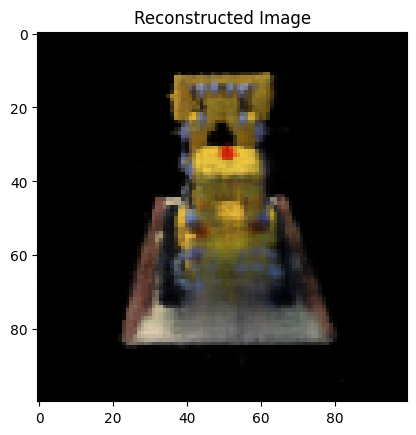

Volumetric = cpu


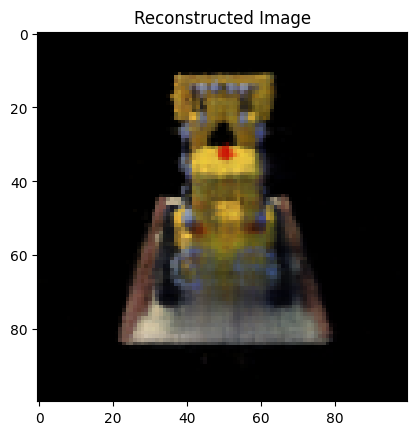

Volumetric = cpu


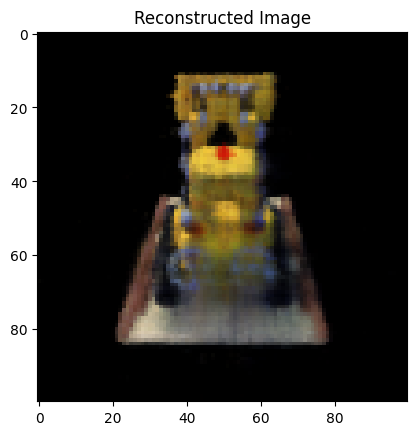

Volumetric = cpu


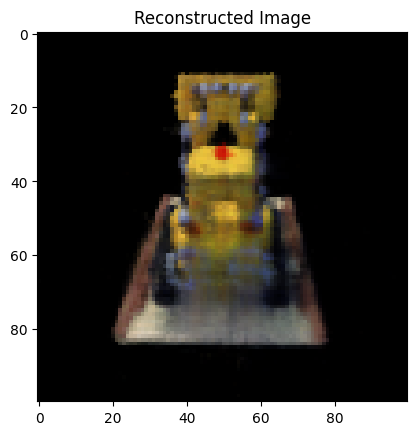

Volumetric = cpu


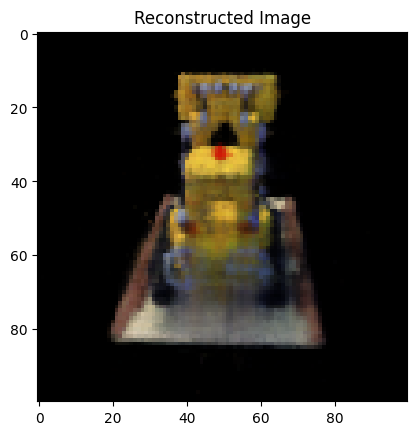

Volumetric = cpu


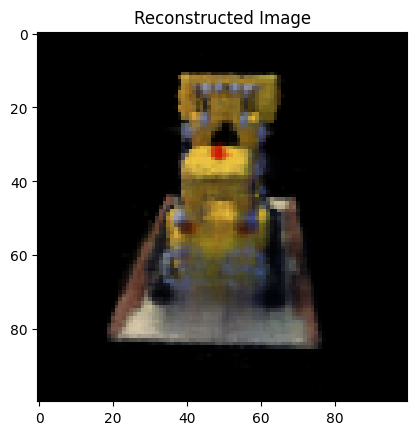

Volumetric = cpu


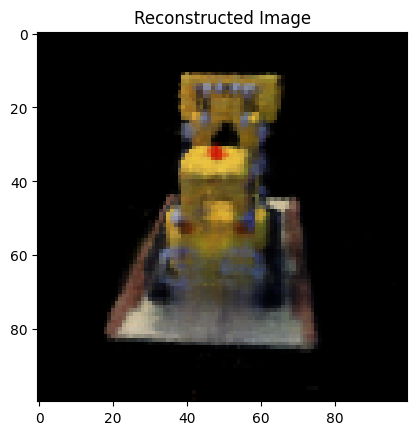

Volumetric = cpu


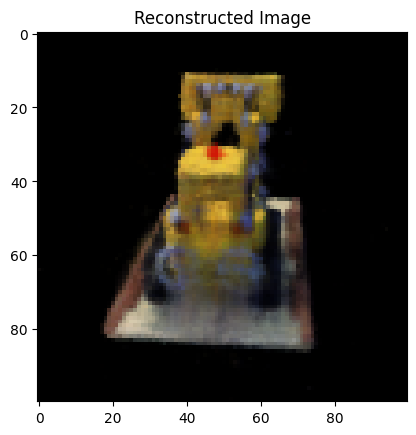

Volumetric = cpu


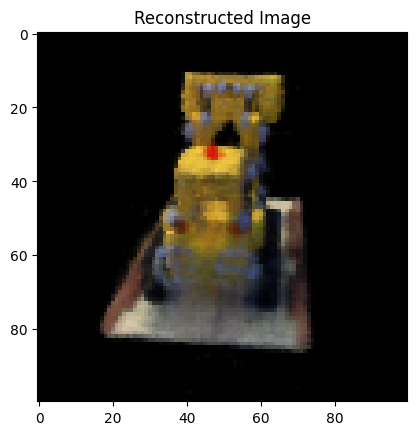

Volumetric = cpu


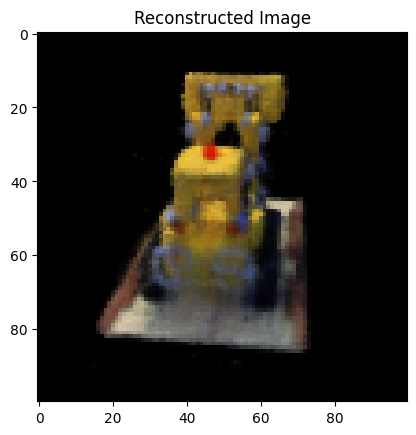

Volumetric = cpu


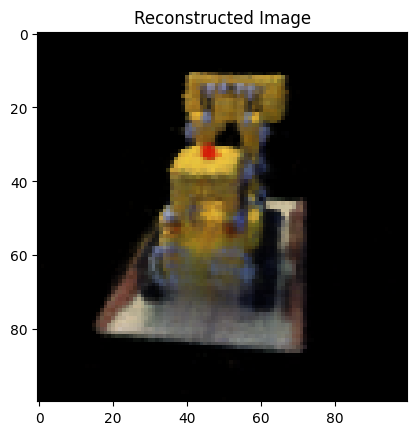

Volumetric = cpu


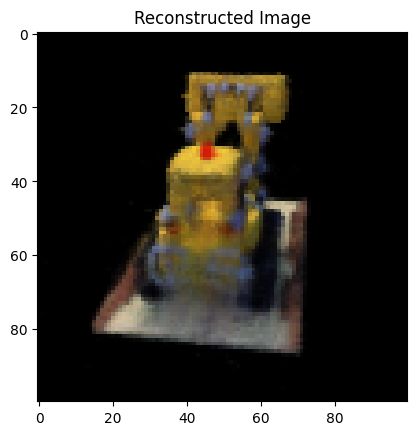

Volumetric = cpu


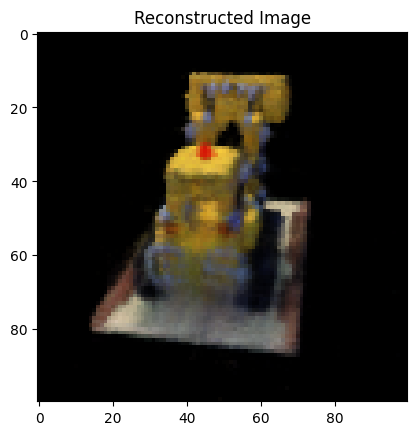

Volumetric = cpu


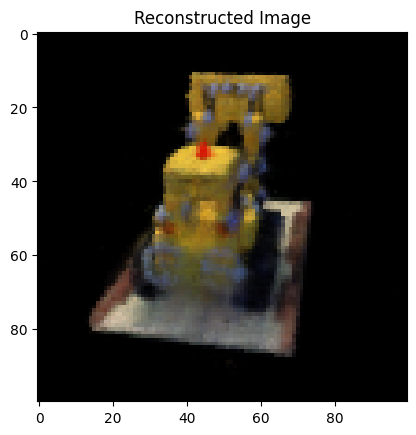

Volumetric = cpu


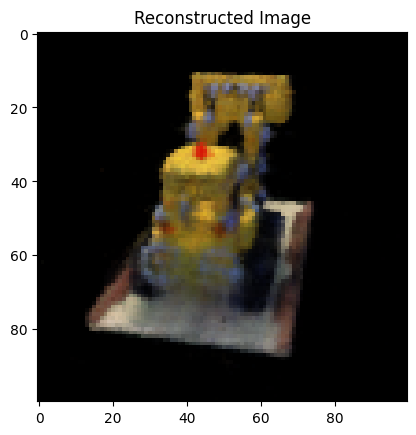

Volumetric = cpu


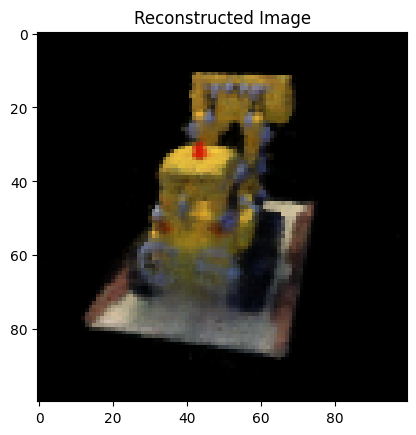

Volumetric = cpu


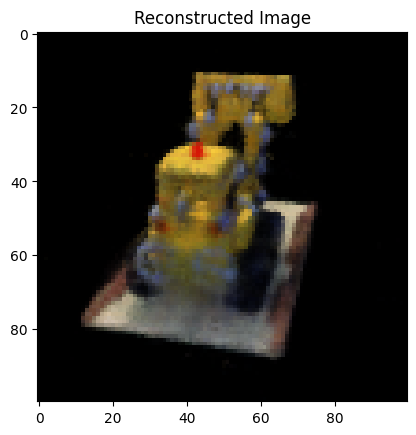

Volumetric = cpu


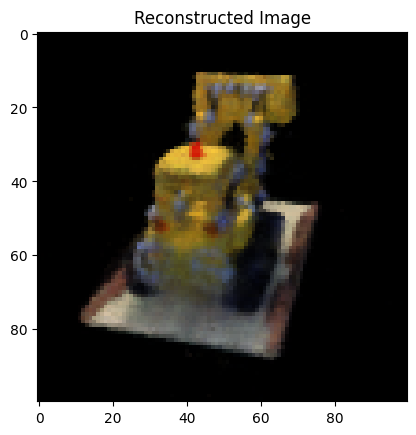

Volumetric = cpu


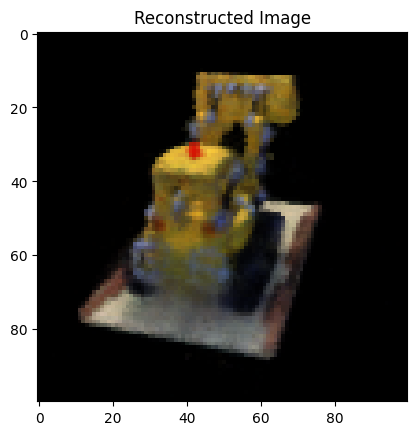

Volumetric = cpu


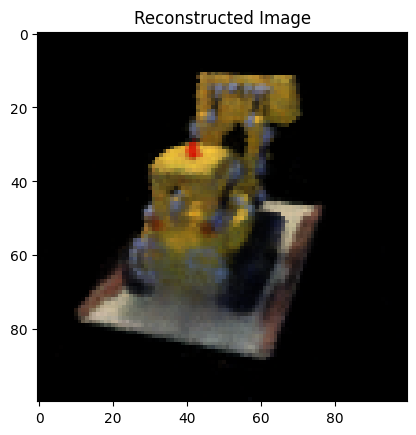

Volumetric = cpu


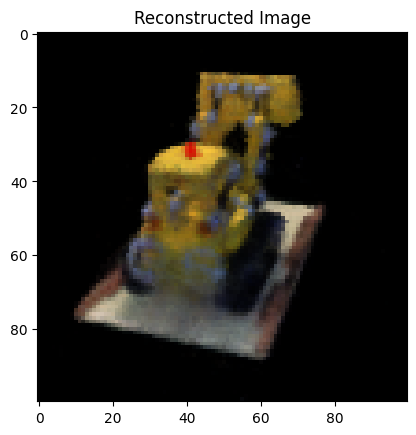

Volumetric = cpu


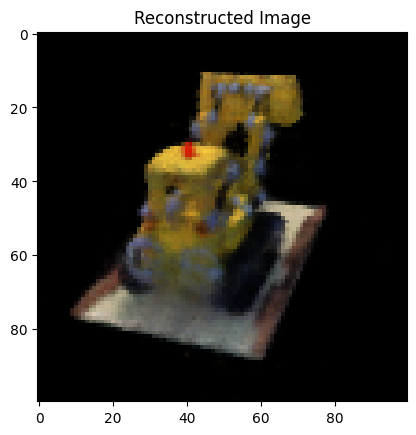

Volumetric = cpu


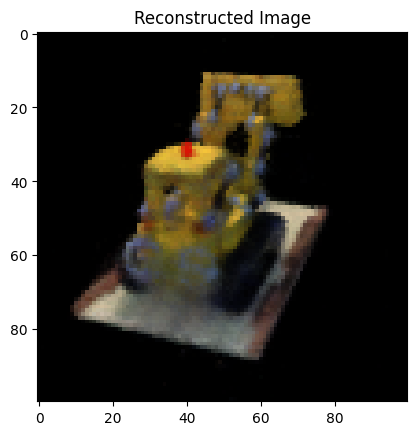

Volumetric = cpu


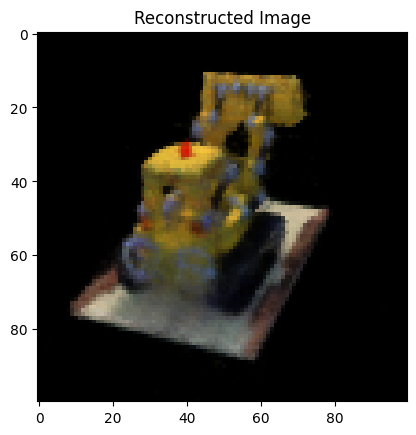

Volumetric = cpu


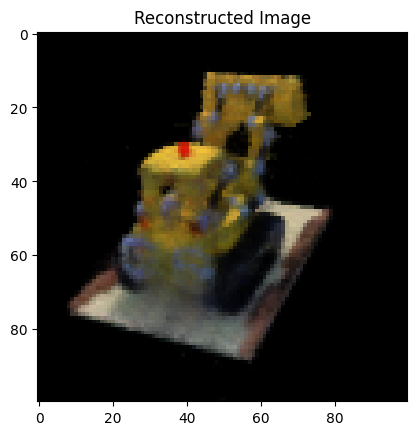

Volumetric = cpu


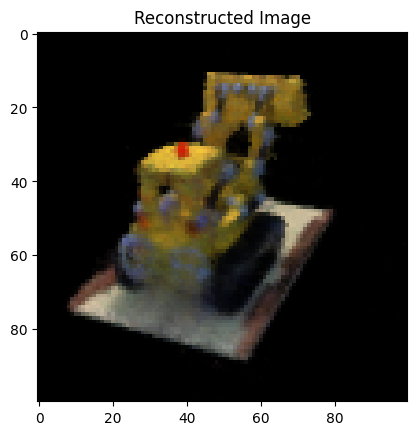

Volumetric = cpu


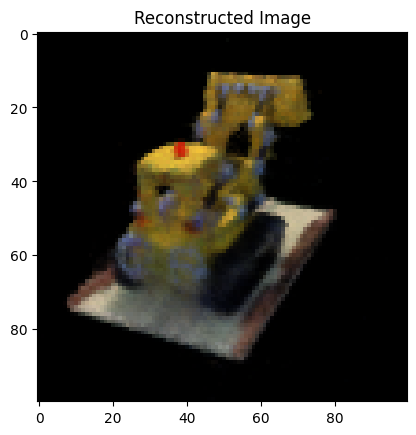

Volumetric = cpu


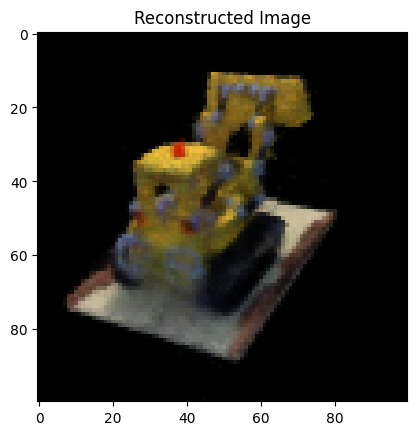

Volumetric = cpu


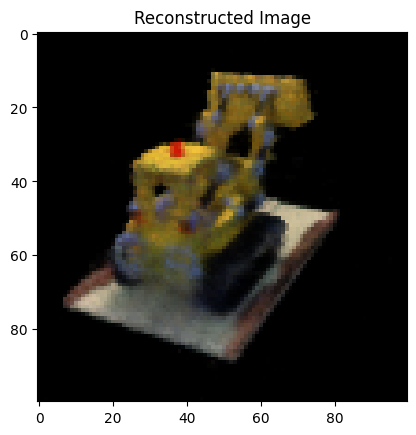

Volumetric = cpu


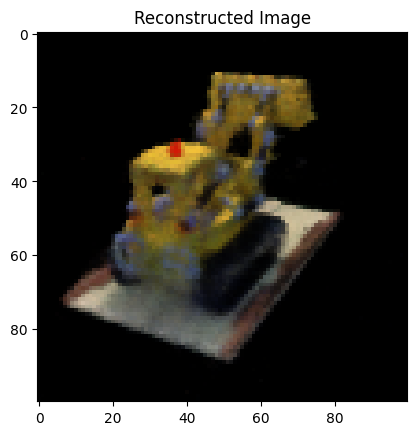

Volumetric = cpu


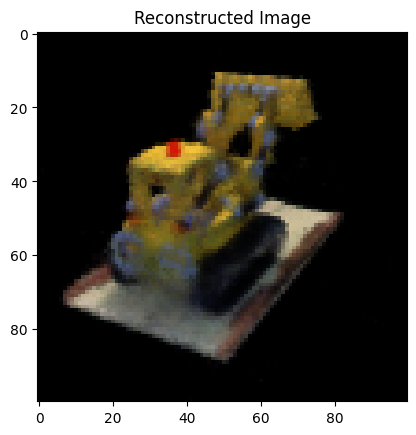

Volumetric = cpu


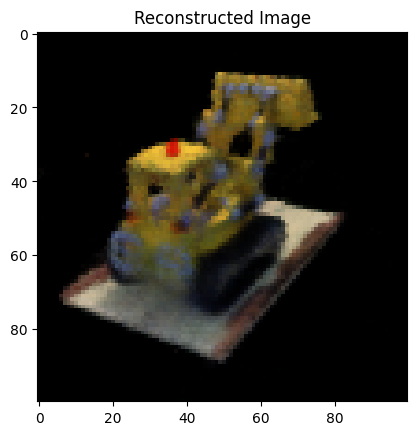

Volumetric = cpu


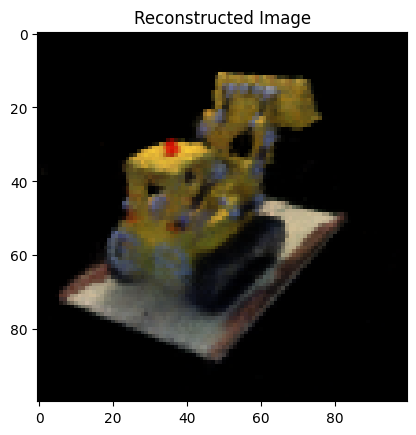

Volumetric = cpu


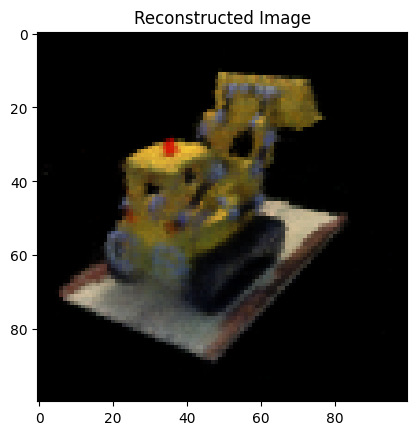

Volumetric = cpu


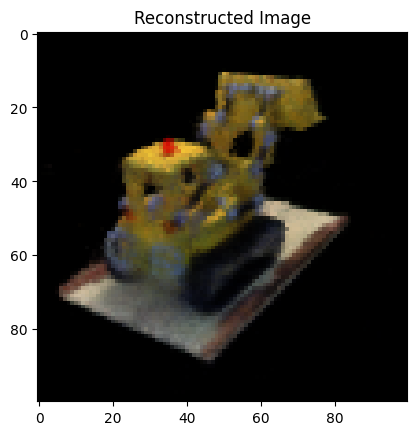

Volumetric = cpu


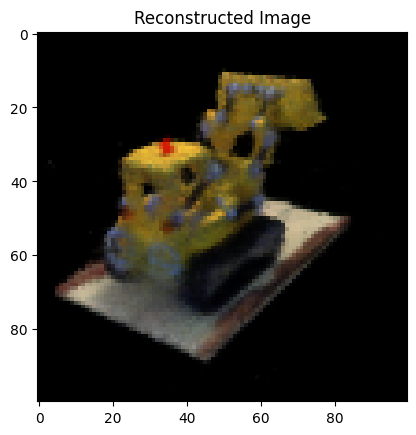

Volumetric = cpu


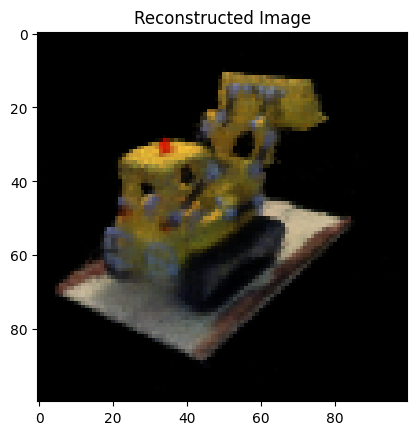

Volumetric = cpu


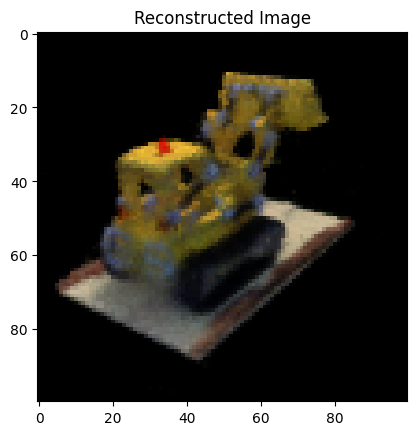

Volumetric = cpu


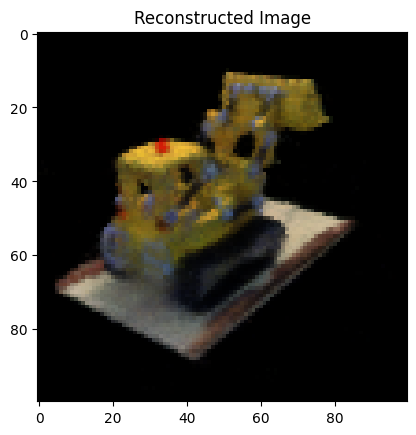

Volumetric = cpu


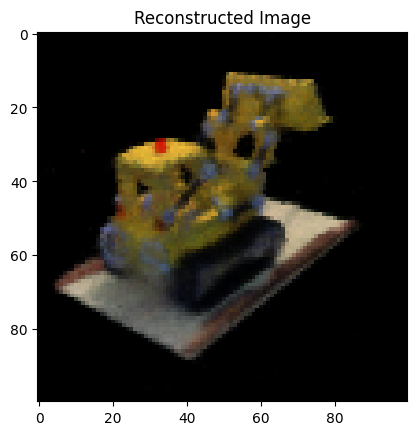

Volumetric = cpu


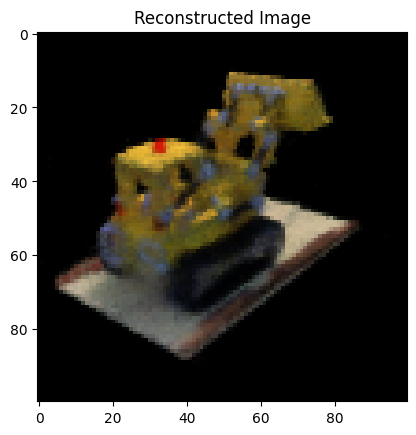

Volumetric = cpu


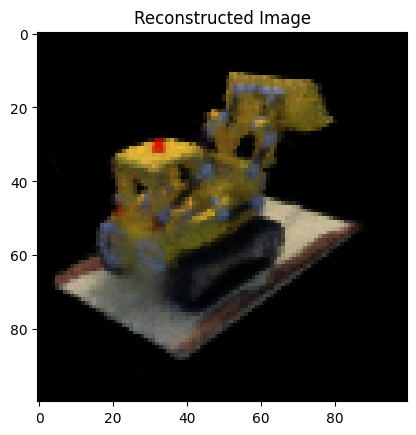

Volumetric = cpu


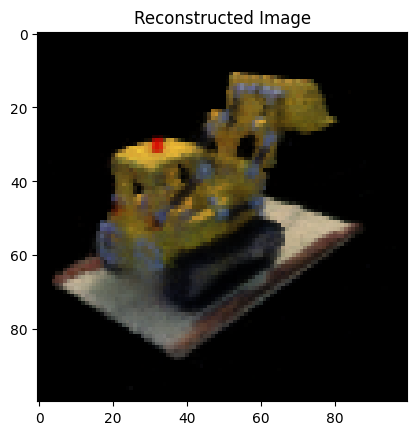

Volumetric = cpu


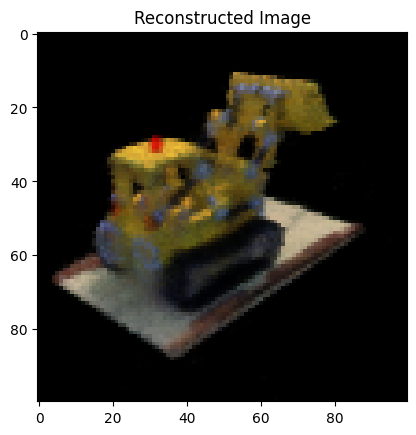

Volumetric = cpu


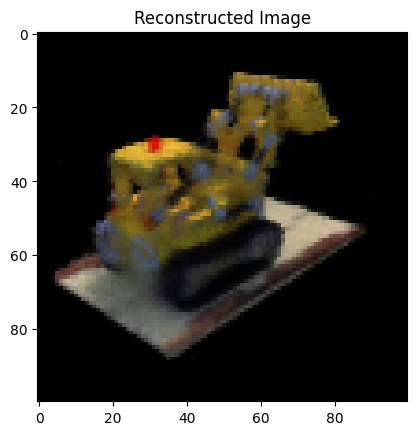

Volumetric = cpu


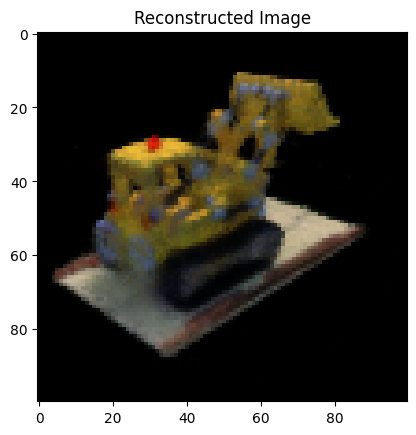

Volumetric = cpu


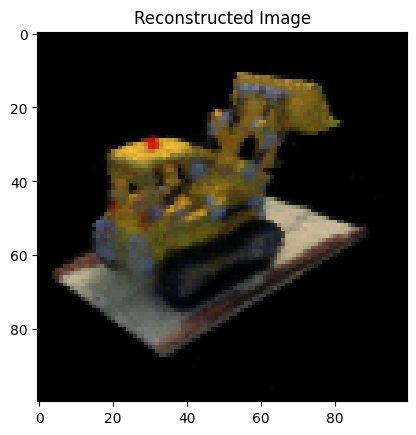

Volumetric = cpu


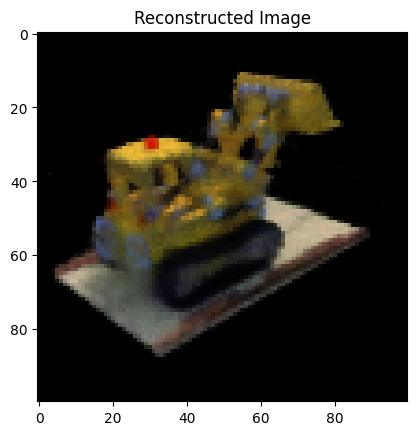

Volumetric = cpu


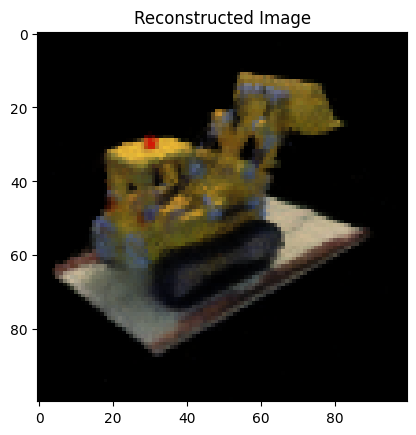

Volumetric = cpu


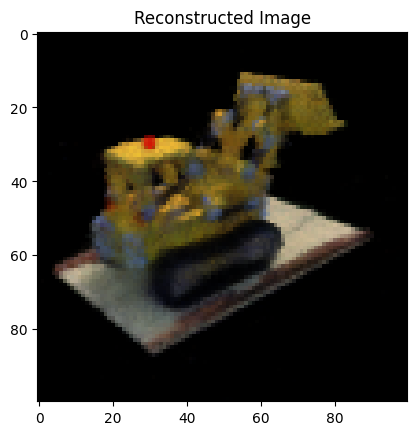

Volumetric = cpu


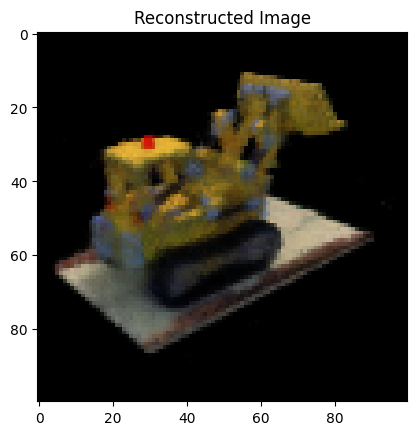

Volumetric = cpu


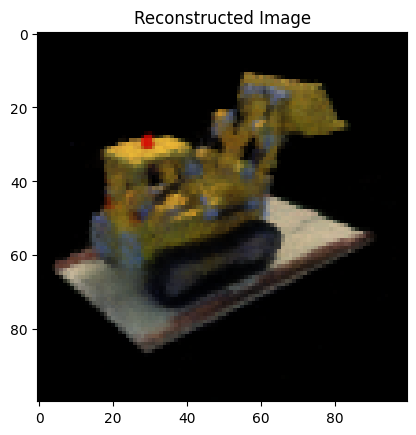

Volumetric = cpu


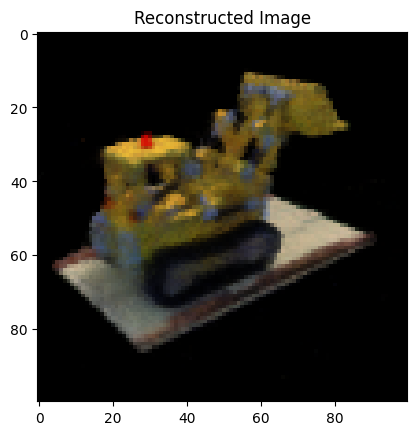

Volumetric = cpu


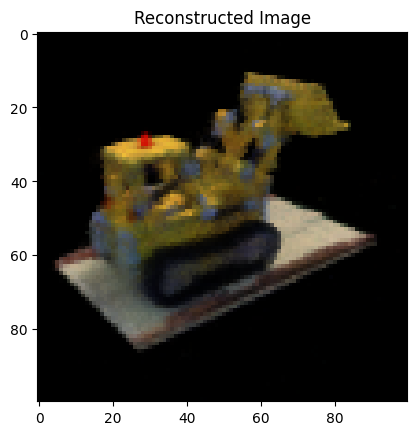

Volumetric = cpu


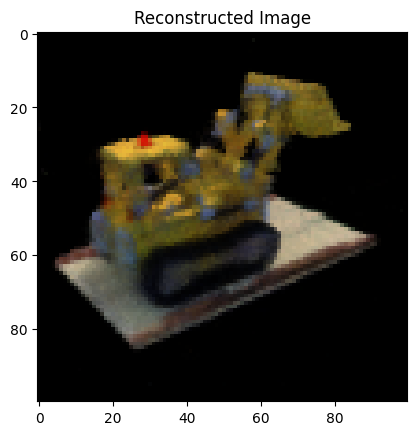

Volumetric = cpu


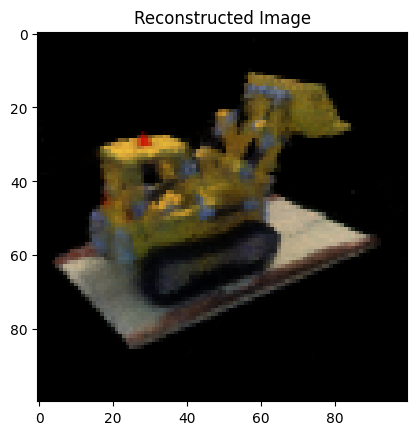

Volumetric = cpu


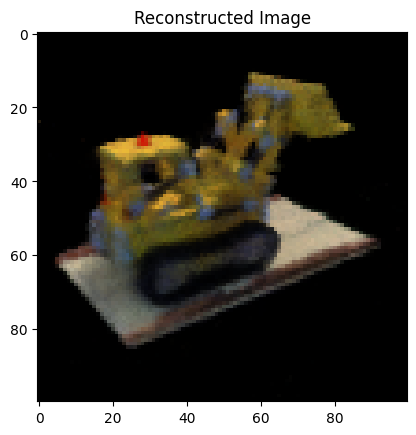

Volumetric = cpu


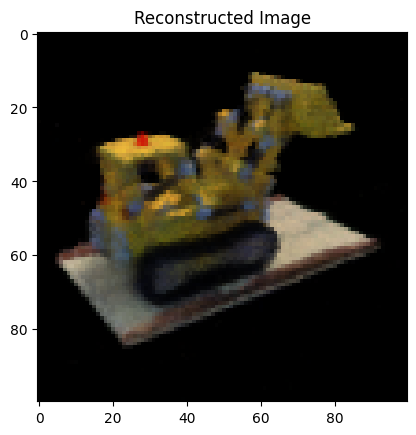

Volumetric = cpu


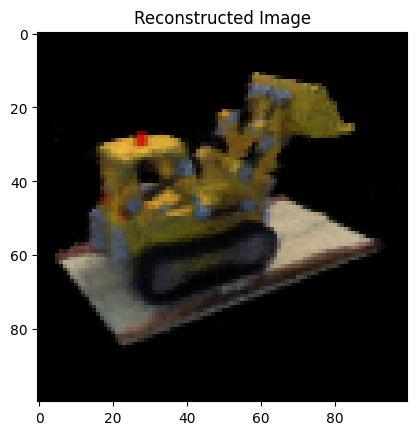

Volumetric = cpu


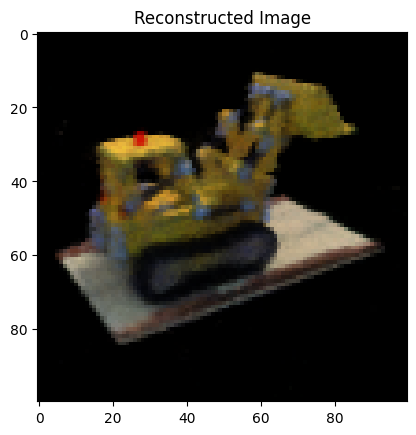

Volumetric = cpu


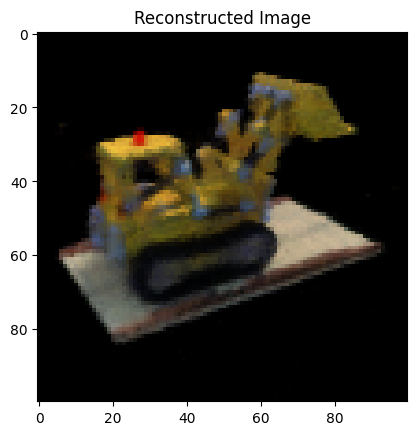

Volumetric = cpu


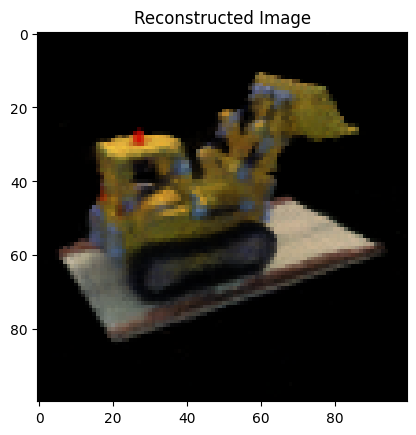

Volumetric = cpu


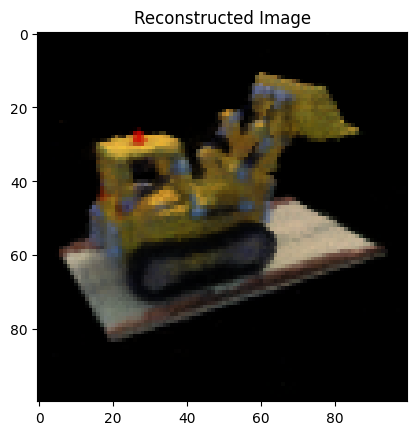

Volumetric = cpu


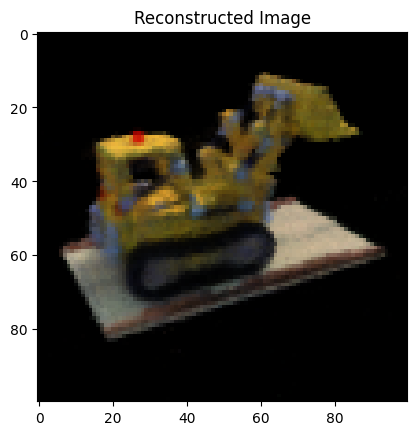

Volumetric = cpu


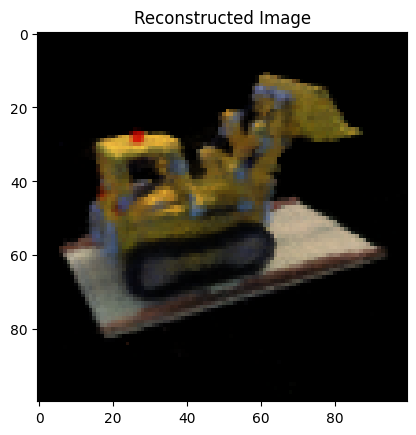

Volumetric = cpu


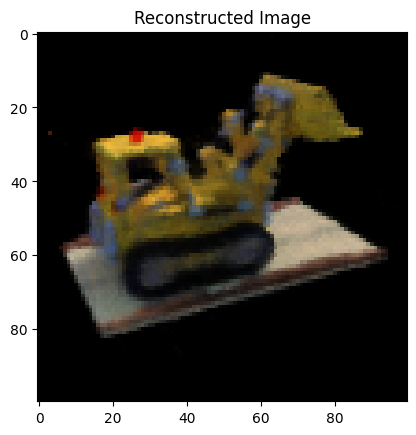

Volumetric = cpu


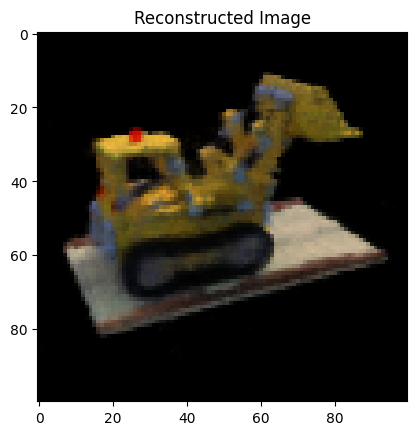

Volumetric = cpu


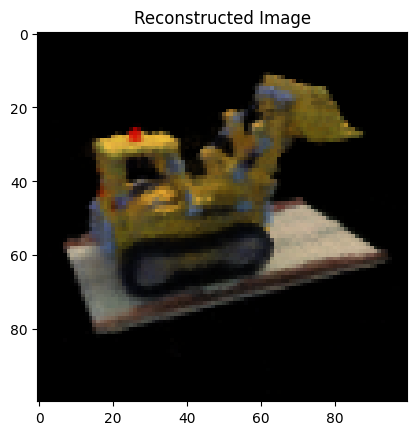

Volumetric = cpu


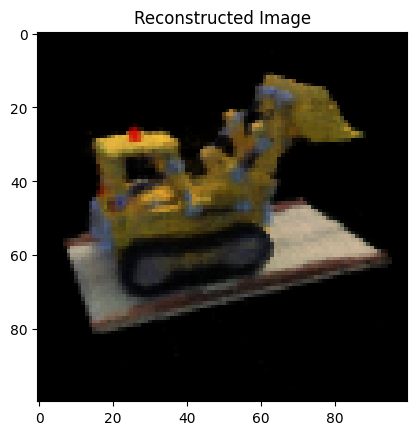

Volumetric = cpu


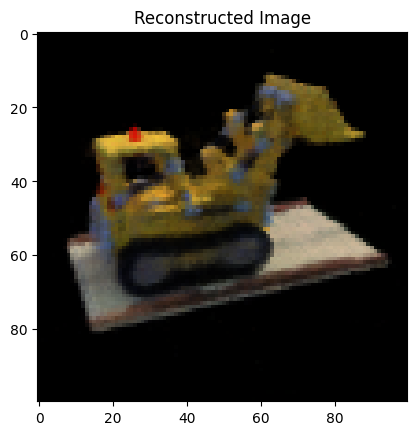

Volumetric = cpu


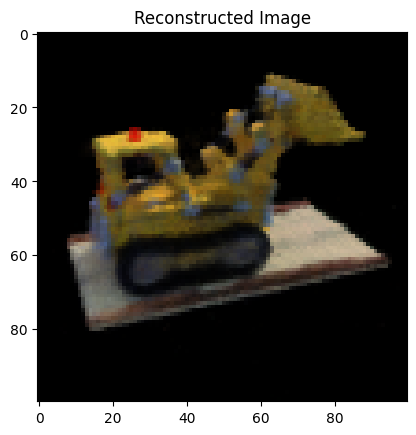

Volumetric = cpu


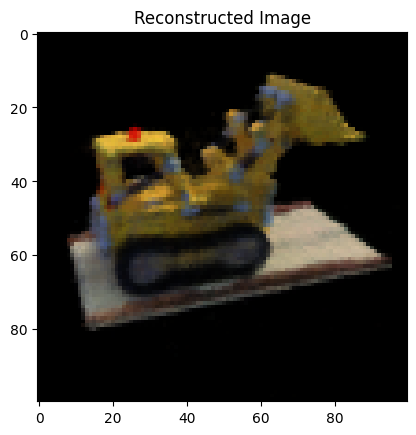

Volumetric = cpu


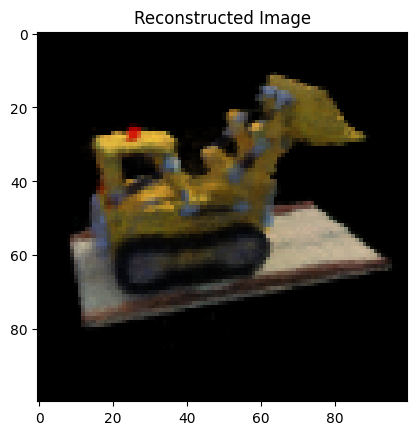

Volumetric = cpu


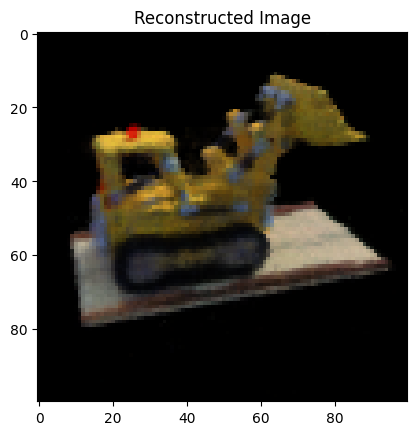

Volumetric = cpu


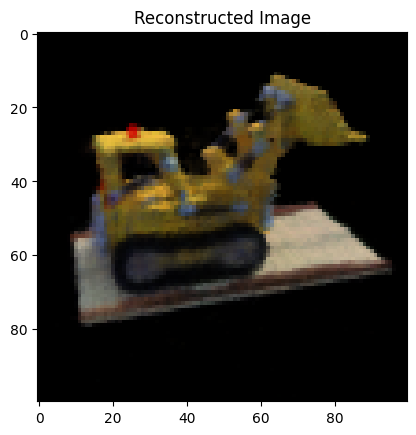

Volumetric = cpu


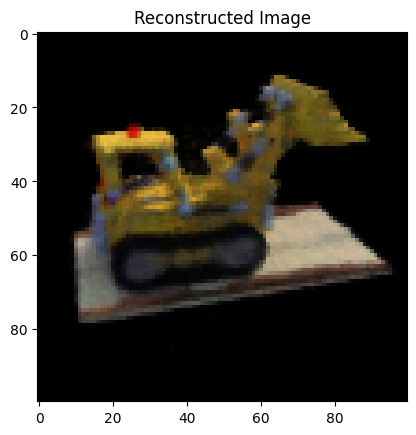

Volumetric = cpu


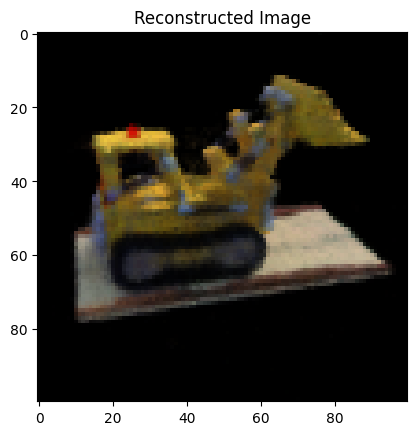

Volumetric = cpu


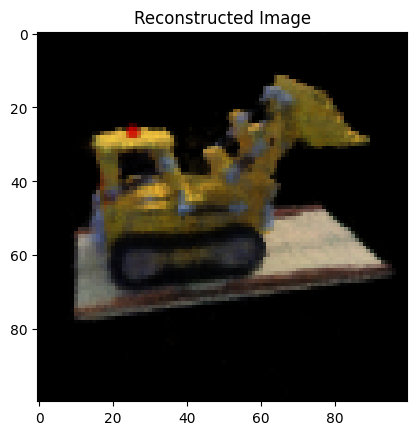

Volumetric = cpu


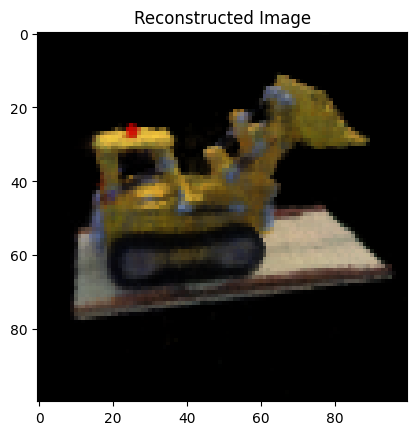

Volumetric = cpu


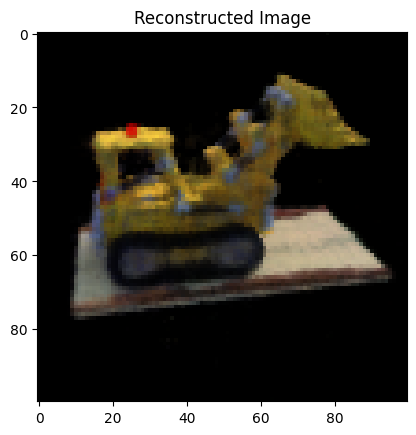

Volumetric = cpu


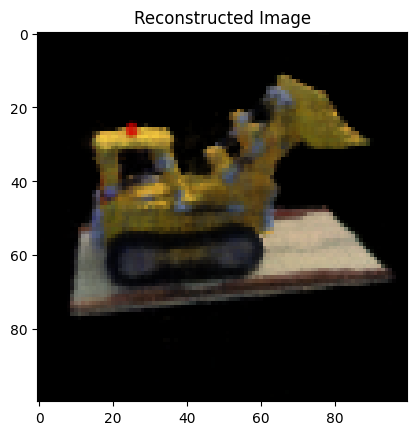

Volumetric = cpu


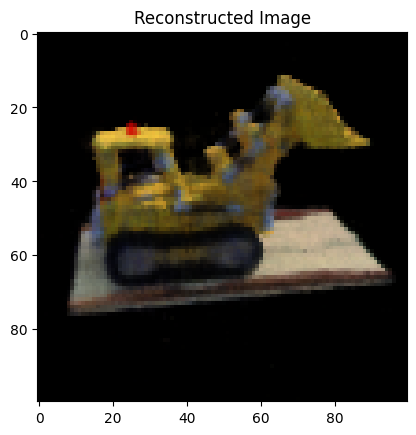

Volumetric = cpu


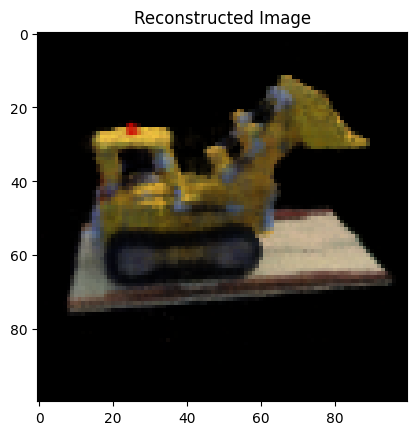

Volumetric = cpu


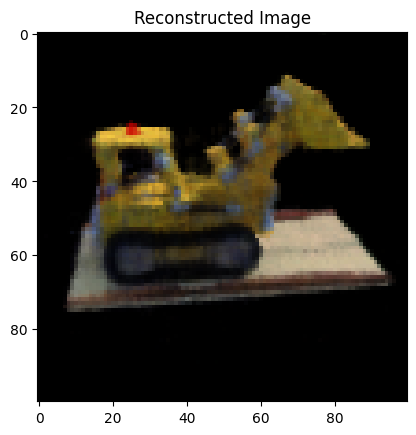

Volumetric = cpu


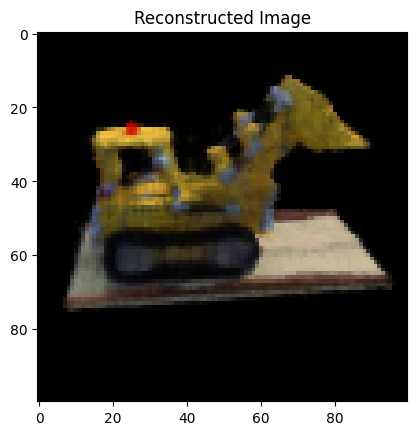

Volumetric = cpu


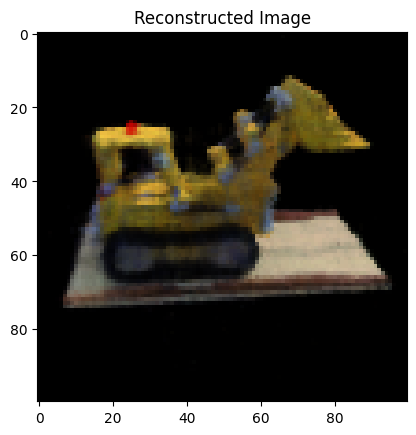

Volumetric = cpu


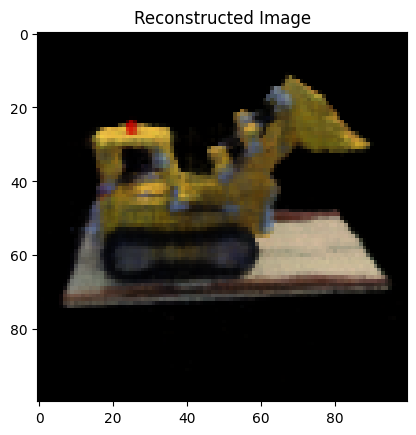

Volumetric = cpu


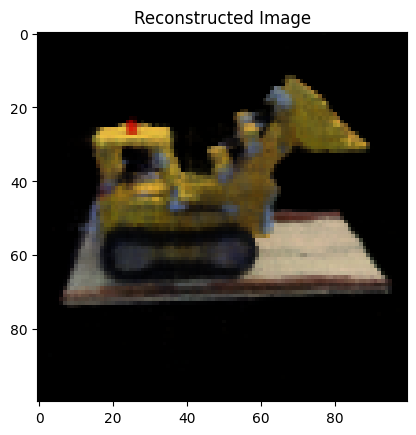

Volumetric = cpu


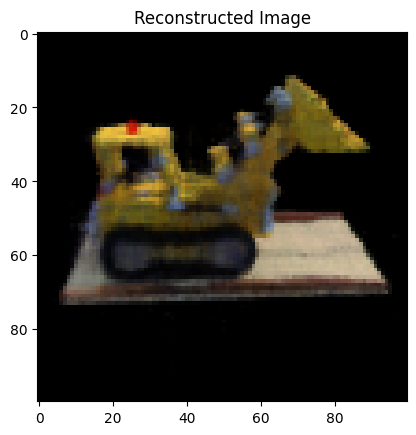

Volumetric = cpu


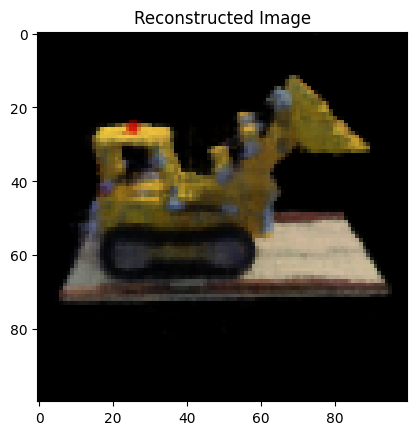

Volumetric = cpu


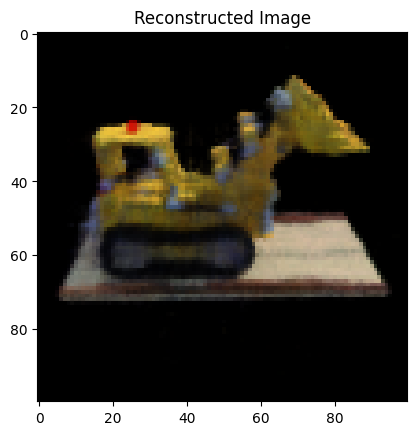

Volumetric = cpu


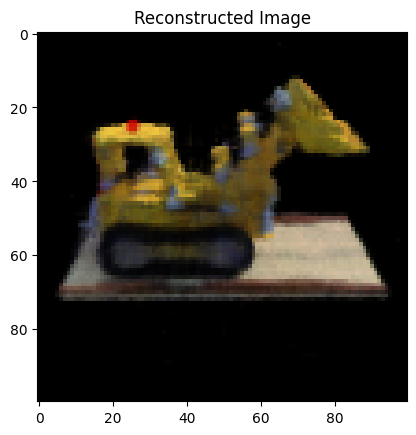

Volumetric = cpu


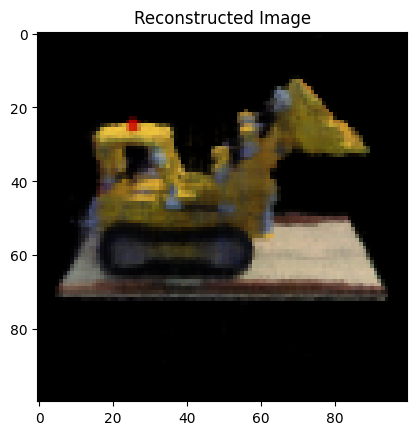

Volumetric = cpu


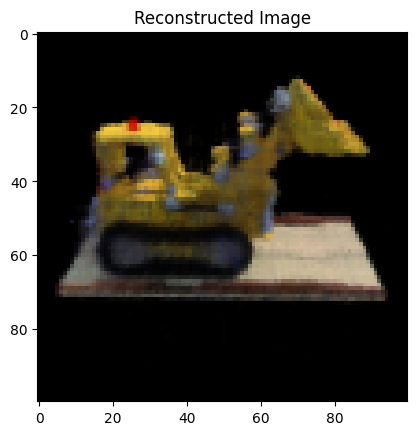

Volumetric = cpu


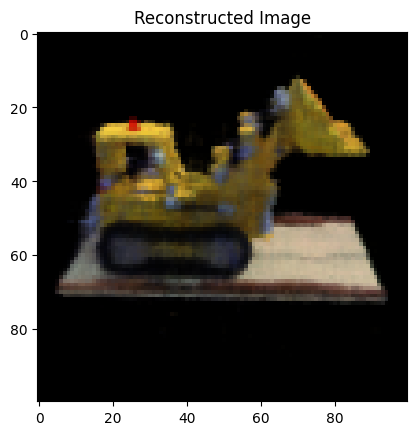

Volumetric = cpu


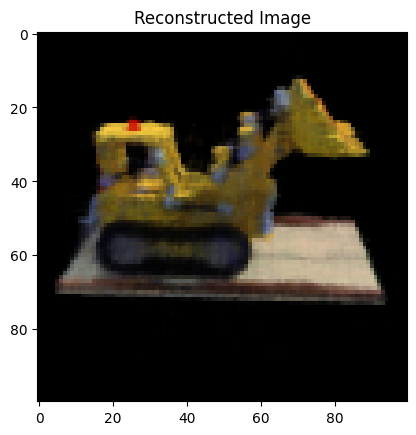

Volumetric = cpu


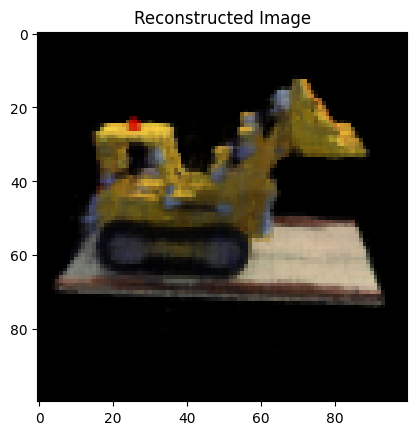

Volumetric = cpu


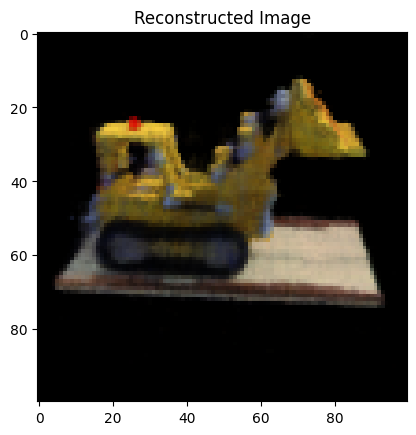

Volumetric = cpu


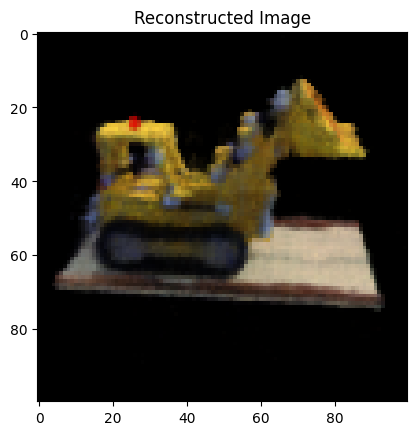

Volumetric = cpu


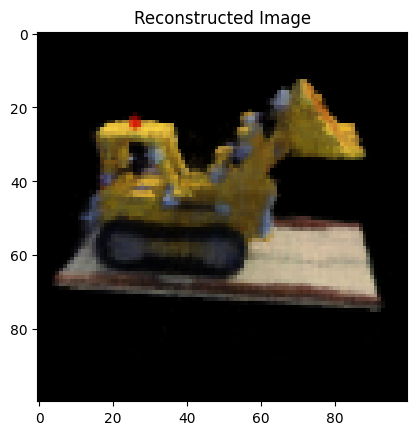

Volumetric = cpu


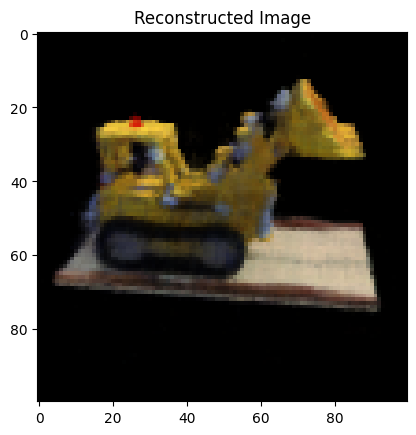

Volumetric = cpu


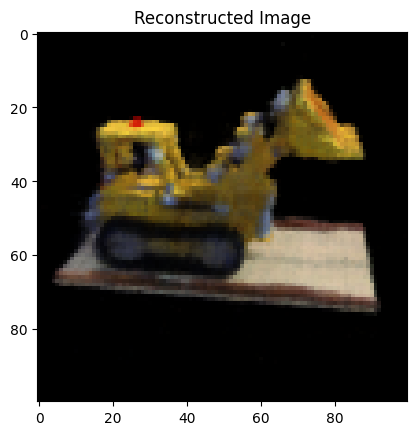

Volumetric = cpu


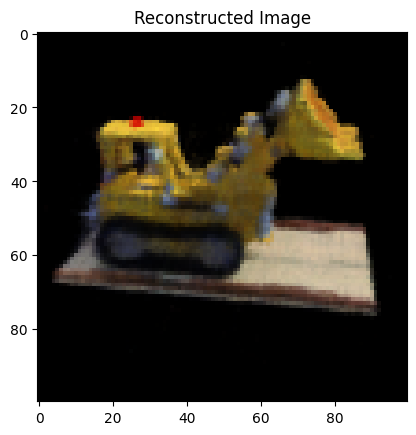

Volumetric = cpu


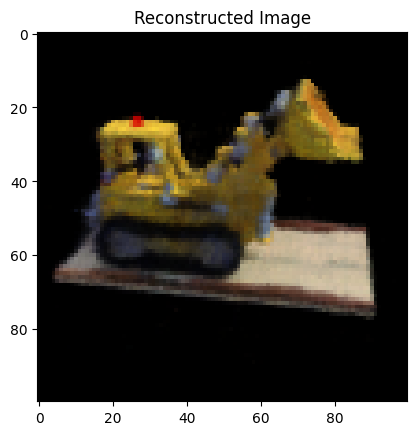

Volumetric = cpu


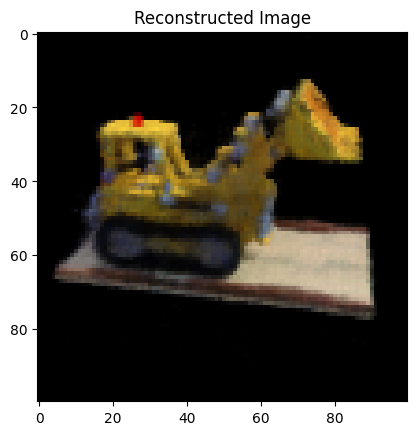

Volumetric = cpu


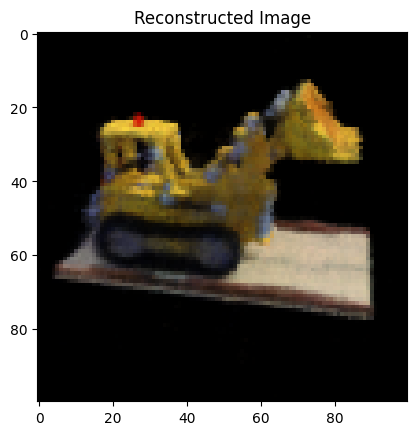

Volumetric = cpu


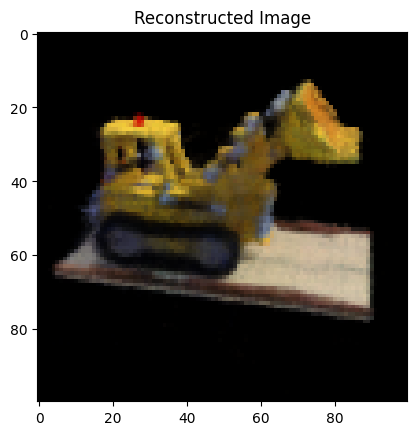

Volumetric = cpu


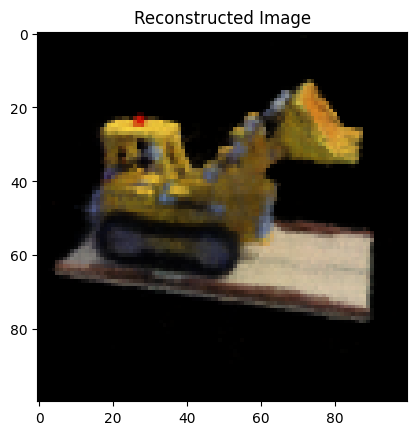

Volumetric = cpu


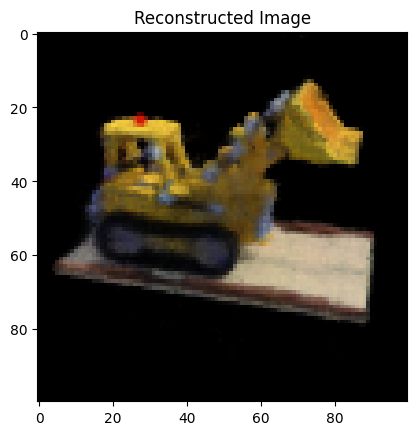

Volumetric = cpu


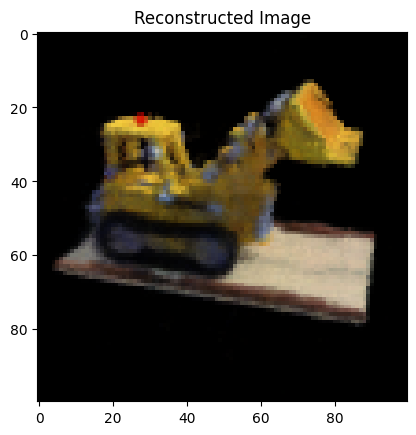

Volumetric = cpu


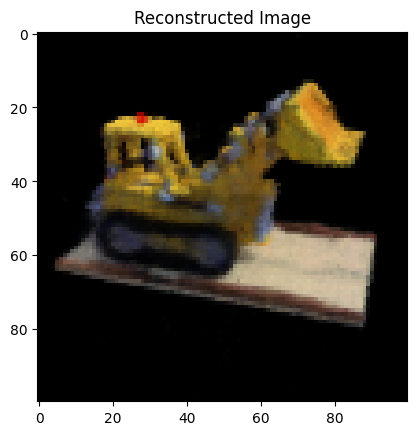

Volumetric = cpu


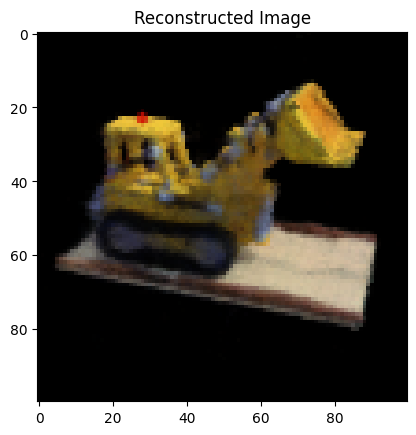

Volumetric = cpu


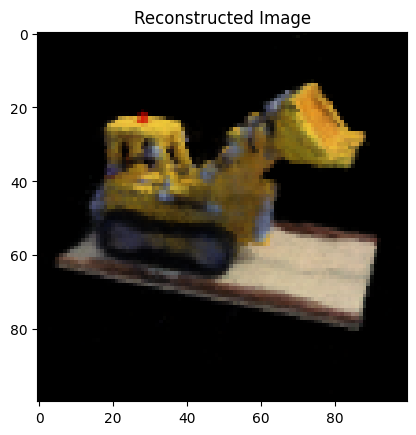

Volumetric = cpu


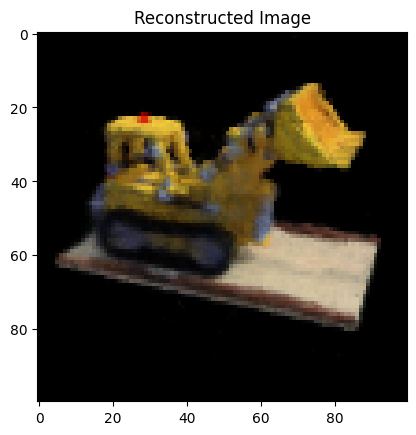

Volumetric = cpu


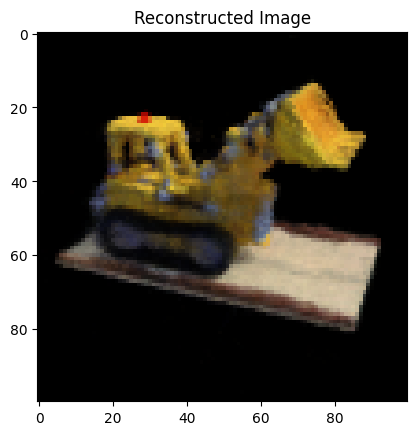

Volumetric = cpu


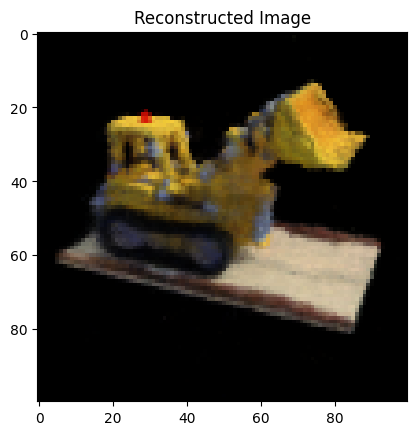

Volumetric = cpu


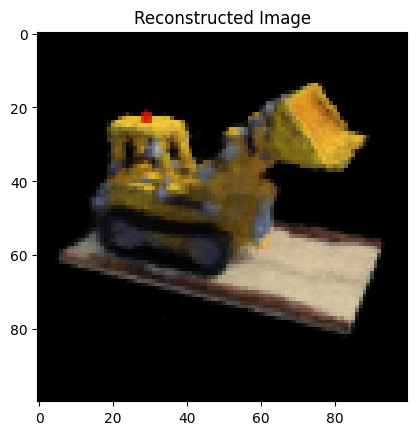

Volumetric = cpu


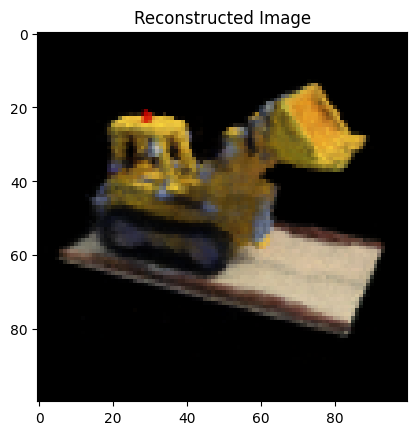

Volumetric = cpu


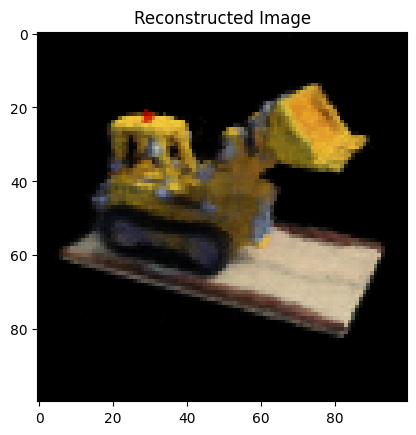

Volumetric = cpu


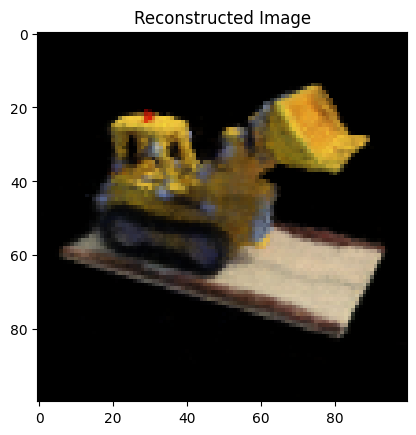

Volumetric = cpu


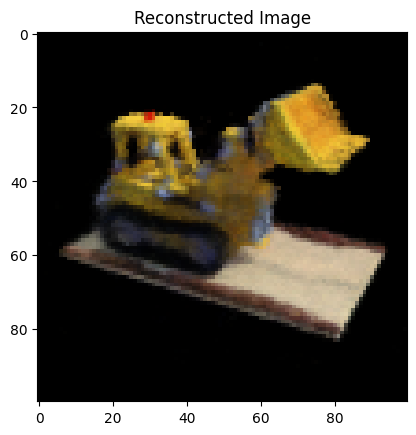

Volumetric = cpu


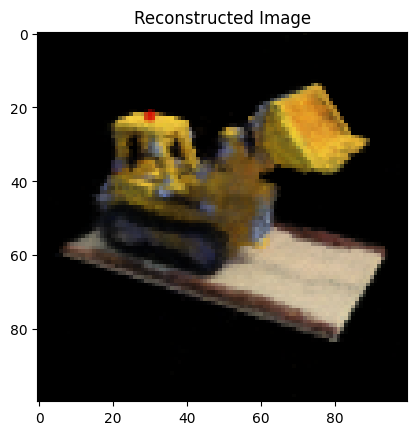

Volumetric = cpu


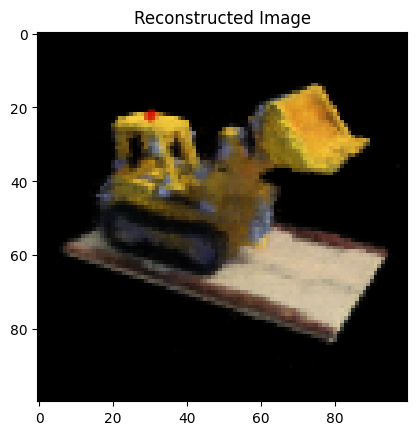

Volumetric = cpu


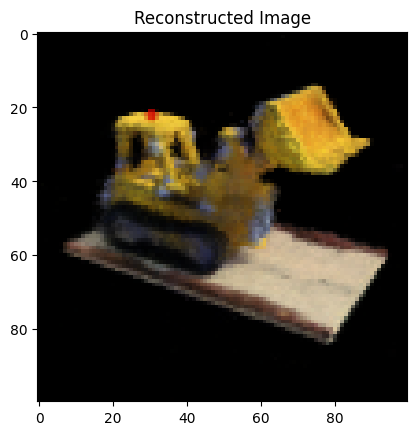

Volumetric = cpu


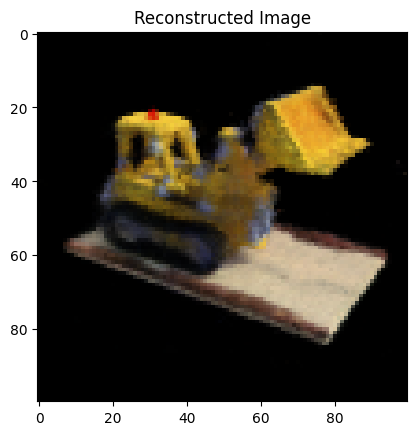

Volumetric = cpu


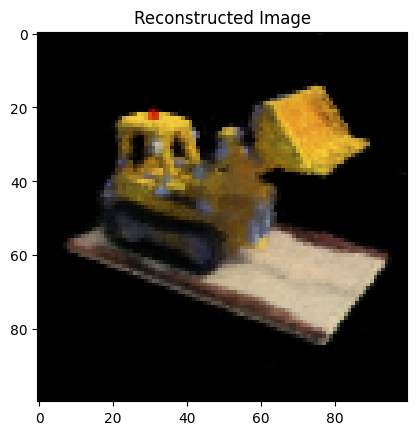

Volumetric = cpu


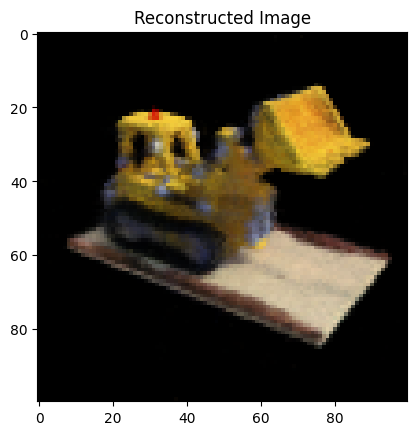

Volumetric = cpu


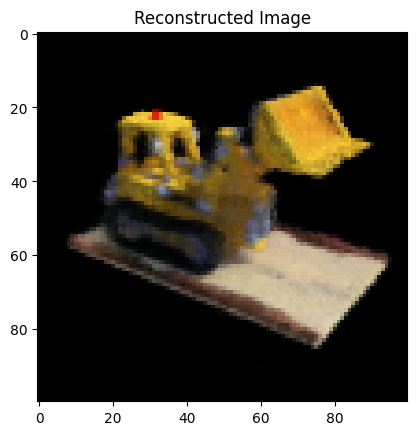

Volumetric = cpu


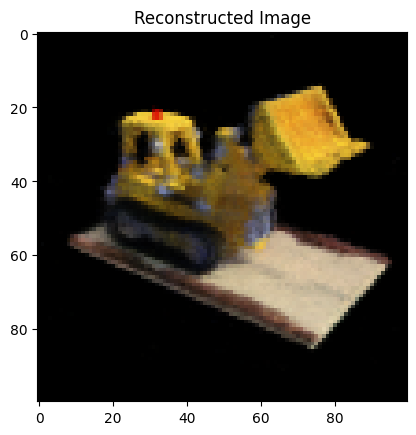

Volumetric = cpu


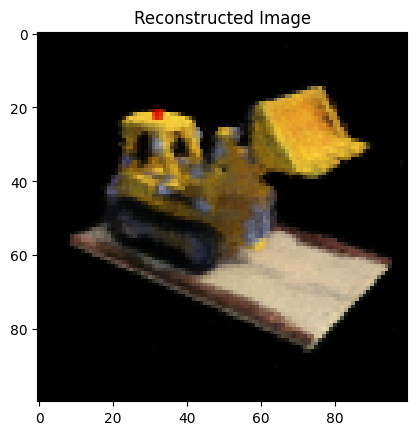

Volumetric = cpu


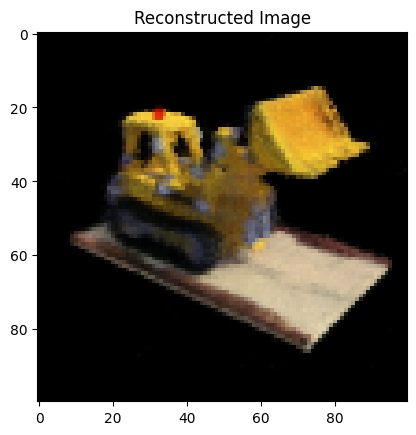

Volumetric = cpu


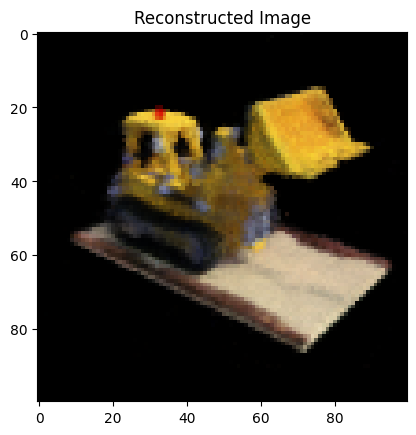

Volumetric = cpu


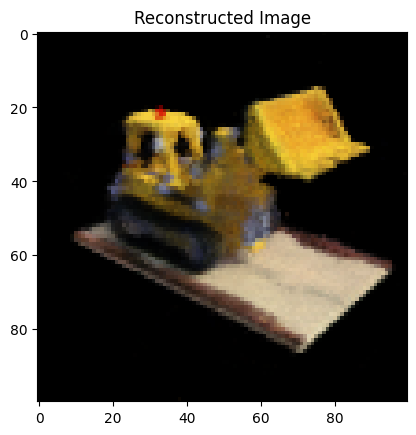

Volumetric = cpu


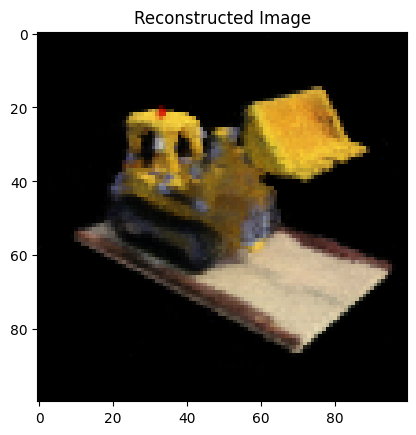

Volumetric = cpu


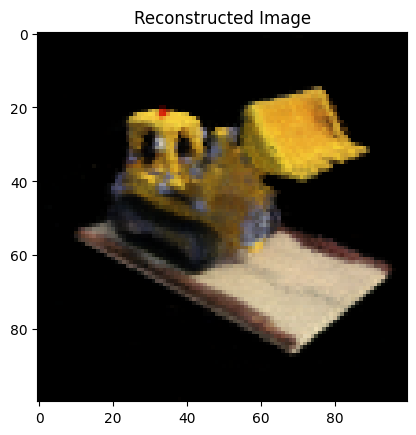

Volumetric = cpu


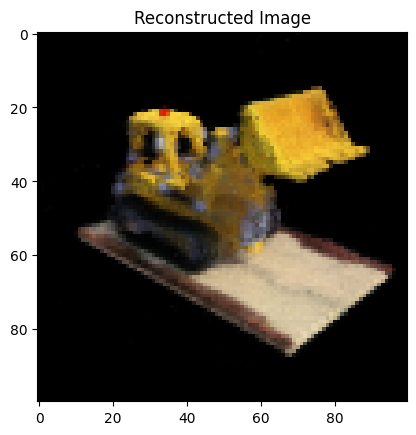

Volumetric = cpu


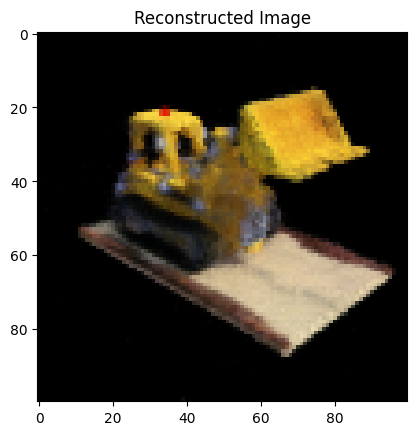

Volumetric = cpu


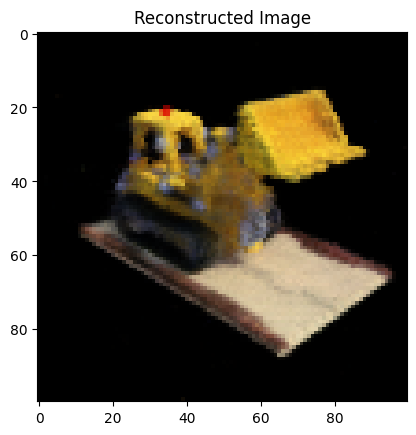

Volumetric = cpu


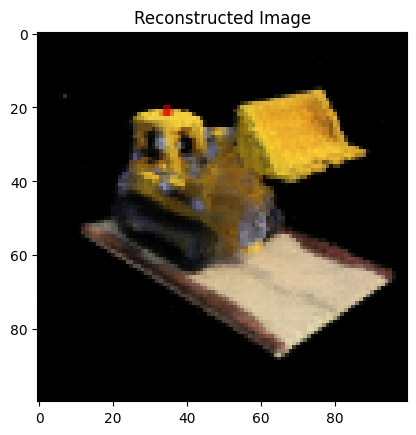

Volumetric = cpu


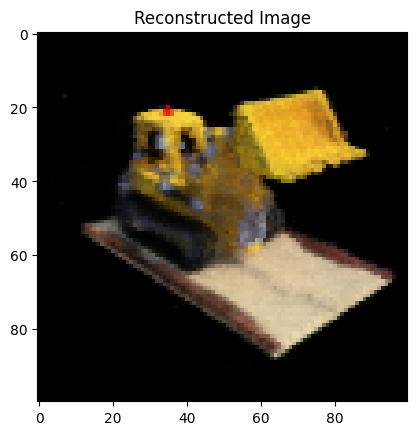

Volumetric = cpu


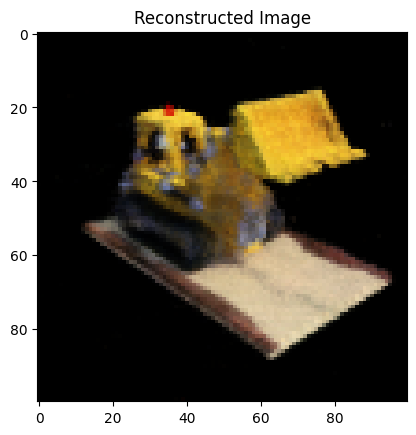

Volumetric = cpu


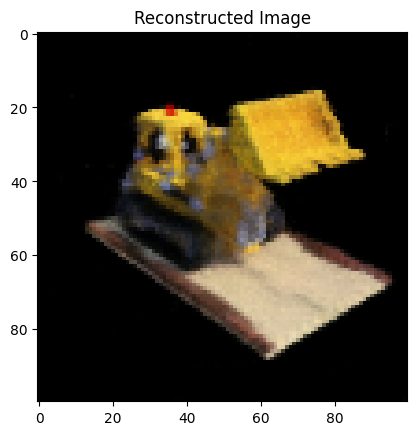

Volumetric = cpu


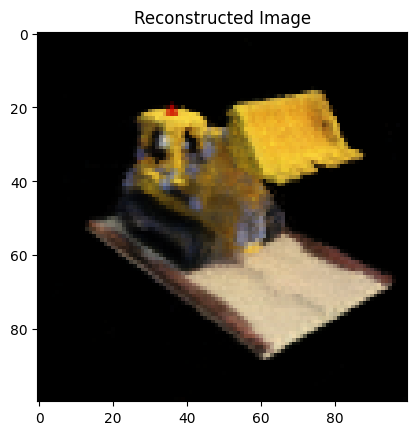

Volumetric = cpu


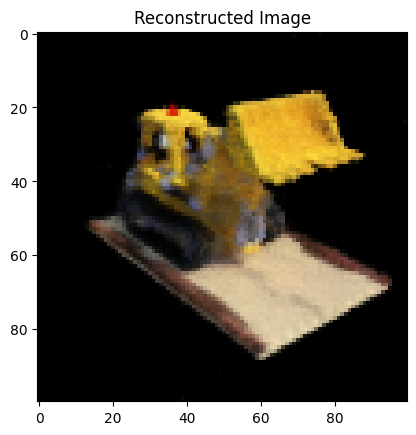

Volumetric = cpu


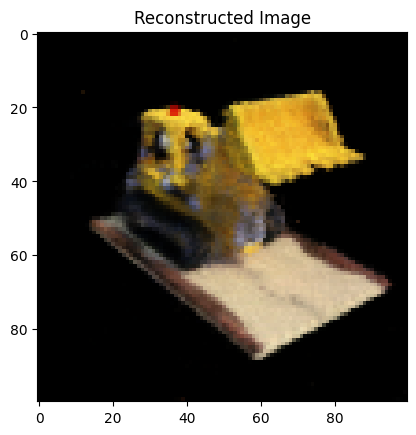

Volumetric = cpu


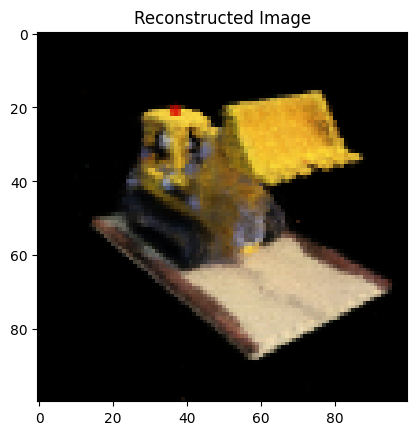

Volumetric = cpu


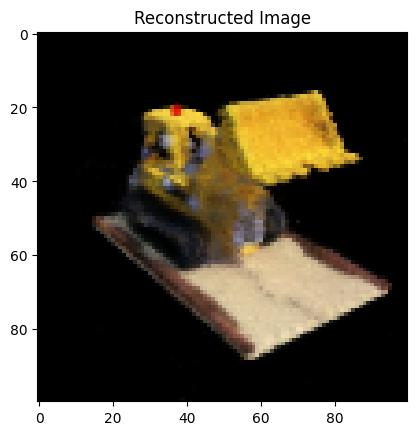

Volumetric = cpu


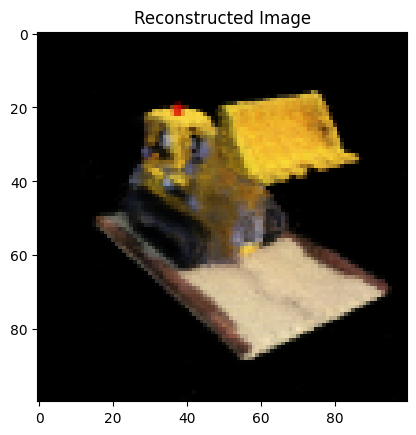

Volumetric = cpu


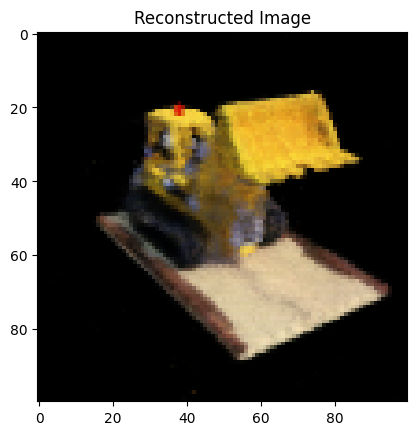

Volumetric = cpu


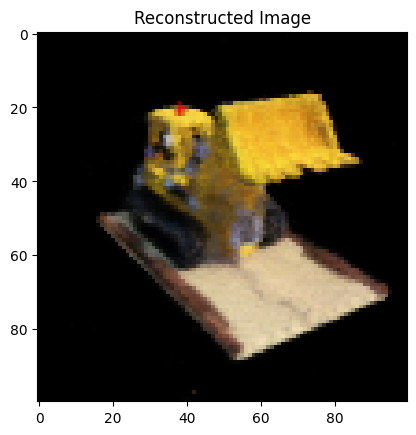

Volumetric = cpu


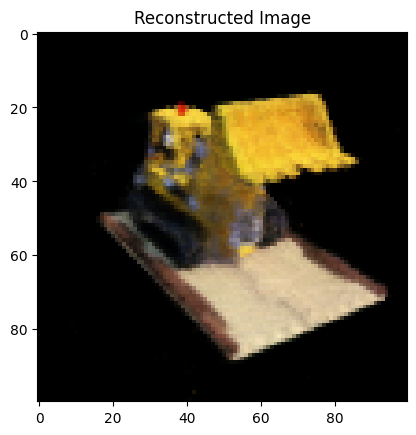

Volumetric = cpu


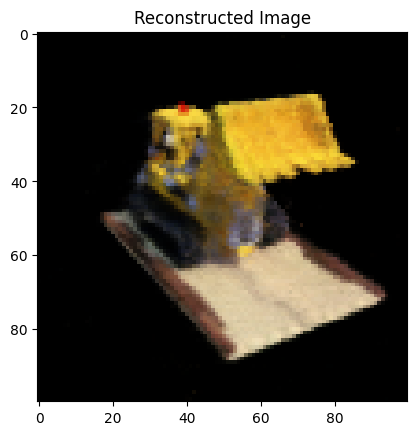

Volumetric = cpu


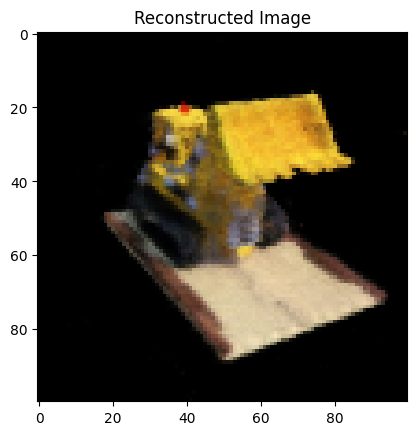

Volumetric = cpu


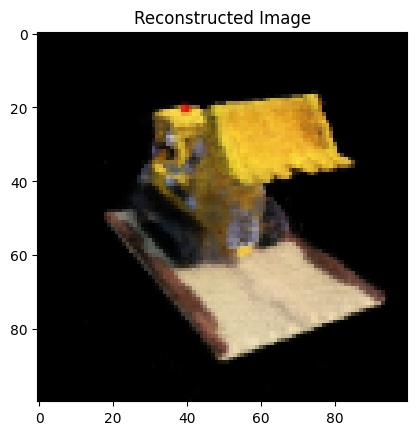

Volumetric = cpu


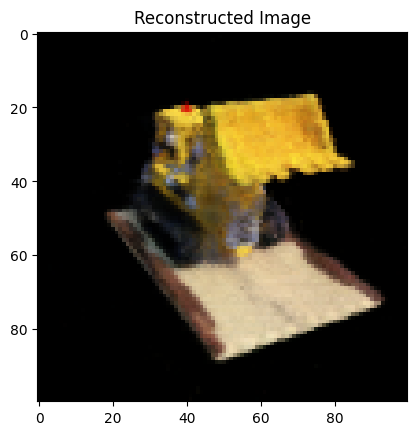

Volumetric = cpu


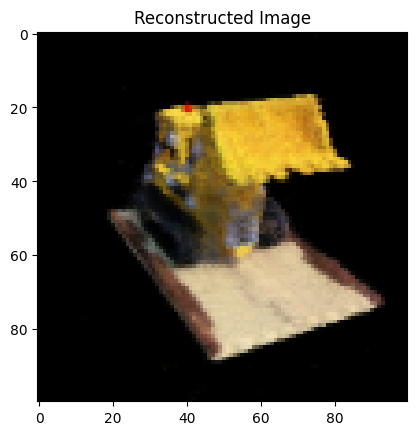

Volumetric = cpu


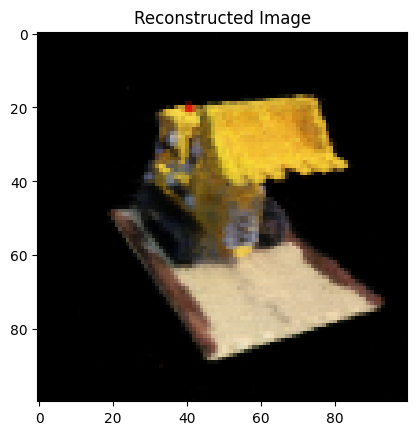

Volumetric = cpu


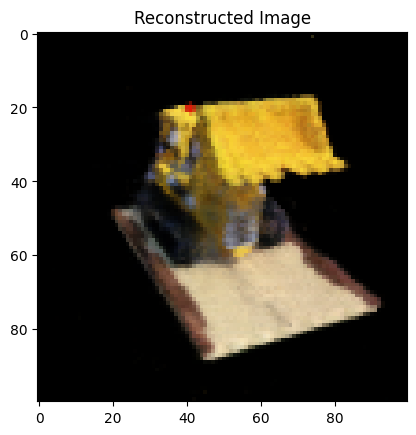

Volumetric = cpu


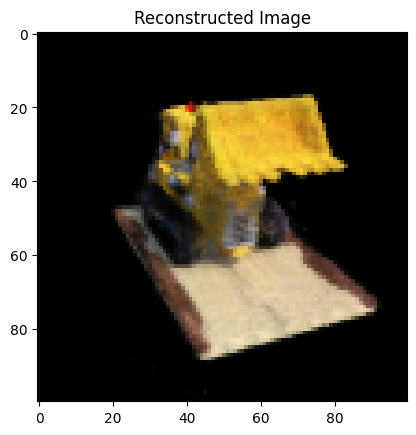

Volumetric = cpu


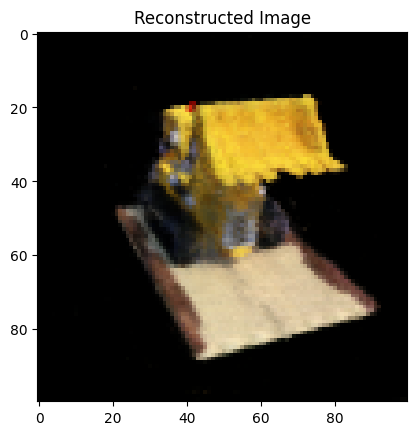

Volumetric = cpu


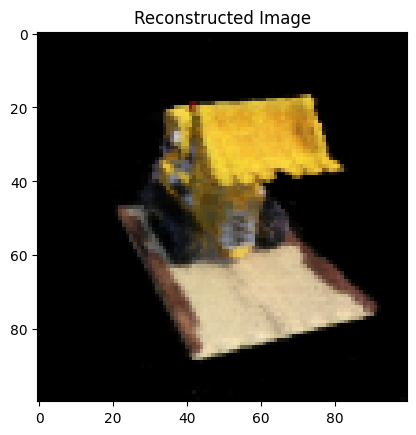

Volumetric = cpu


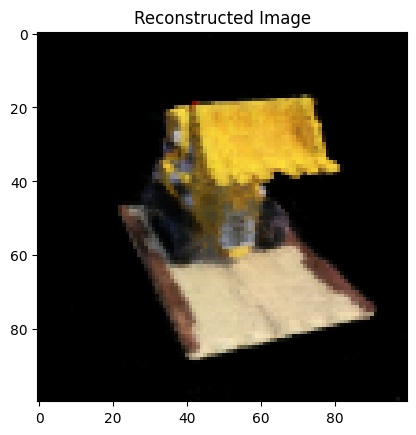

Volumetric = cpu


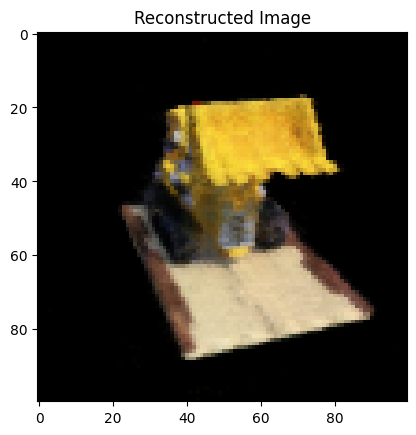

Volumetric = cpu


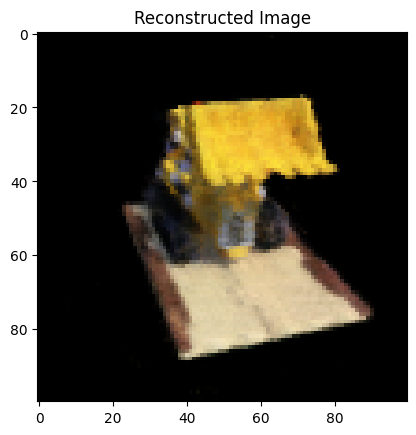

Volumetric = cpu


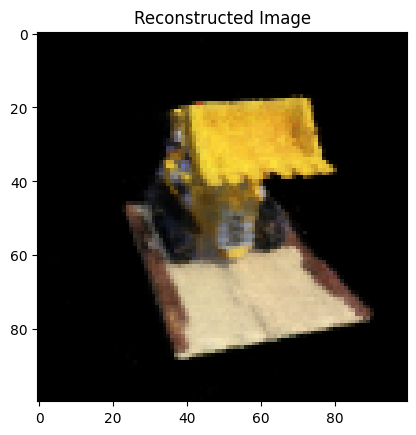

Volumetric = cpu


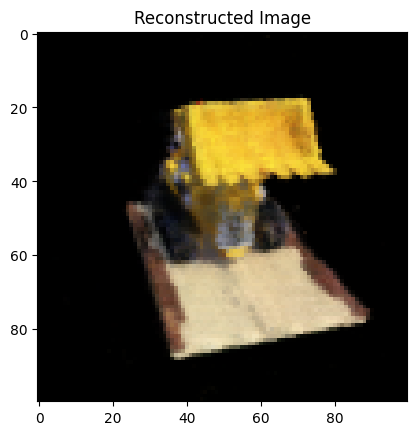

Volumetric = cpu


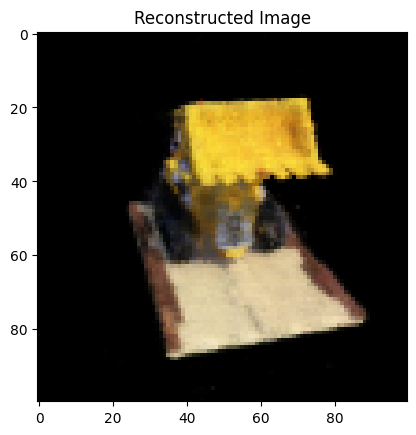

Volumetric = cpu


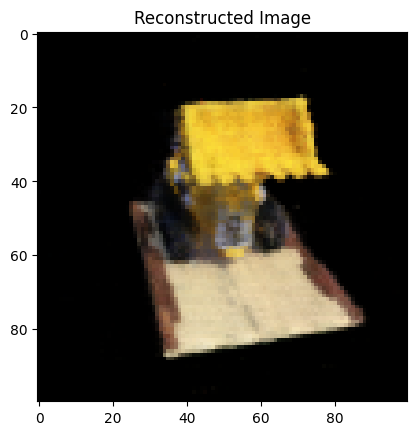

Volumetric = cpu


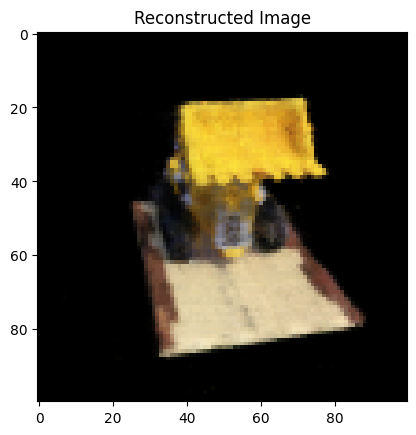

Volumetric = cpu


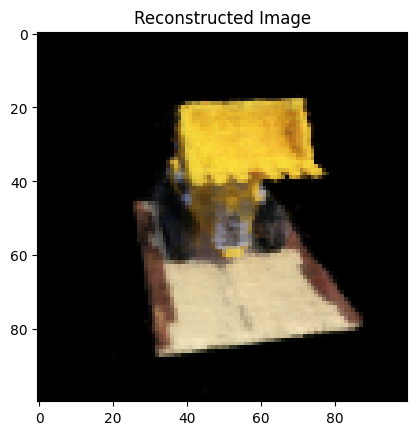

Volumetric = cpu


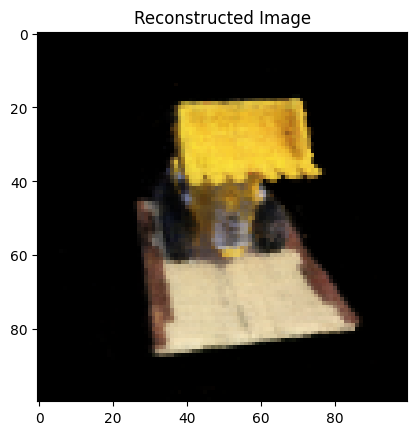

Volumetric = cpu


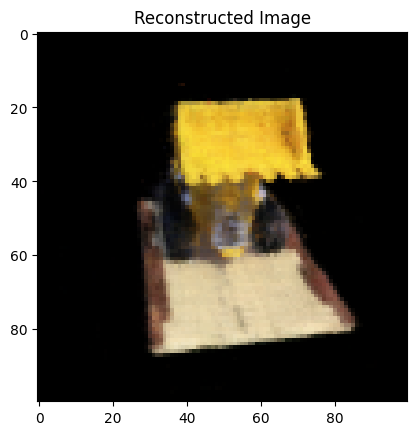

Volumetric = cpu


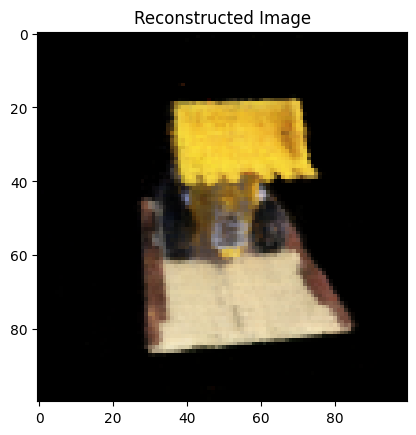

Volumetric = cpu


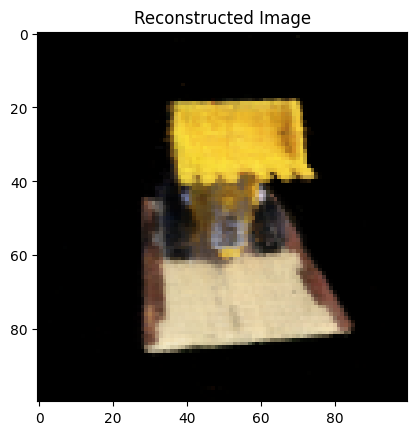

Volumetric = cpu


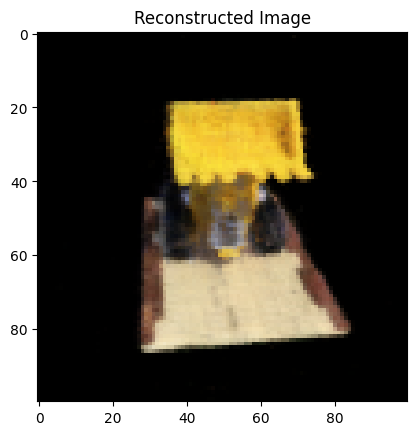

Volumetric = cpu


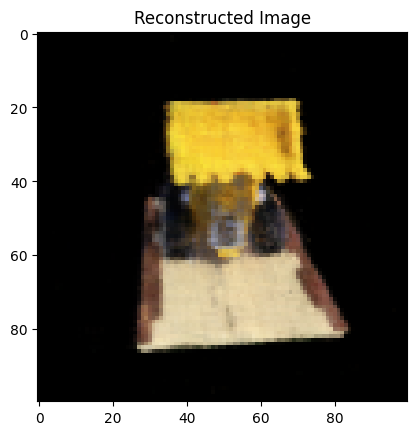

Volumetric = cpu


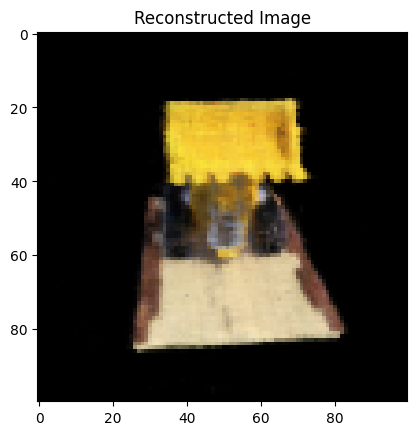

Volumetric = cpu


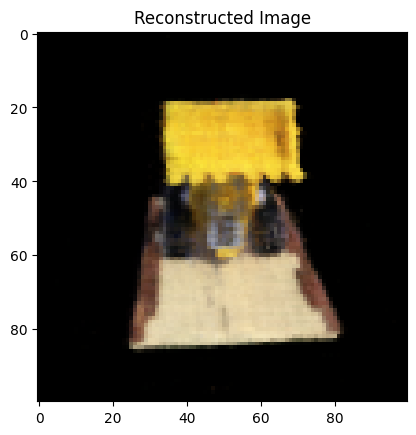

Volumetric = cpu


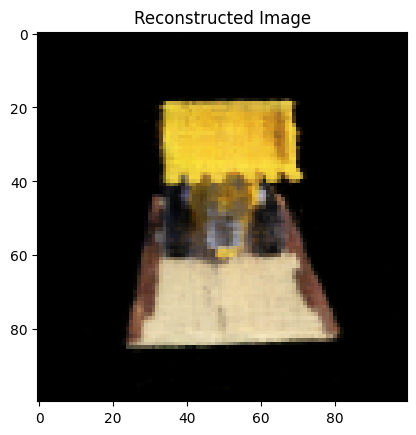

Volumetric = cpu


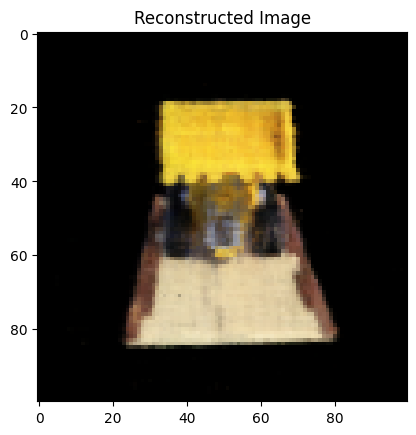

Volumetric = cpu


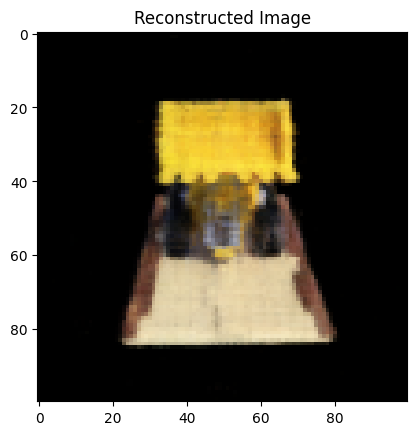

Volumetric = cpu


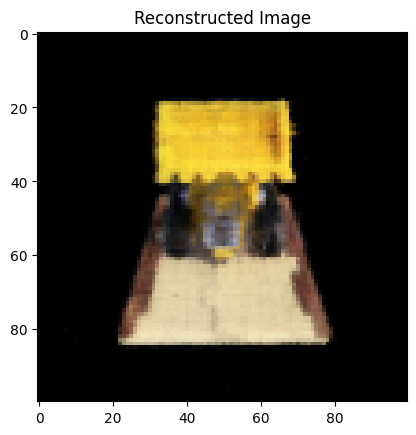

Volumetric = cpu


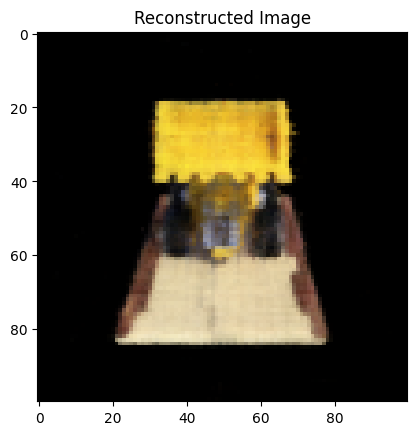

Volumetric = cpu


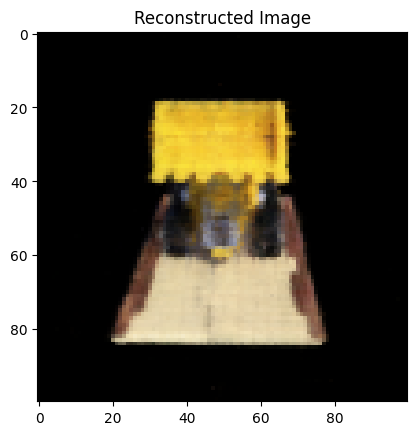

Volumetric = cpu


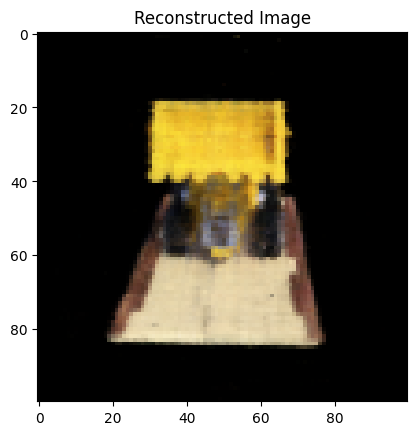

Volumetric = cpu


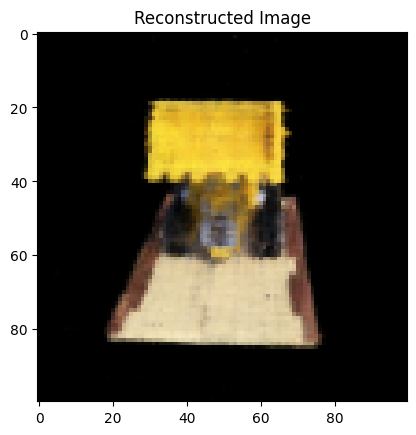

Volumetric = cpu


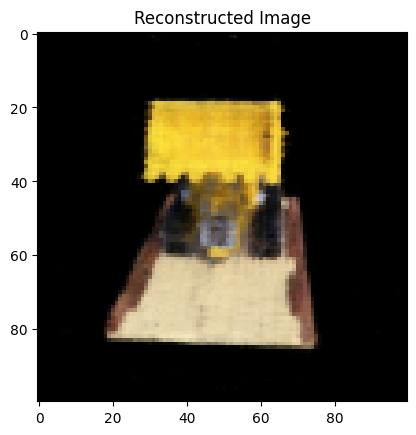

Volumetric = cpu


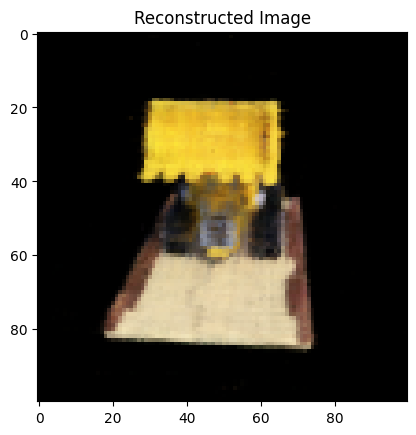

Volumetric = cpu


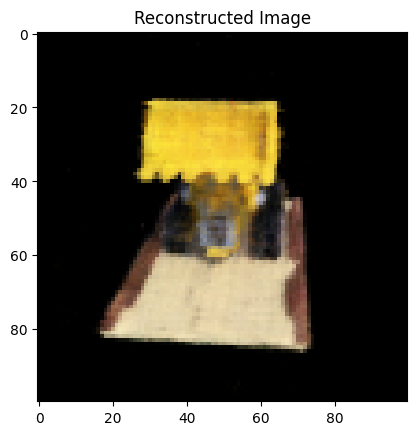

Volumetric = cpu


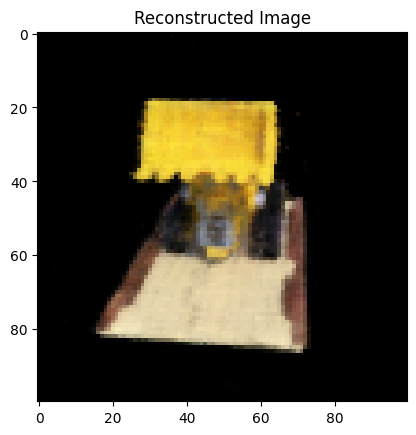

Volumetric = cpu


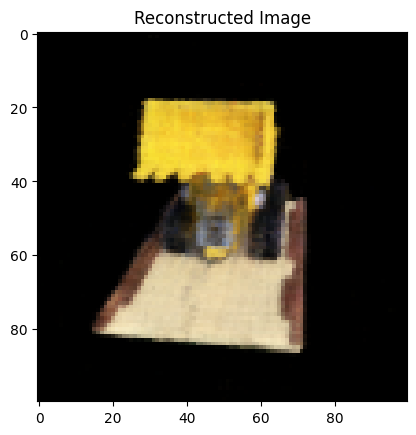

Volumetric = cpu


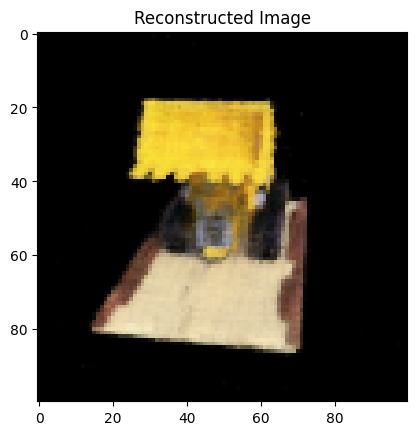

Volumetric = cpu


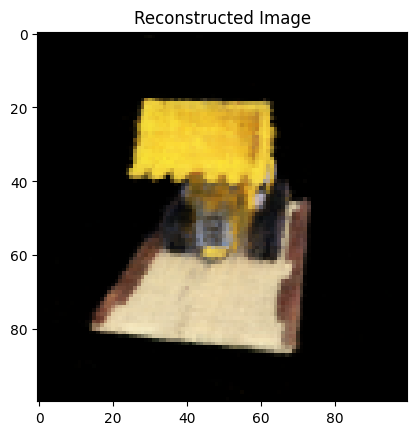

Volumetric = cpu


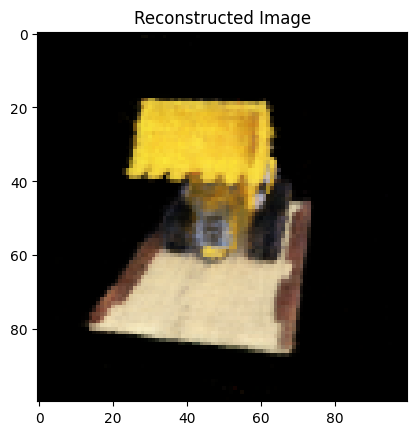

Volumetric = cpu


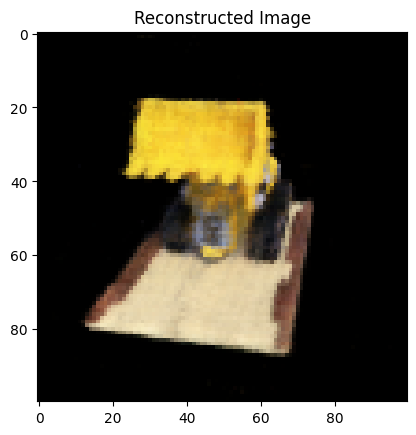

Volumetric = cpu


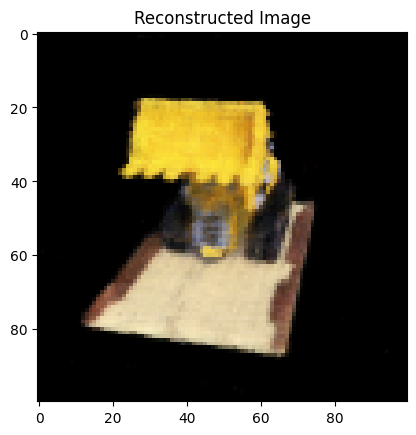

Volumetric = cpu


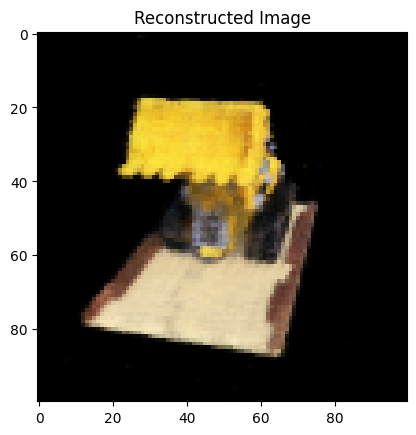

Volumetric = cpu


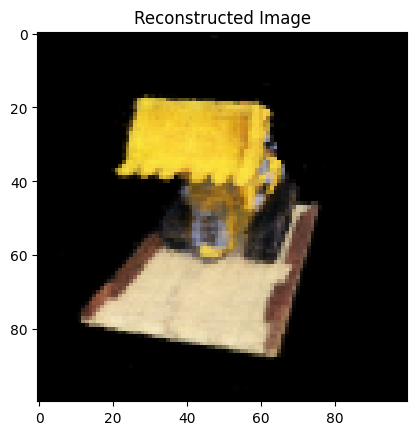

Volumetric = cpu


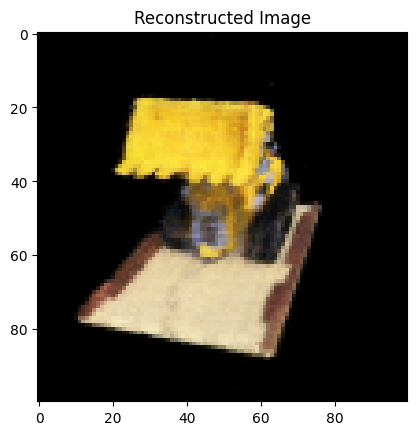

Volumetric = cpu


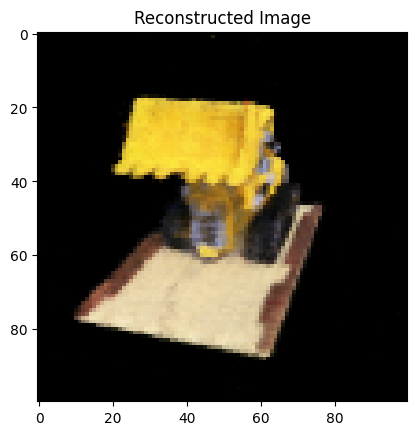

Volumetric = cpu


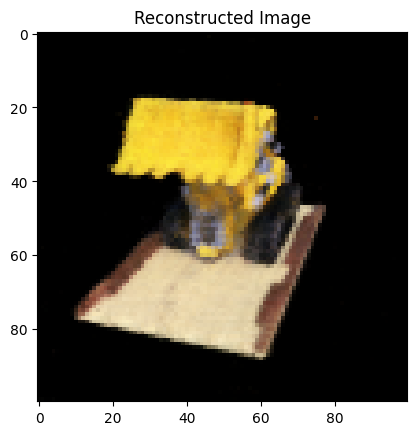

Volumetric = cpu


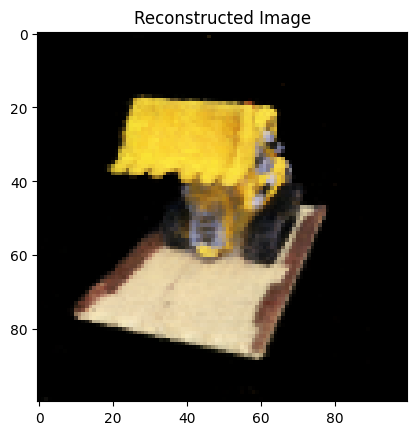

Volumetric = cpu


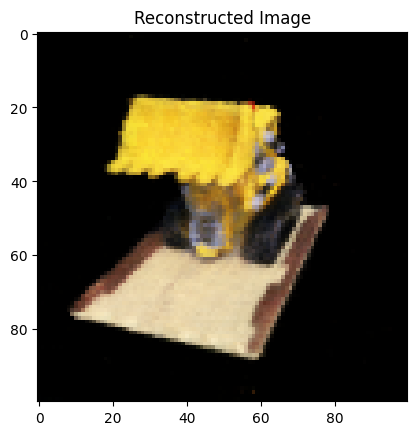

Volumetric = cpu


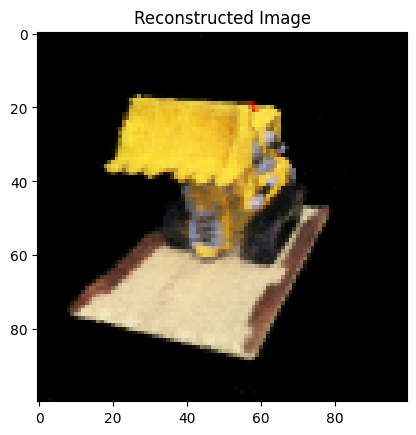

Volumetric = cpu


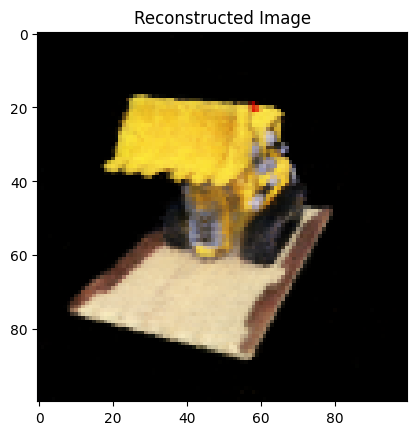

Volumetric = cpu


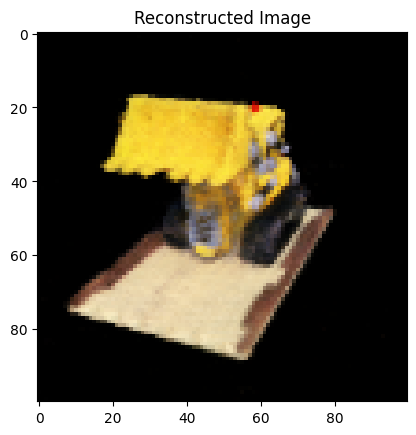

Volumetric = cpu


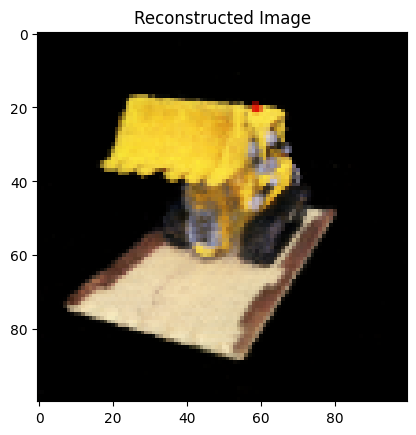

Volumetric = cpu


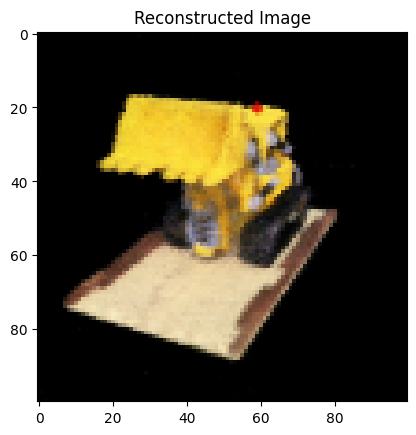

Volumetric = cpu


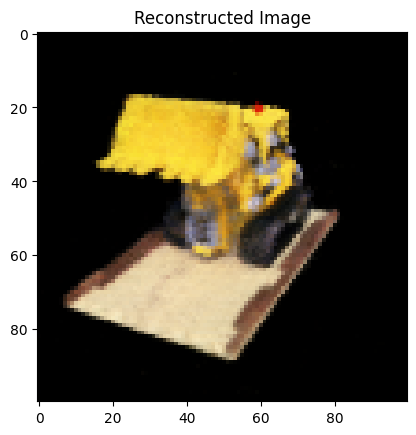

Volumetric = cpu


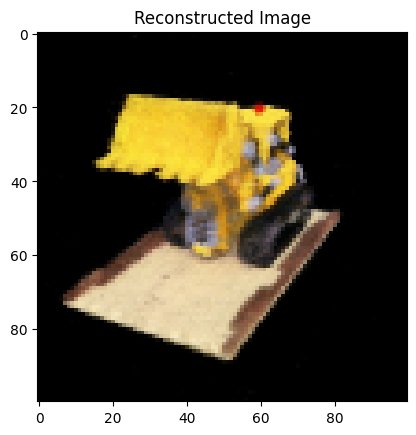

Volumetric = cpu


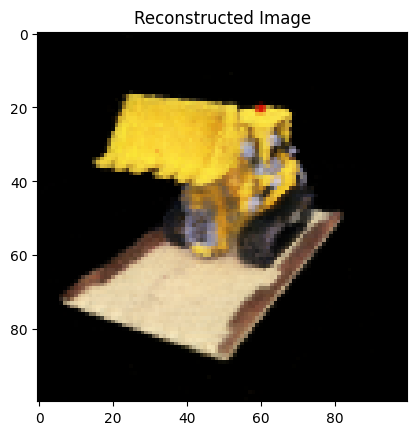

Volumetric = cpu


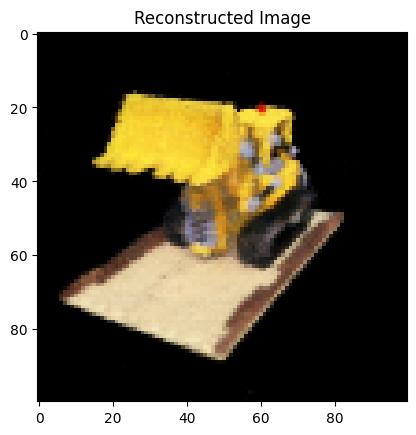

Volumetric = cpu


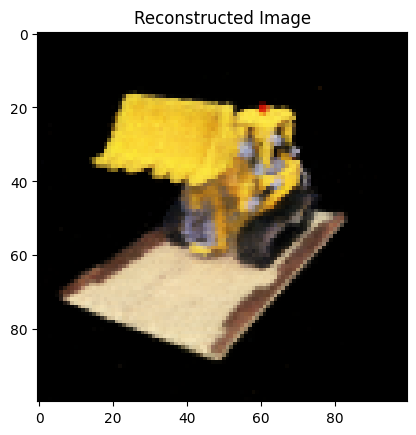

Volumetric = cpu


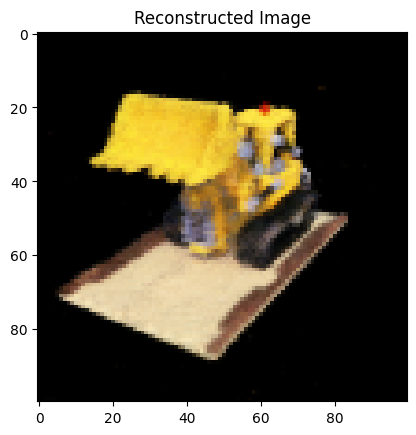

Volumetric = cpu


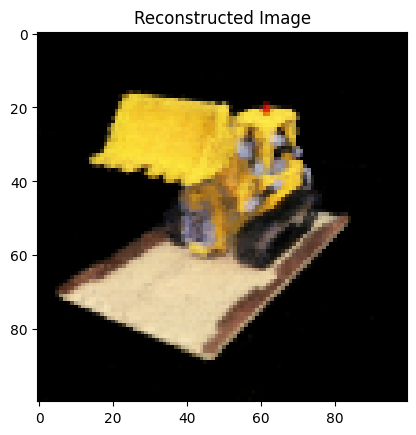

Volumetric = cpu


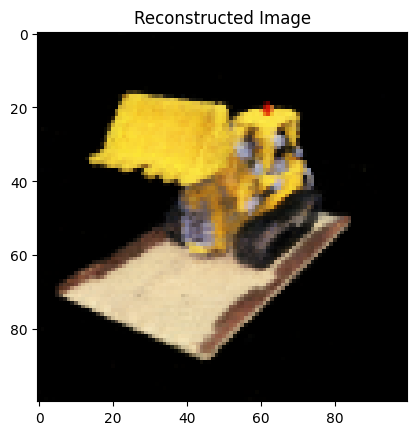

Volumetric = cpu


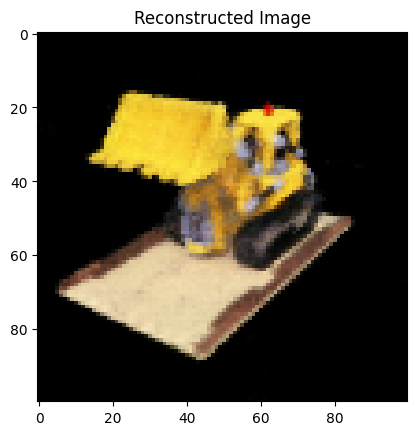

Volumetric = cpu


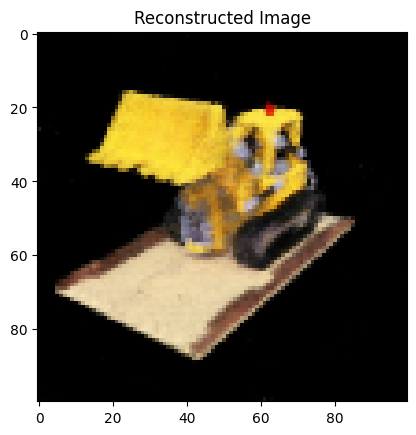

Volumetric = cpu


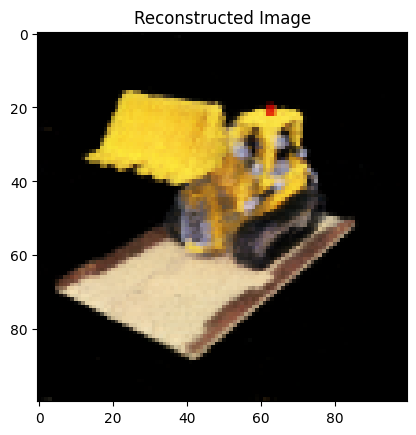

Volumetric = cpu


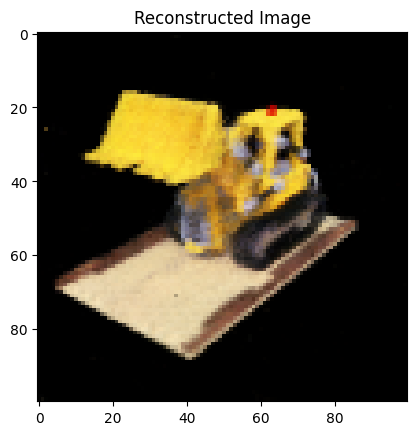

Volumetric = cpu


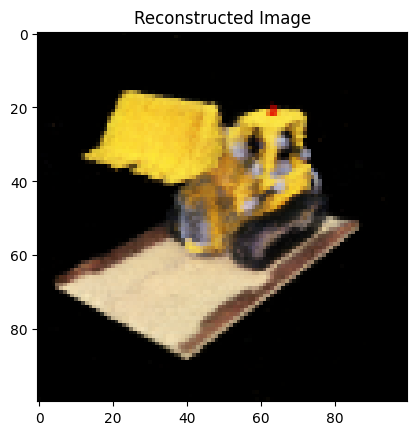

Volumetric = cpu


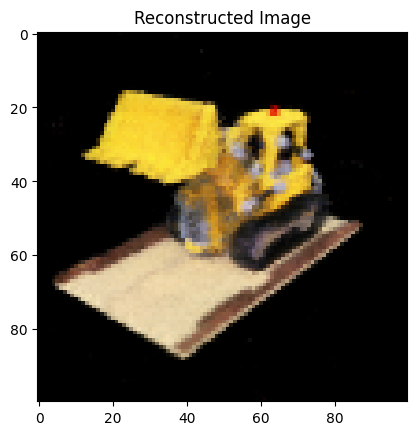

Volumetric = cpu


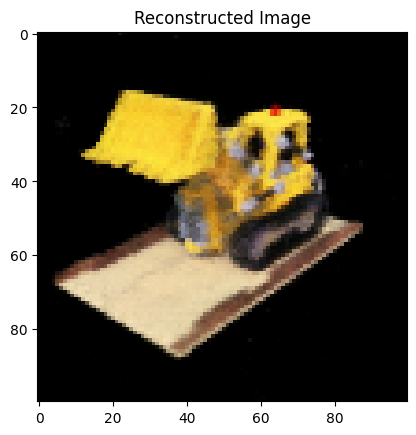

Volumetric = cpu


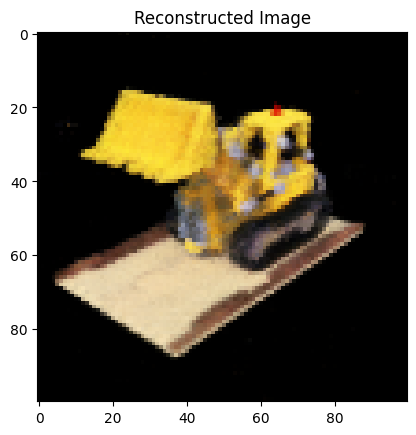

Volumetric = cpu


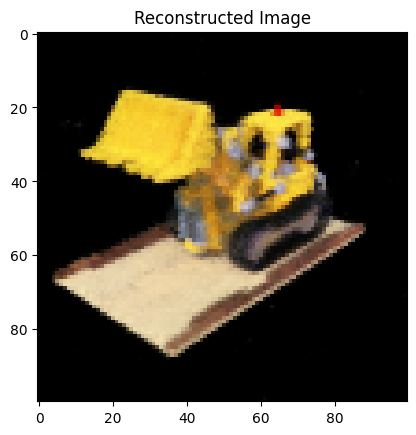

Volumetric = cpu


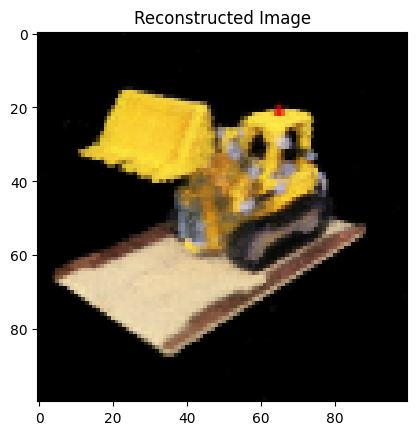

Volumetric = cpu


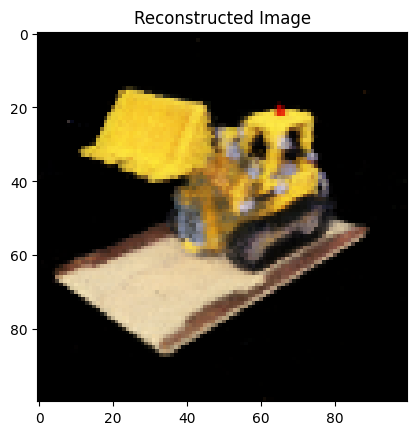

Volumetric = cpu


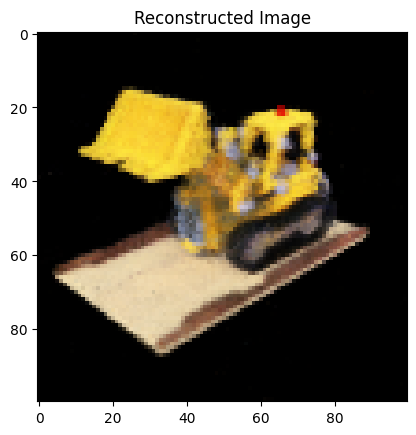

Volumetric = cpu


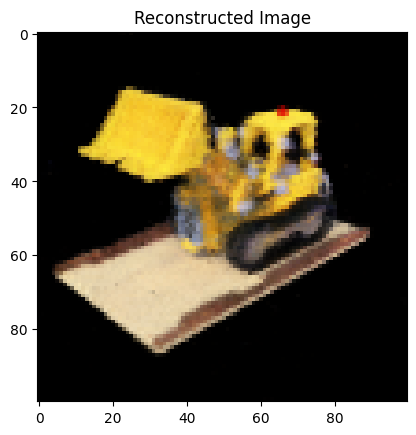

Volumetric = cpu


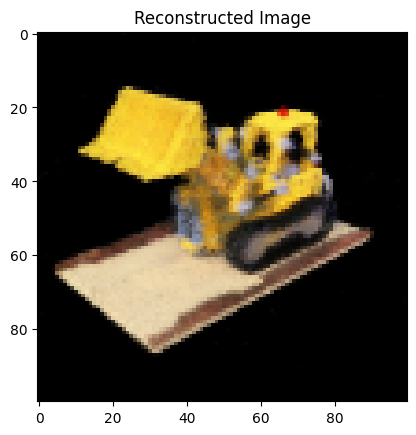

Volumetric = cpu


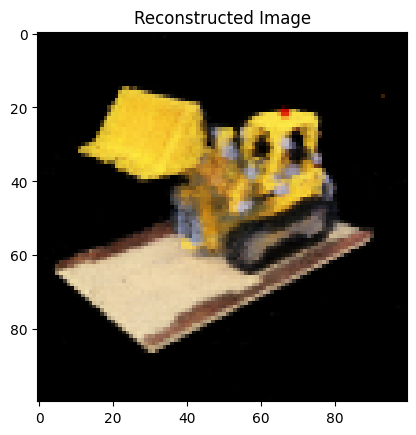

Volumetric = cpu


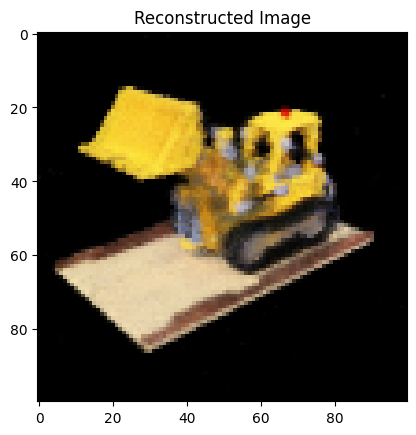

Volumetric = cpu


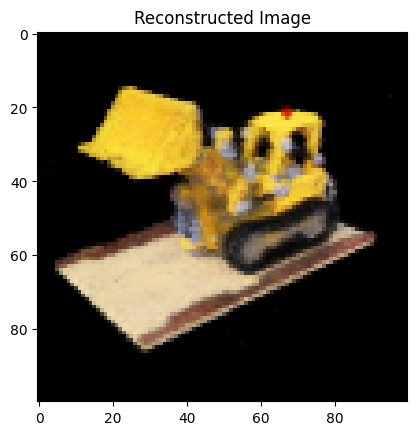

Volumetric = cpu


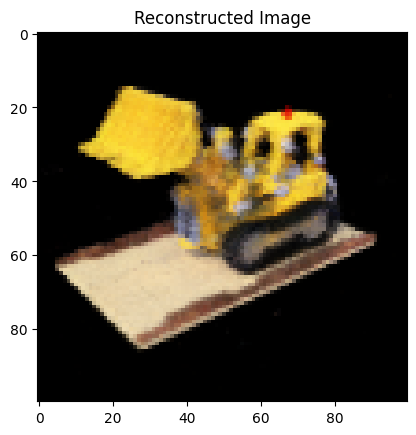

Volumetric = cpu


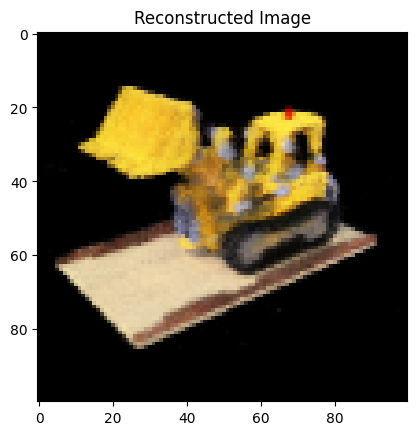

Volumetric = cpu


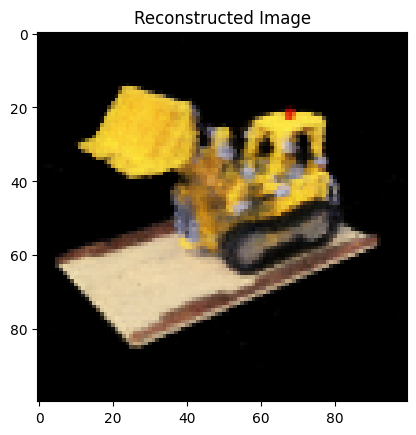

Volumetric = cpu


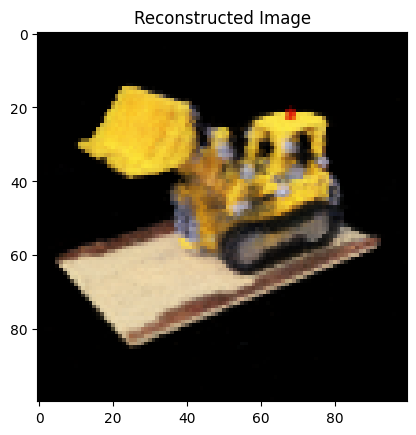

Volumetric = cpu


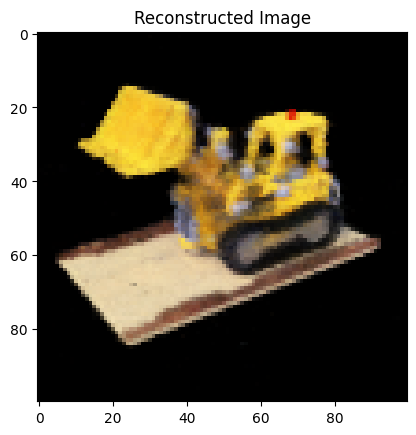

Volumetric = cpu


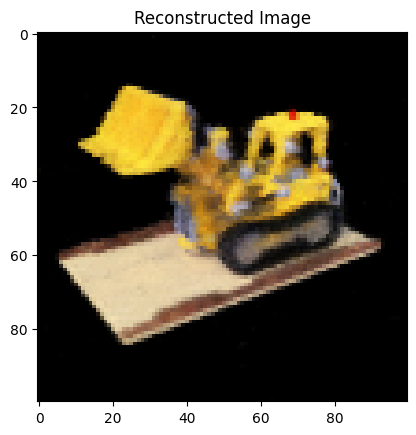

Volumetric = cpu


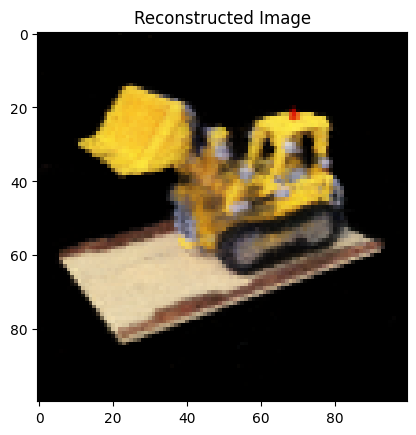

Volumetric = cpu


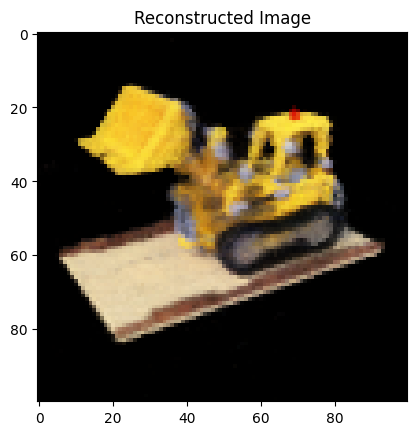

Volumetric = cpu


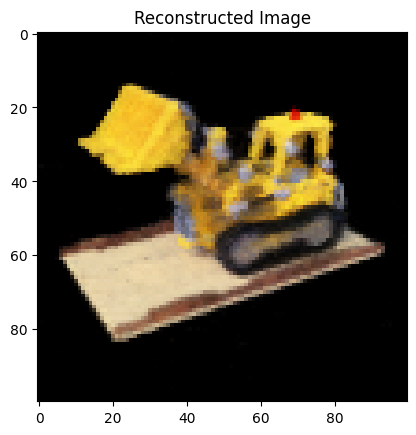

Volumetric = cpu


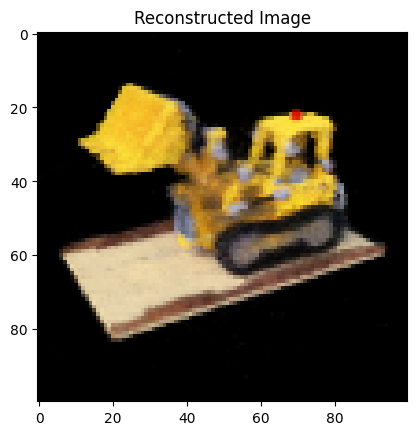

Volumetric = cpu


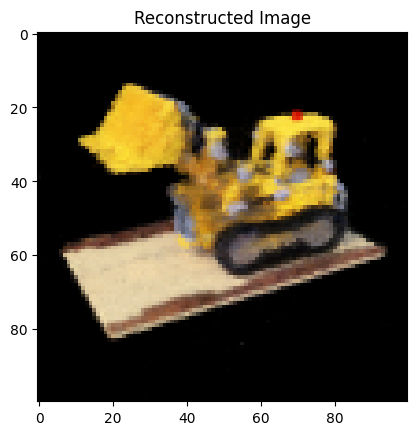

Volumetric = cpu


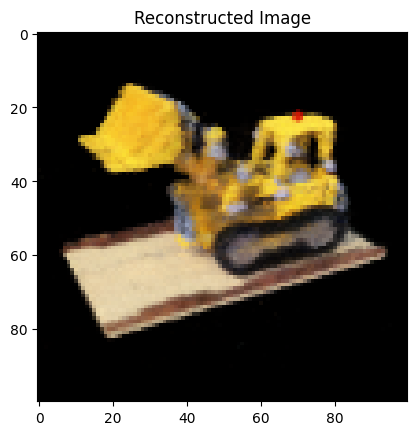

Volumetric = cpu


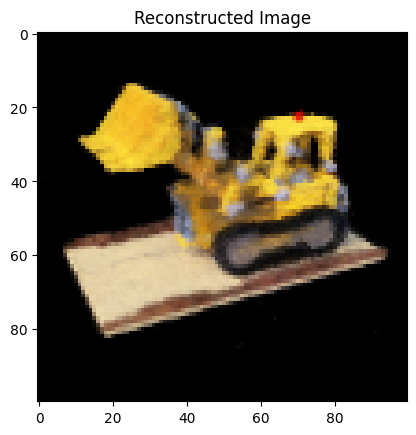

Volumetric = cpu


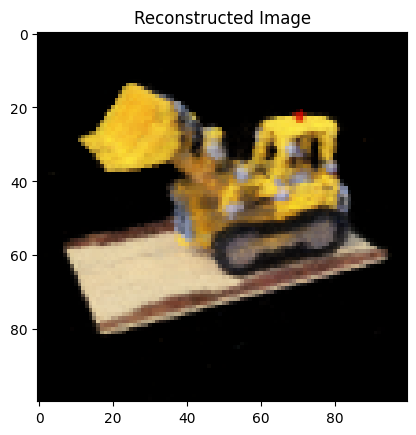

Volumetric = cpu


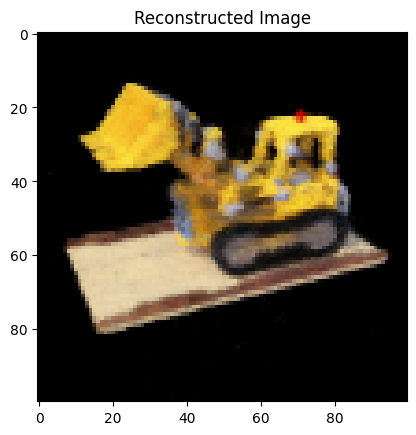

Volumetric = cpu


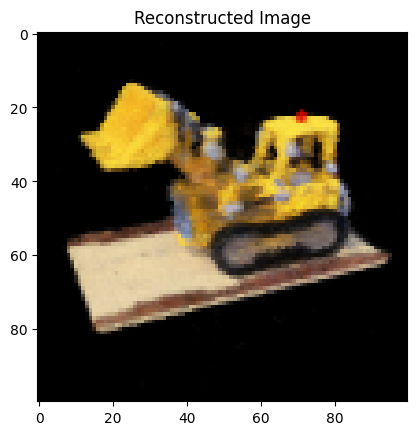

Volumetric = cpu


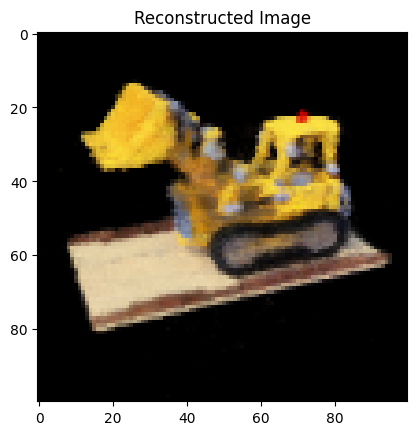

Volumetric = cpu


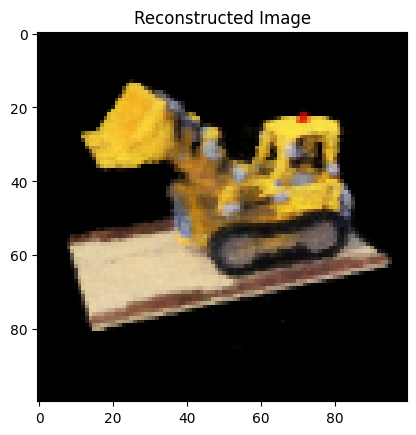

Volumetric = cpu


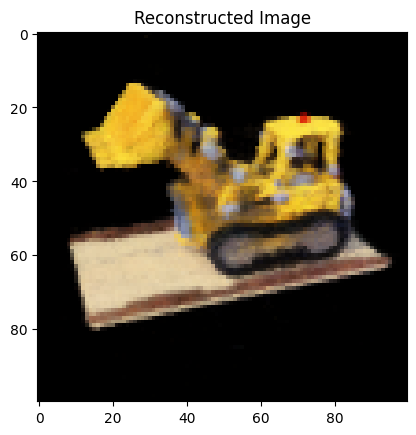

Volumetric = cpu


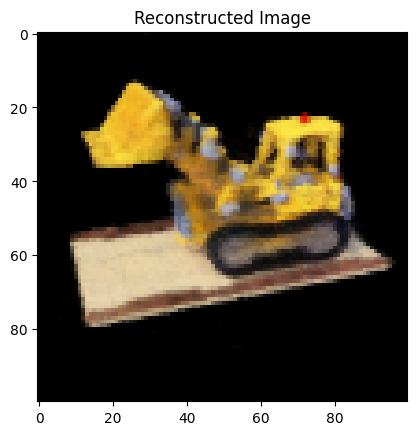

Volumetric = cpu


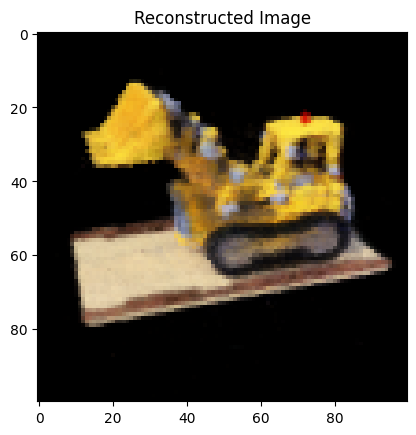

Volumetric = cpu


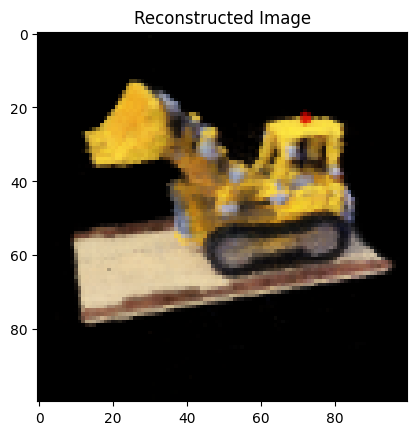

Volumetric = cpu


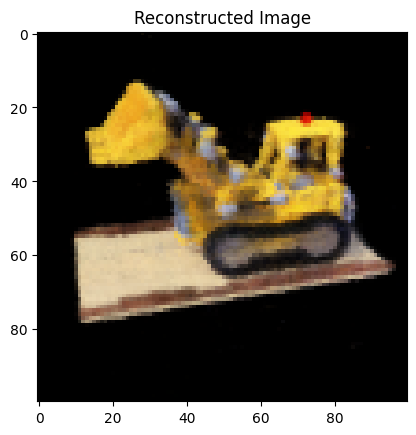

Volumetric = cpu


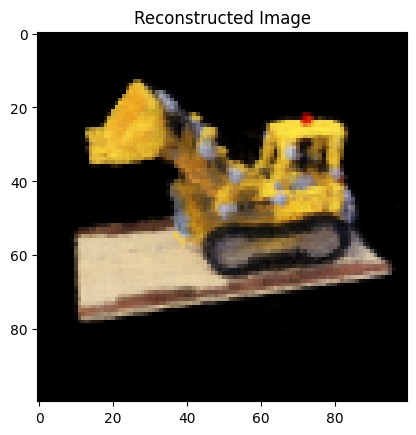

Volumetric = cpu


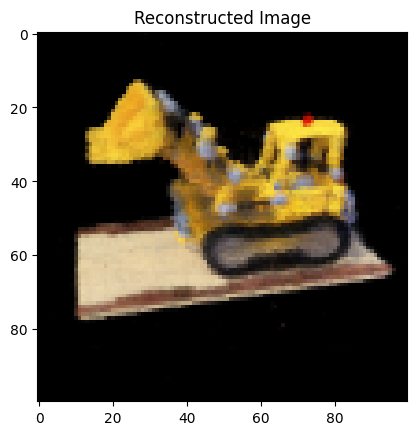

Volumetric = cpu


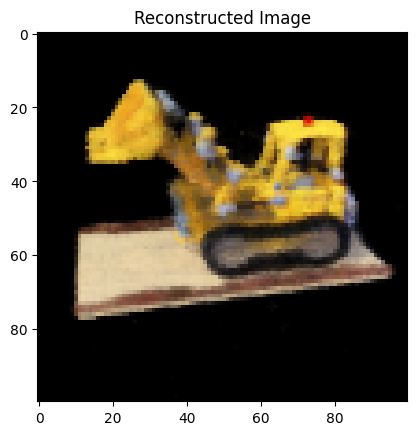

Volumetric = cpu


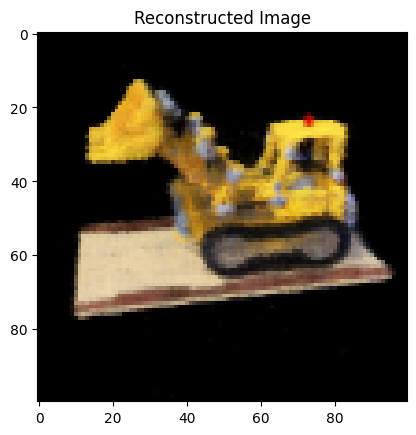

Volumetric = cpu


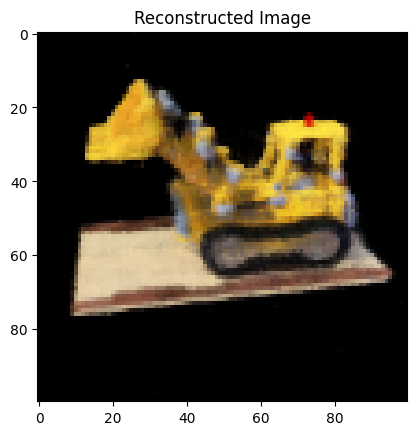

Volumetric = cpu


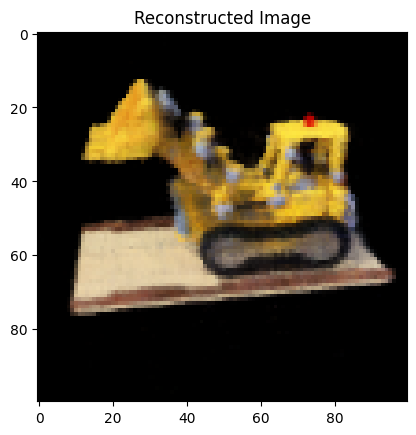

Volumetric = cpu


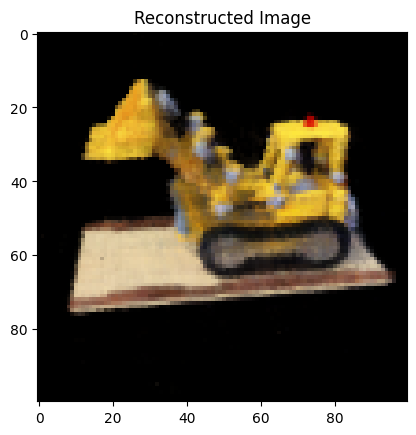

Volumetric = cpu


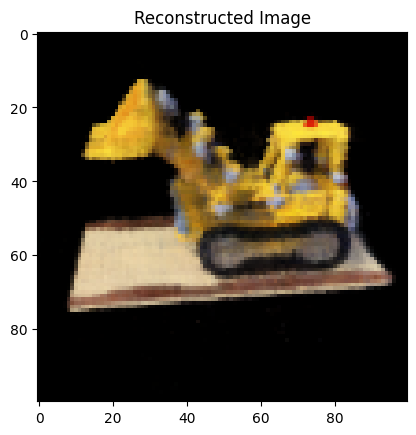

Volumetric = cpu


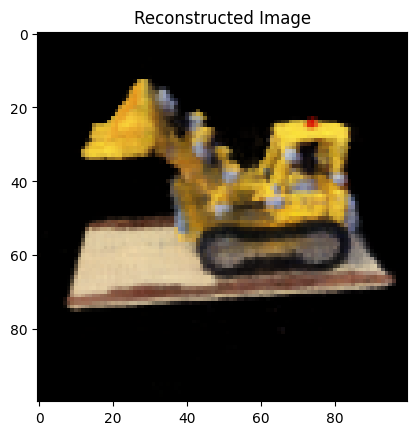

Volumetric = cpu


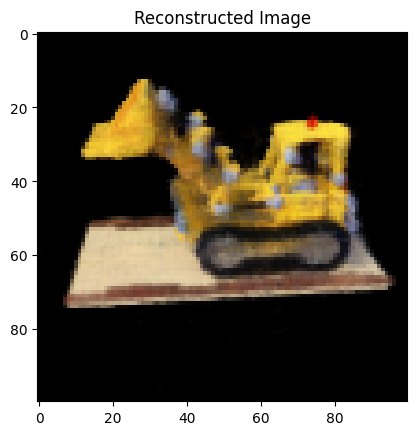

Volumetric = cpu


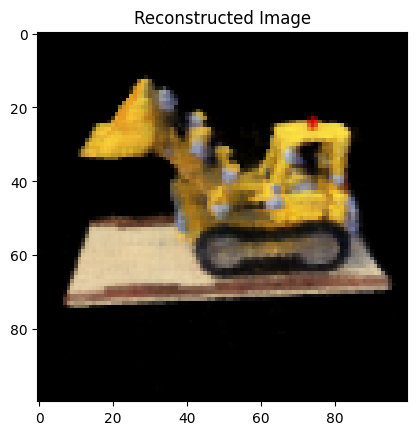

Volumetric = cpu


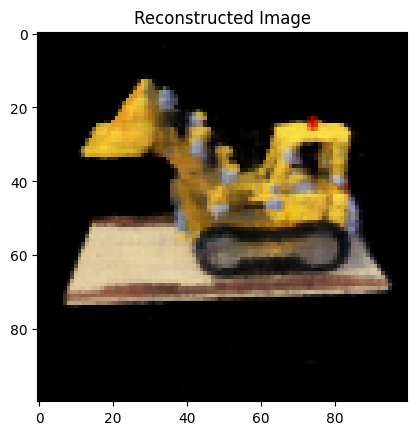

Volumetric = cpu


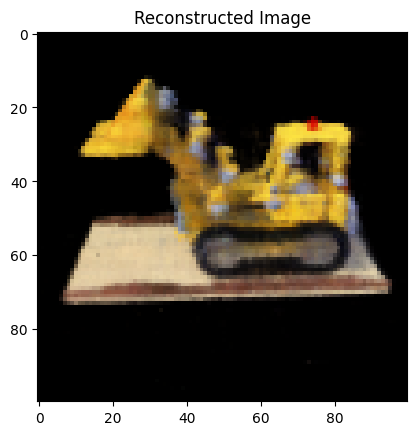

Volumetric = cpu


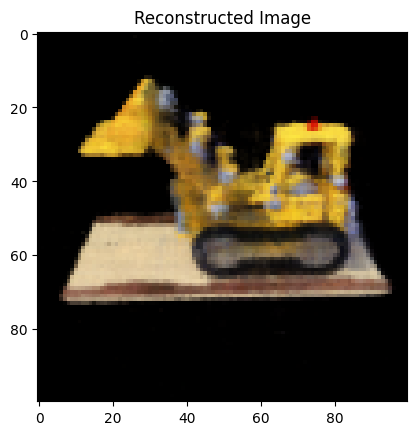

Volumetric = cpu


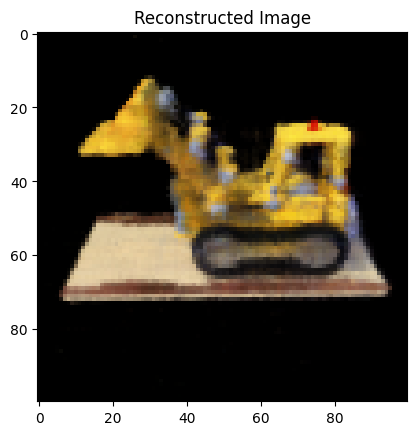

Volumetric = cpu


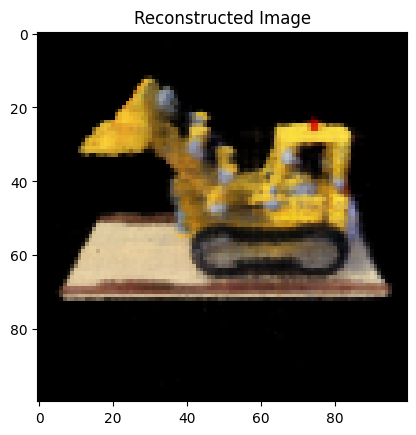

Volumetric = cpu


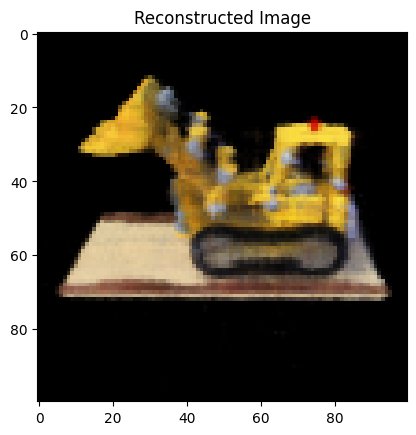

Volumetric = cpu


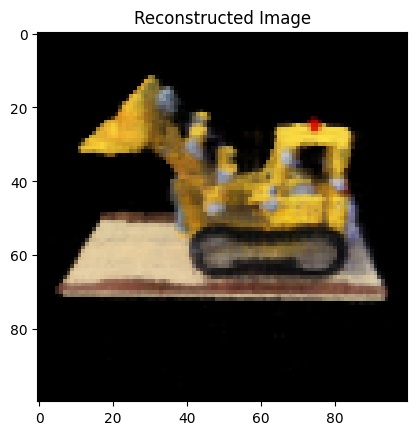

Volumetric = cpu


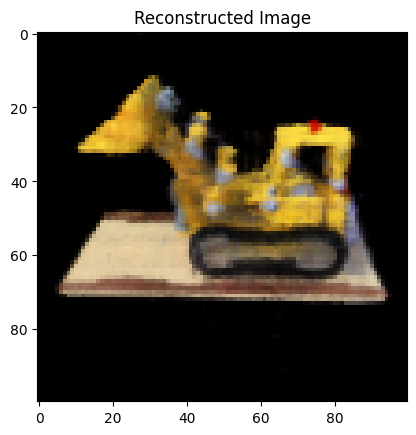

Volumetric = cpu


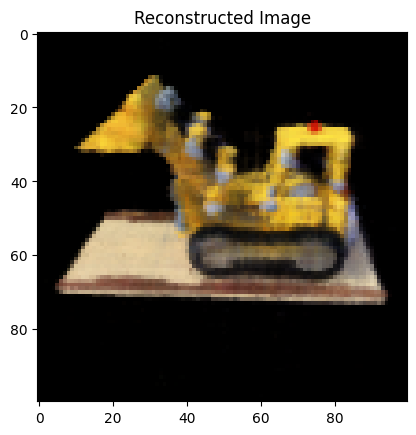

Volumetric = cpu


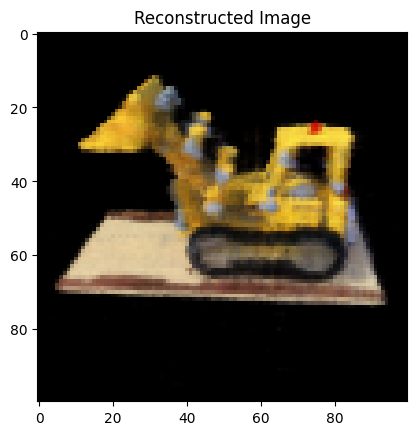

Volumetric = cpu


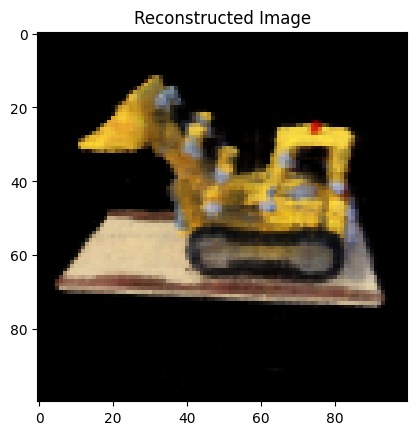

Volumetric = cpu


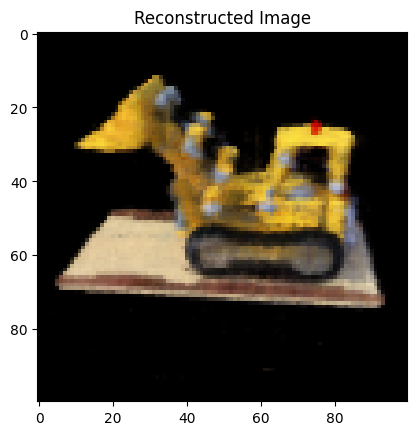

Volumetric = cpu


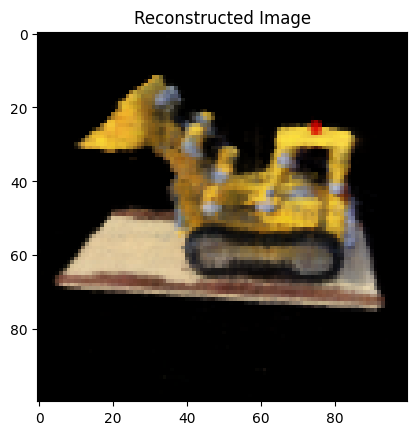

Volumetric = cpu


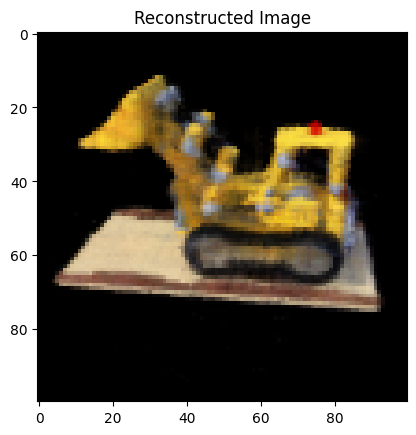

Volumetric = cpu


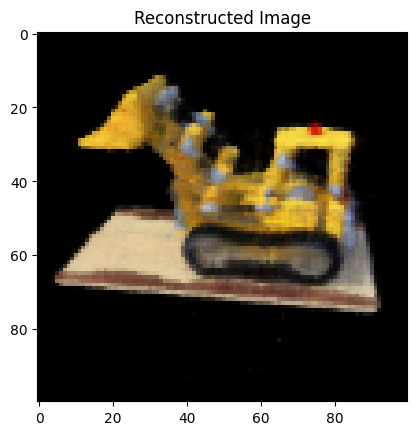

Volumetric = cpu


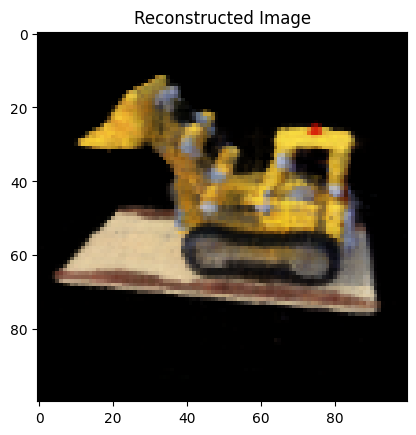

Volumetric = cpu


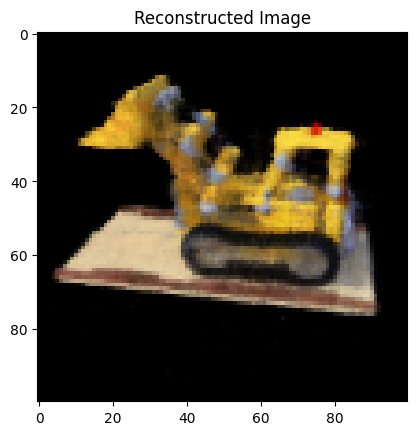

Volumetric = cpu


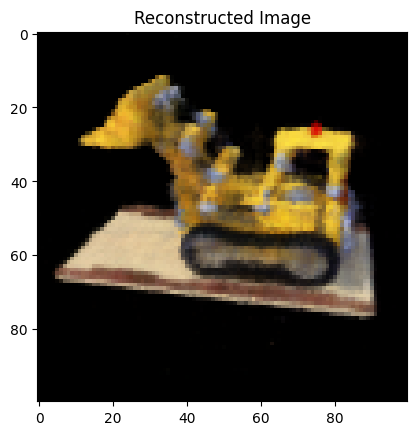

Volumetric = cpu


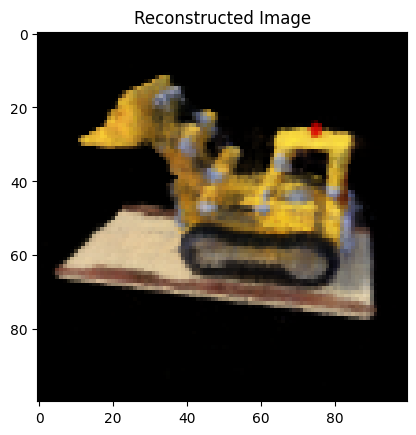

Volumetric = cpu


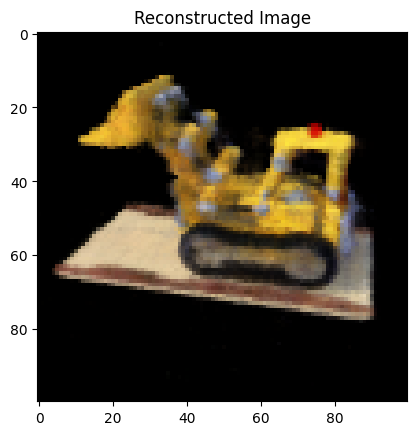

Volumetric = cpu


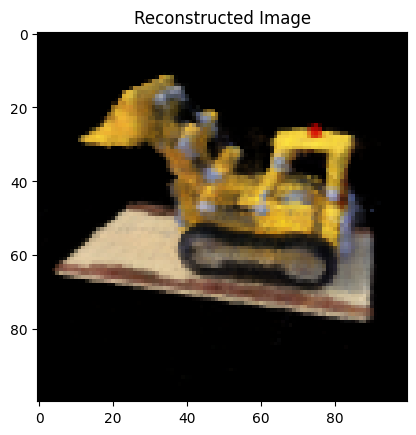

Volumetric = cpu


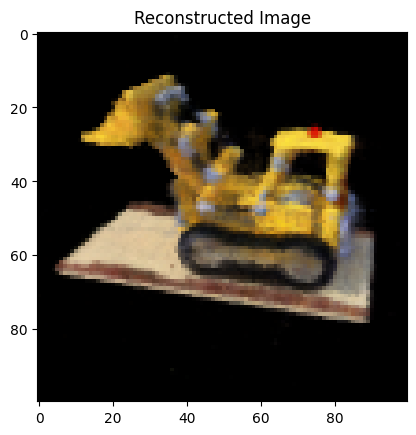

Volumetric = cpu


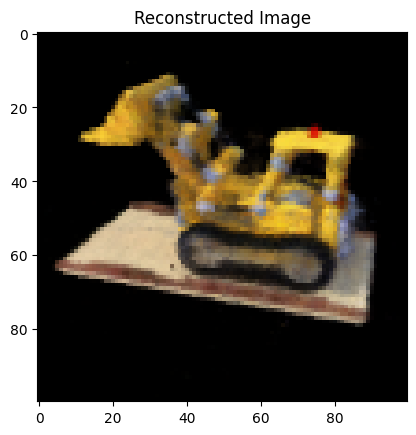

Volumetric = cpu


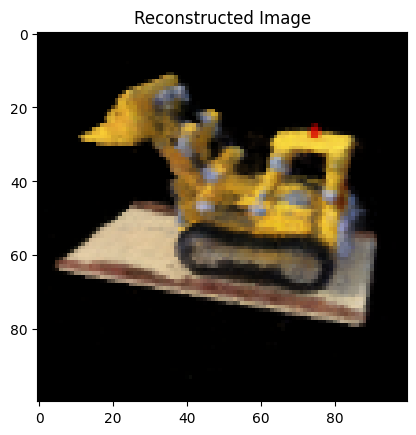

Volumetric = cpu


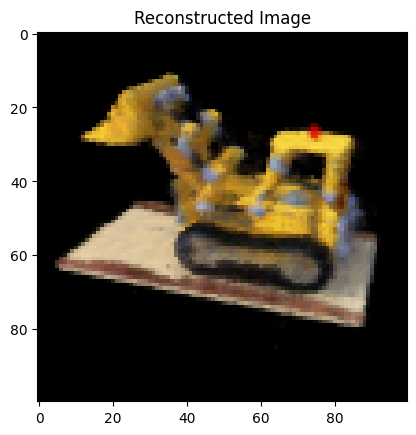

Volumetric = cpu


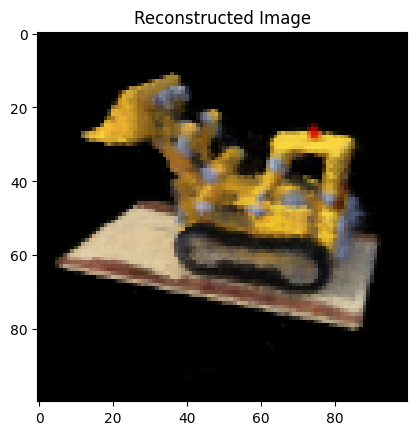

Volumetric = cpu


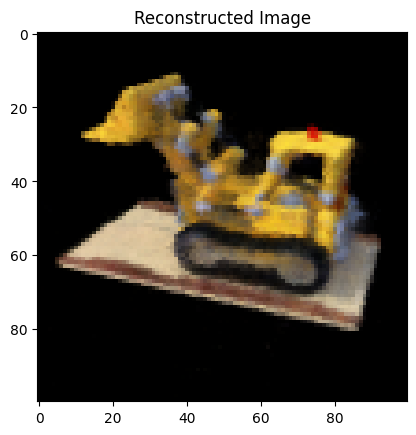

Volumetric = cpu


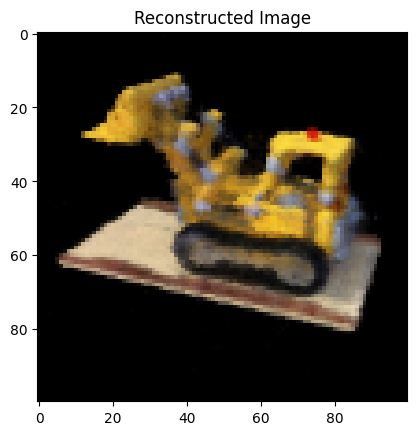

Volumetric = cpu


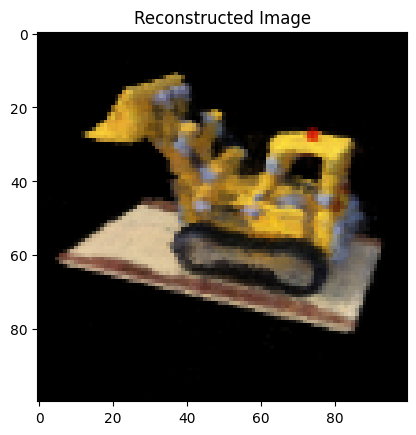

Volumetric = cpu


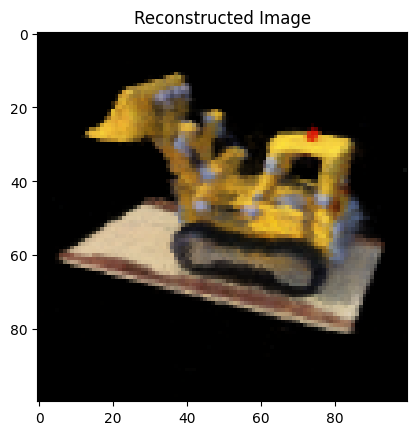

Volumetric = cpu


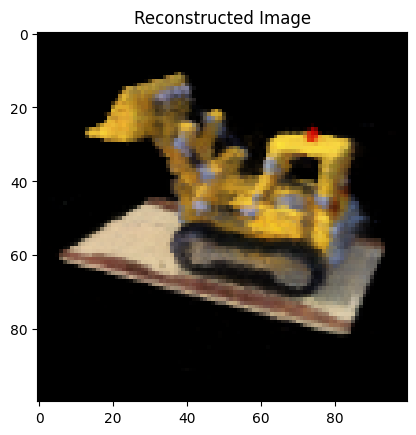

Volumetric = cpu


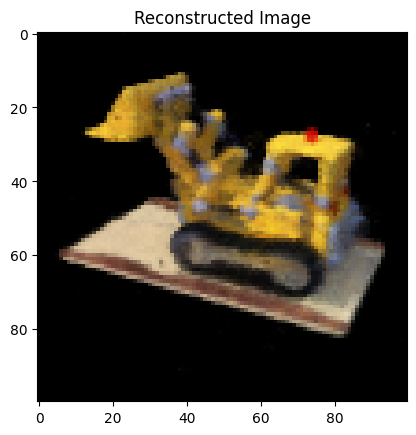

Volumetric = cpu


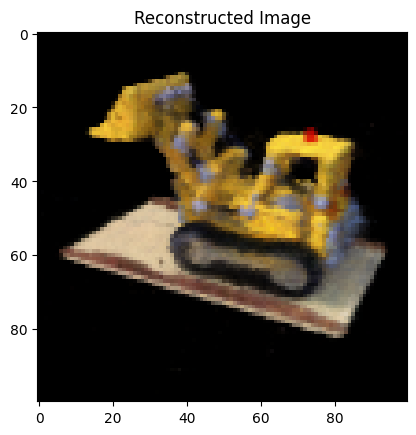

Volumetric = cpu


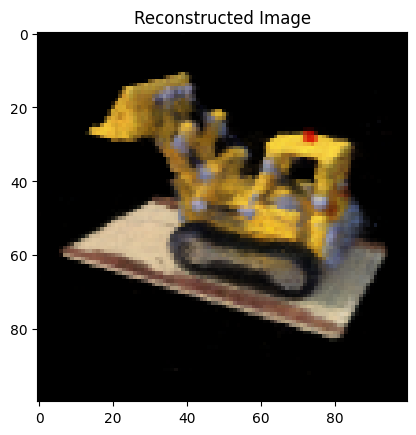

Volumetric = cpu


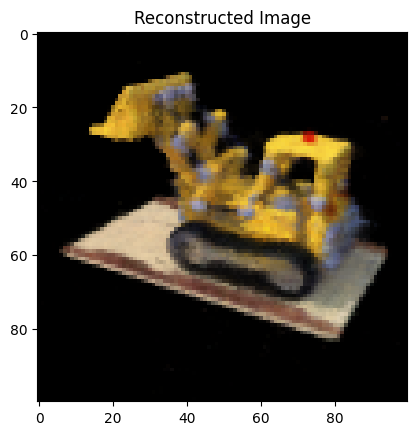

Volumetric = cpu


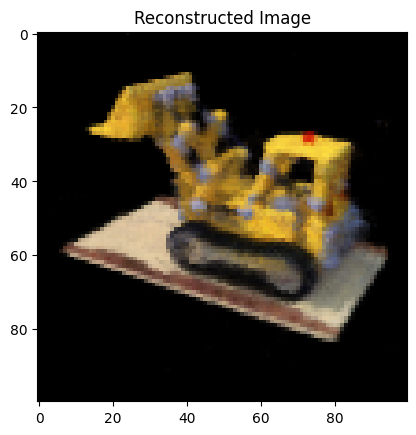

Volumetric = cpu


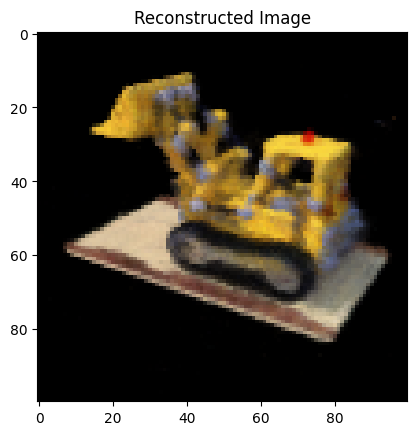

Volumetric = cpu


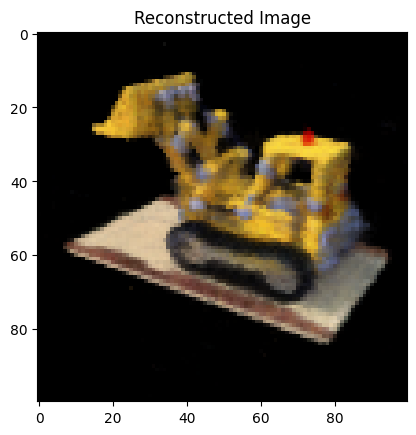

Volumetric = cpu


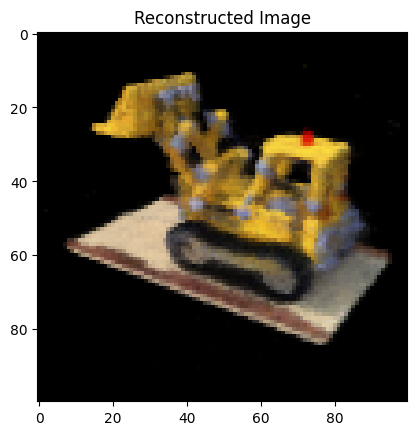

Volumetric = cpu


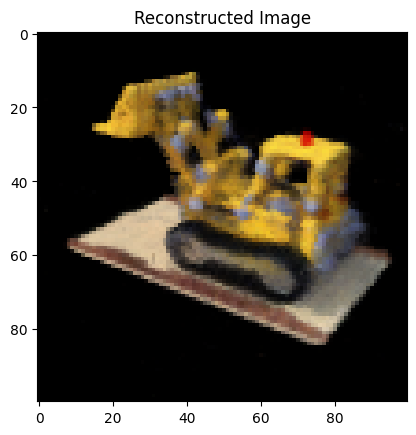

Volumetric = cpu


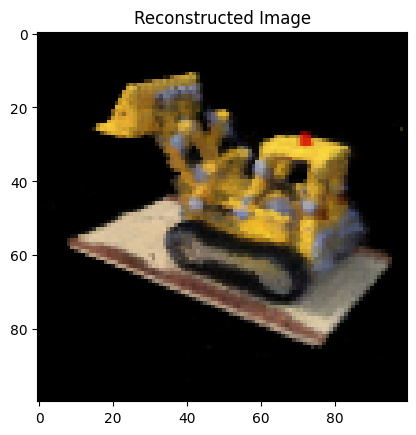

Volumetric = cpu


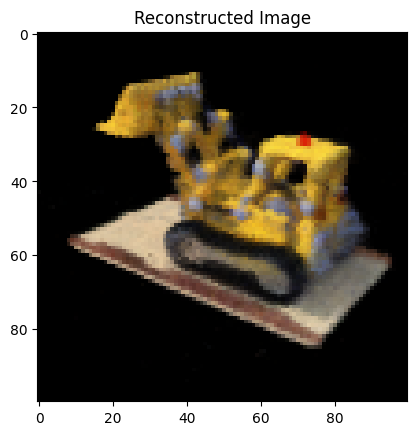

Volumetric = cpu


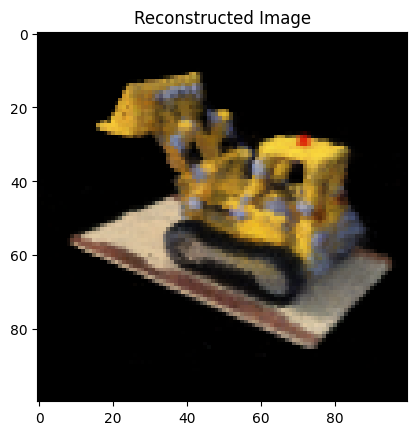

Volumetric = cpu


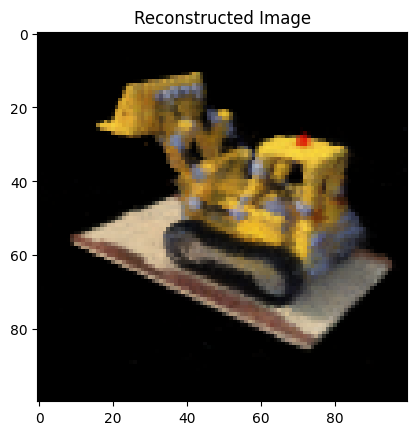

Volumetric = cpu


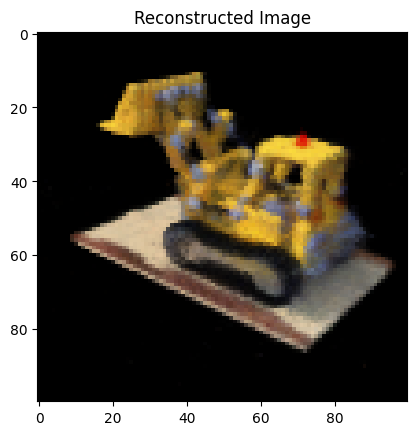

Volumetric = cpu


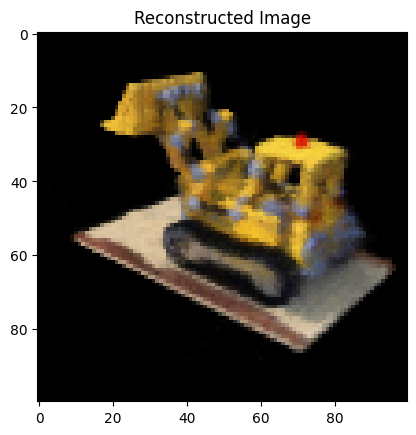

Volumetric = cpu


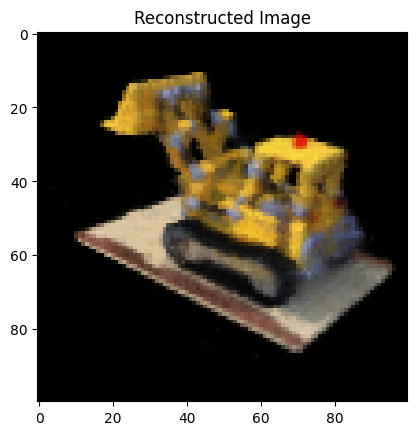

Volumetric = cpu


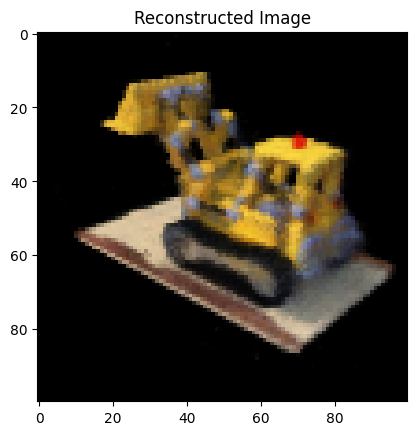

Volumetric = cpu


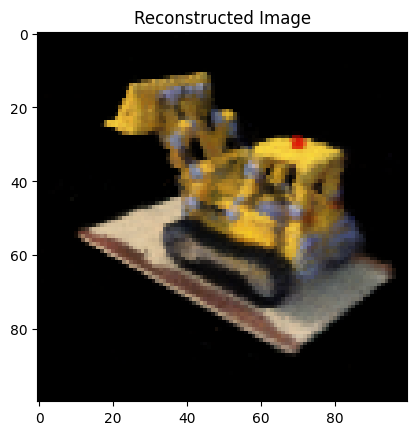

Volumetric = cpu


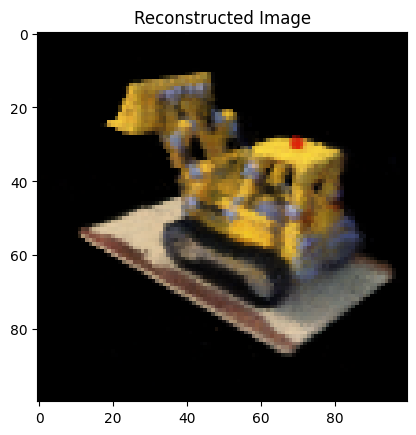

Volumetric = cpu


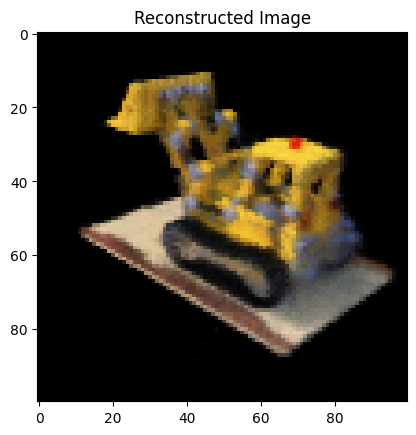

In [16]:
frames = []

for angle in range(360):
  torch.cuda.empty_cache()
  rot1 = R.from_euler('z', angle, degrees=True)
  rot1_tensor = torch.tensor(rot1.as_matrix(), dtype= torch.float32)
  rot2 = R.from_euler('z', -angle, degrees=True)
  rot2_tensor = torch.tensor(rot1.as_matrix(), dtype= torch.float32)
  trial_pose = poses[74].to(torch.float32).cpu()

  pose = torch.eye(4)

  pose[:3,:3] = (rot1_tensor @ trial_pose[:3,:3])
  pose[:3,3] = rot2_tensor @ trial_pose[:3,-1]
  gc.collect()
  rec_image = one_forward_pass(height, width, intrinsics, pose.to(device), near, far, samples, model, num_x_frequencies, num_d_frequencies)
  gc.collect()
  torch.cuda.empty_cache()
  plt.imshow(rec_image.detach().cpu().numpy())
  plt.title("Reconstructed Image")
  plt.show()
  frames.append((255*rec_image.detach().cpu().numpy()).astype(np.uint8))

import imageio
f = 'video.mp4'
imageio.mimwrite(f, frames, fps=30, quality=7)

In [25]:
from IPython.display import HTML
from base64 import b64encode
f = 'video.mp4'
imageio.mimwrite(f, frames, fps=60, quality=7)
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [24]:
imageio.mimwrite('/content/drive/MyDrive/NeRF/motion.gif', frames, fps=60, format='gif')